# TODO Needs Comments

In [1]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

import organoid_prediction_python as opp
from organoid_prediction_python._utils import heatmap_coloring_func
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from functools import partial

home_directory = r"C:\Users\savill\OneDrive\Documents\PhD Jesse\Embryonic_organoid_prediction\Processing dataset for Paper\TLS_2D_morphostate_investigation/"
table_location = home_directory + "tabular_data"

timecourse_data = pd.read_csv(f"{table_location}/All_Samples_Feature_Space_All_Features_48h,72h,96h_Normalised_across_Timepoints.csv")
timecourse_data

,hour,Run,Plate,ID,raw_BF_AreaShape_area,raw_BF_AreaShape_aspect_ratio,raw_BF_AreaShape_axis_major_length,raw_BF_AreaShape_axis_minor_length,raw_BF_AreaShape_eccentricity,raw_BF_AreaShape_feret_diameter_max,...,str_BF_AreaShape_moments_hu_1,str_BF_AreaShape_moments_hu_2,str_BF_AreaShape_moments_hu_3,str_BF_AreaShape_moments_hu_4,str_BF_AreaShape_moments_hu_5,str_BF_AreaShape_moments_hu_6,str_BF_AreaShape_orientation,str_BF_AreaShape_perimeter,str_CH_AreaShape_Bra_MajorAxis_Polarisation,str_CH_AreaShape_Bra_MinorAxis_Polarisation
0,48,RR,1,A1,-0.786269,-0.602748,-0.804054,-0.680943,-0.839800,-0.833971,...,-0.357708,0.487340,-0.094237,-0.043775,-0.058786,0.001758,-0.333690,-0.713208,NaN,NaN
1,48,RR,1,A2,-1.021382,-0.728751,-1.052827,-0.975465,-1.307770,-1.046449,...,-0.393168,-0.564204,-0.104432,-0.043775,-0.058574,-0.000295,-0.132991,-1.148552,NaN,NaN
2,48,RR,1,A3,-0.651346,-0.357900,-0.612872,-0.592495,-0.223631,-0.624938,...,-0.290376,0.319163,-0.095871,-0.043818,-0.059593,0.000651,0.201232,-0.410262,NaN,NaN
3,48,RR,1,A4,-0.981974,-0.472190,-0.950074,-1.025959,-0.480778,-0.993783,...,-0.352930,-0.602993,-0.105103,-0.043775,-0.058580,-0.000286,-1.135101,-1.097838,NaN,NaN
4,48,RR,1,A5,-0.819332,-0.380374,-0.774622,-0.826112,-0.271012,-0.824190,...,-0.351888,-0.566414,-0.104144,-0.043776,-0.058623,-0.000303,0.776286,-0.691755,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2296,96,TR,2,H8,1.851740,0.155152,1.448585,2.004995,0.598064,1.613871,...,0.458998,2.582357,0.188006,-0.035680,-0.034970,0.419129,-0.277153,1.913029,-0.584849,1.261430
2297,96,TR,2,H9,2.468244,0.857179,2.146445,2.212767,1.302495,2.416990,...,0.826635,1.986519,0.212227,-0.050492,-0.114470,0.444883,0.218896,2.452851,0.748758,1.188526
2298,96,TR,2,H10,2.632222,0.408947,2.056502,2.588608,0.890400,2.151934,...,0.114522,2.268364,0.027144,-0.046201,-0.072206,0.119311,0.112216,2.430505,-0.664662,-0.703838
2299,96,TR,2,H11,2.213093,2.366057,2.522676,1.270813,2.167236,2.181831,...,3.287134,1.246410,0.545660,-0.082443,-0.437687,0.596319,-0.172317,2.288588,-0.503000,2.585532


In [2]:
translation_areashape = pd.read_csv("translation_dataframe_areashape.csv")
areashape_name_mapping = {key:new_key for key,new_key in zip(translation_areashape["original_names"],translation_areashape["plot_names"])}

In [3]:
nan_removed_areas = timecourse_data[[key for key in timecourse_data.keys() if "AreaShape" in key and "BF" in key and "Location" not in key ]+["hour","Run","Plate","ID"]].dropna(axis=0).rename(columns = areashape_name_mapping)

In [4]:
stacked_raw_data = pd.read_csv(table_location + "/" + "raw_data_stacked_timepoints.csv").drop("Unnamed: 0",axis=1)
stacked_raw_data["Hour"]

0       48
1       48
2       48
3       48
4       48
        ..
2296    96
2297    96
2298    96
2299    96
2300    96
Name: Hour, Length: 2301, dtype: int64

meta NOT subset; don't know how to subset; dropped


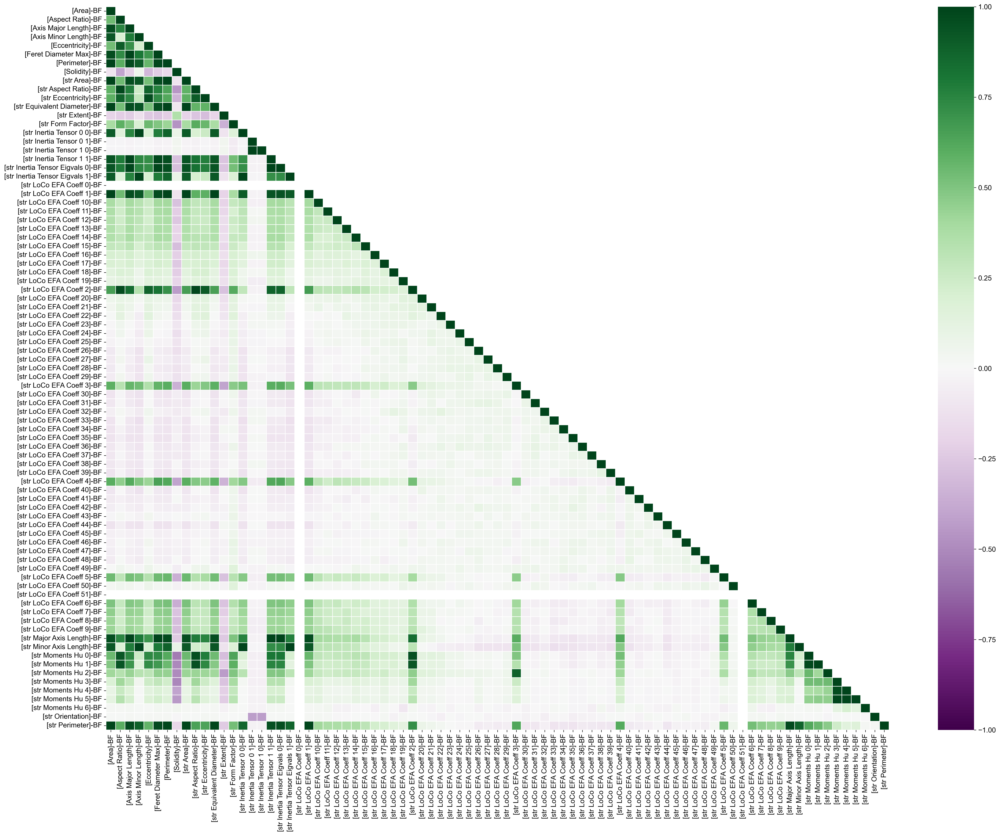

In [5]:
correlation_frame_areashape = stacked_raw_data.rename(columns = areashape_name_mapping)[[key for key in nan_removed_areas.drop(["hour","Run","Plate","ID"],axis=1).keys()]].corr()

out_fig_1 = home_directory + "/" + r"Plots\Fig 1 Morphospace Dynamics"
out_fig_1_supp = home_directory + "/" + r"Plots\Fig 1 Supplemental"

fig,ax = plt.subplots(1,1,figsize = (26,20))

mask = np.ones(correlation_frame_areashape.shape, dtype= bool)
mask = np.triu(mask, k = 1)

sns.heatmap(correlation_frame_areashape, cmap = "PRGn",vmin=-1, vmax=1, xticklabels='auto', yticklabels='auto', mask=mask, ax=ax,linewidths=0.5)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1_supp}/Correlation Plot Shape.pdf", format="pdf", bbox_inches="tight")
plt.show()

In [6]:
def agglomerate_corr_feats(correlating_features_sets):
    new_sets = []
    for i in correlating_features_sets:
        unique_set = True
        
        for j in correlating_features_sets:
            intersect = i&j
            if len(intersect) > 0 and i != j:
                unique_set = False
                union = (i|j)
                if union not in new_sets:
                    new_sets.append(i|j)
                
        if unique_set:
            new_sets.append(i)
            
    if new_sets == correlating_features_sets:
        return new_sets
    else:
        return agglomerate_corr_feats(new_sets)

def correlating_features(df_regprops, corr_thresh = 0.95):
    # Actually finding the correlating features with pandas
    correlation_df = df_regprops.corr().abs()
    correlation_matrix = correlation_df.to_numpy()

    # using numpy to get the correlating features out of the matrix
    mask = np.ones(correlation_matrix.shape, dtype= bool)
    mask = np.triu(mask, k = 1)
    masked_array = correlation_matrix * mask
    highly_corr = np.where(masked_array >= corr_thresh)

    # Using sets as a datatype for easier agglomeration of the features
    # afterwards conversion back to list
    correlating_feats = [{i,j} for i,j in zip(highly_corr[0],highly_corr[1])]    
    correlating_feats_agglo = agglomerate_corr_feats(correlating_feats)
    corr_ind_list = [sorted(list(i)) for i in correlating_feats_agglo]

    # getting the keys and then turning the indices into keys
    keys = df_regprops.keys()
    correlating_keys = [keys[ind].tolist() for ind in corr_ind_list]
    return correlating_keys

df = nan_removed_areas.drop(["hour","Run","Plate","ID"],axis=1)
    
correlating_features(df)

[['[Area]-BF',
  '[Axis Major Length]-BF',
  '[Feret Diameter Max]-BF',
  '[Perimeter]-BF',
  '[str Area]-BF',
  '[str Equivalent Diameter]-BF',
  '[str Inertia Tensor 1 1]-BF',
  '[str Inertia Tensor Eigvals 0]-BF',
  '[str LoCo EFA Coeff 1]-BF',
  '[str Major Axis Length]-BF',
  '[str Perimeter]-BF'],
 ['[Aspect Ratio]-BF',
  '[str Aspect Ratio]-BF',
  '[str LoCo EFA Coeff 2]-BF',
  '[str Moments Hu 0]-BF',
  '[str Moments Hu 1]-BF'],
 ['[Axis Minor Length]-BF',
  '[str Inertia Tensor 0 0]-BF',
  '[str Inertia Tensor Eigvals 1]-BF',
  '[str Minor Axis Length]-BF'],
 ['[Eccentricity]-BF', '[str Eccentricity]-BF'],
 ['[str Inertia Tensor 0 1]-BF', '[str Inertia Tensor 1 0]-BF'],
 ['[str Moments Hu 3]-BF', '[str Moments Hu 4]-BF', '[str Moments Hu 5]-BF']]

In [7]:
# to_drop_95_thresh = [
#     'raw_BF_AreaShape_axis_major_length',
#     'raw_BF_AreaShape_feret_diameter_max',
#     'raw_BF_AreaShape_perimeter',
#     'str_BF_AreaShape_area',
#     'str_BF_AreaShape_equivalent_diameter',
#     'str_BF_AreaShape_inertia_tensor_1_1',
#     'str_BF_AreaShape_inertia_tensor_eigvals_0',
#     'str_BF_AreaShape_locoefa_coeff_1',
#     'str_BF_AreaShape_perimeter',
#     'raw_BF_AreaShape_aspect_ratio',
#     'raw_BF_AreaShape_eccentricity',
#     'str_BF_AreaShape_eccentricity',
#     'str_BF_AreaShape_locoefa_coeff_2',
#     'str_BF_AreaShape_moments_hu_0',
#     'str_BF_AreaShape_moments_hu_1',
#     'raw_BF_AreaShape_axis_minor_length',
#     'str_BF_AreaShape_inertia_tensor_0_0',
#     'str_BF_AreaShape_inertia_tensor_eigvals_1',
#     'str_BF_AreaShape_inertia_tensor_1_0',
#     'str_BF_AreaShape_moments_hu_4',
#     'str_BF_AreaShape_moments_hu_5',
#     'str_BF_AreaShape_locoefa_coeff_0',
#     'str_BF_AreaShape_locoefa_coeff_51',
#     'str_BF_AreaShape_orientation',
# ]

kept_df = nan_removed_areas #.drop(to_drop_95_thresh,axis=1)
#kept_df.keys().to_numpy()

In [8]:
pca_df, transformer = opp.sparse_PCA_with_indices_and_ground_truth(
    kept_df.drop(["hour","Run","Plate","ID"],axis=1),
    ground_truth_df=kept_df,
    gt_keys=["hour","Run","Plate","ID"],
    n_components=4,
    remove_unclassified=False,
    return_transformer=True,
    randomstate=42,
)

pca_df

,PC_1,PC_2,PC_3,PC_4,hour,Run,Plate,ID
0,-2.341728,-1.424776,0.221928,-0.467789,48,RR,1,A1
1,-3.140041,-2.437729,0.039362,-0.114444,48,RR,1,A2
2,-2.100073,-0.366373,0.305847,0.392185,48,RR,1,A3
3,-3.305903,-1.577311,-0.439769,-1.370665,48,RR,1,A4
4,-2.756103,-1.033511,-0.196523,1.015061,48,RR,1,A5
...,...,...,...,...,...,...,...,...
2296,6.381167,2.642721,0.967231,-2.917695,96,TR,2,H8
2297,7.353471,4.600900,1.086293,2.706704,96,TR,2,H9
2298,8.350161,2.757318,1.392761,0.868323,96,TR,2,H10
2299,4.524417,9.064039,0.328603,-4.073782,96,TR,2,H11


In [9]:
print(pca_df.groupby("hour").count())

      PC_1  PC_2  PC_3  PC_4  Run  Plate   ID
hour                                         
48     766   766   766   766  766    766  766
72     662   662   662   662  662    662  662
96     546   546   546   546  546    546  546


meta NOT subset; don't know how to subset; dropped


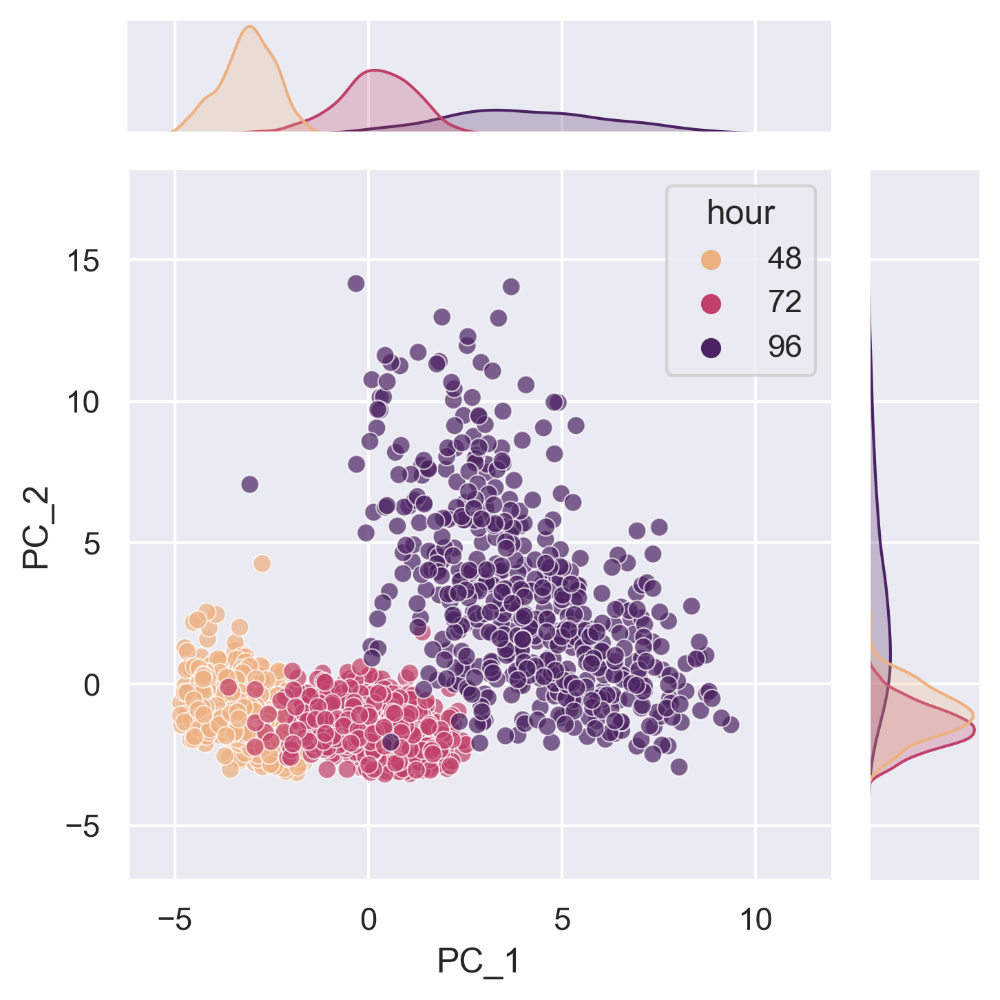

In [10]:
#fig, ax = plt.subplots(1,2,figsize=(17,5))
sns.set()

def filter_outliers_quantile(df,columns,quantile = 0.005):
    q_low = df[columns].quantile(quantile)
    q_hi  = df[columns].quantile(1-quantile)
    selection = (df[columns] < q_hi) & (df[columns] > q_low)

    df_filtered = df[np.all(selection.to_numpy(),axis=1)]
    return df_filtered

#sns.scatterplot(filter_outliers_quantile(pca_df,columns=["PC_1","PC_2"]),x="PC_1",y="PC_2",hue="hour",ax=ax[0],palette="flare", **{"alpha":0.6})
#sns.scatterplot(filter_outliers_quantile(pca_df,columns=["PC_3","PC_4"]),x="PC_3",y="PC_4",hue="hour",ax=ax[1],palette="flare", **{"alpha":0.5})
#sns.kdeplot(filter_outliers_quantile(pca_df,columns=["PC_1","PC_2"]),x="PC_1",y="PC_2",hue="hour",ax=ax[0],levels=10)
#sns.kdeplot(filter_outliers_quantile(pca_df,columns=["PC_3","PC_4"]),x="PC_3",y="PC_4",hue="hour",ax=ax[1], **{"alpha":0.5})

sns.jointplot(filter_outliers_quantile(pca_df,columns=["PC_1","PC_2"]),x="PC_1",y="PC_2",hue="hour",palette="flare", **{"alpha":0.7,"s":40},height=5)

plt.tight_layout()
plt.savefig(f"{out_fig_1}/PCA Plot PC1&2 Shape.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


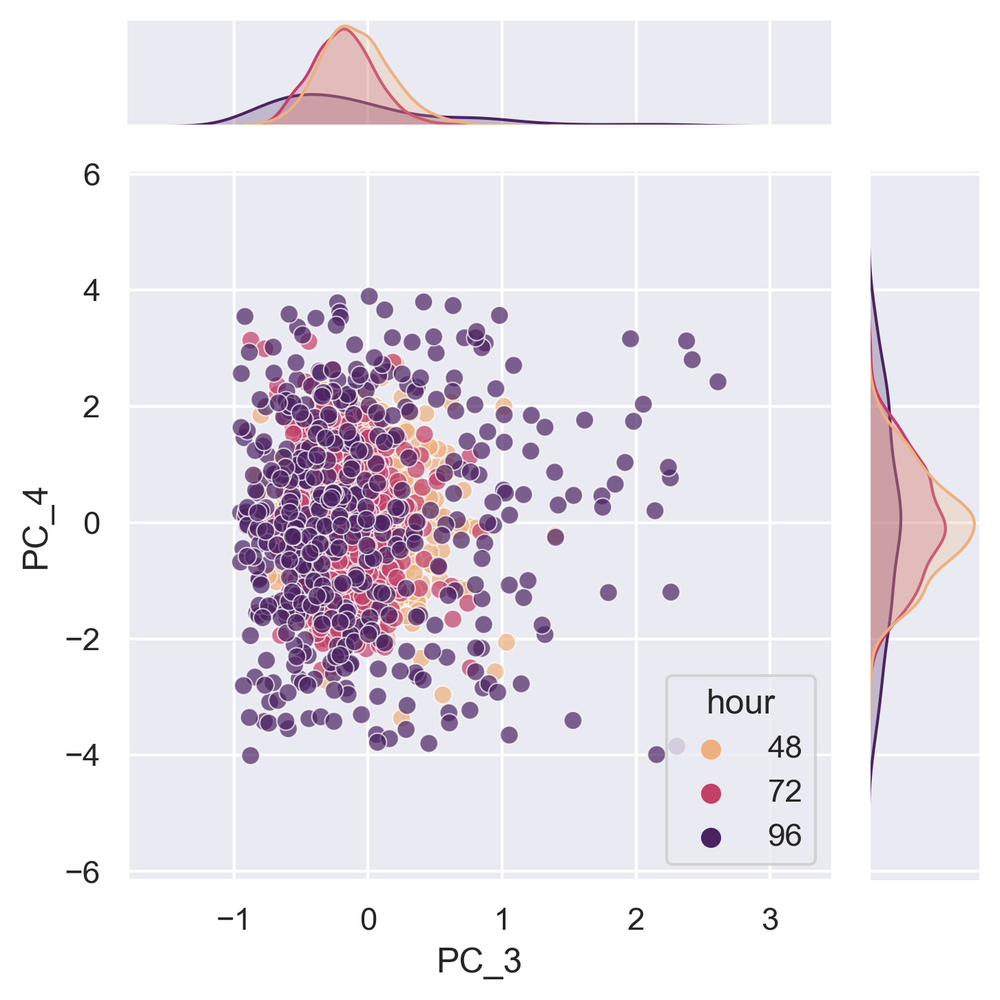

In [11]:
sns.jointplot(filter_outliers_quantile(pca_df,columns=["PC_3","PC_4"],quantile=0.01),x="PC_3",y="PC_4",hue="hour",palette="flare", **{"alpha":0.7,"s":40},height=5)

plt.tight_layout()
plt.savefig(f"{out_fig_1_supp}/PCA Plot PC3&4 Shape.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


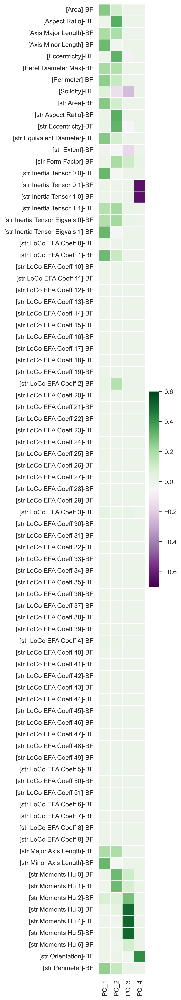

In [12]:
transformerloadings_area_shape = pd.DataFrame(
        transformer.components_.T, 
        columns=[f'PC_{i+1}' for i in range(4)], 
        index=kept_df.drop(["hour","Run","Plate","ID"],axis=1).columns
)


fig,ax = plt.subplots(1,1,figsize=(2,30))
sns.heatmap(transformerloadings_area_shape, cmap = "PRGn",vmin=-0.7, vmax=0.6, xticklabels='auto', yticklabels='auto', ax=ax,linewidths=0.5,square=True)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1_supp}/PCA Loadings PC1-4 All Shape.pdf", format="pdf", bbox_inches="tight")
plt.show()

In [13]:
quantiles_upper = np.quantile(transformerloadings_area_shape,0.95,axis=0)
quantiles_lower = np.quantile(transformerloadings_area_shape,0.05,axis=0)
main_contributers = [
    key for key in transformerloadings_area_shape.index if (
        any(
            [
                transformerloadings_area_shape.loc[key][i]>quantiles_upper[i] 
                or transformerloadings_area_shape.loc[key][i]<quantiles_lower[i] 
                for i in range(len(transformerloadings_area_shape.columns))
            ]
        )
    )
]

main_contributers

['[Aspect Ratio]-BF',
 '[Axis Minor Length]-BF',
 '[Eccentricity]-BF',
 '[Solidity]-BF',
 '[str Aspect Ratio]-BF',
 '[str Eccentricity]-BF',
 '[str Extent]-BF',
 '[str Form Factor]-BF',
 '[str Inertia Tensor 0 0]-BF',
 '[str Inertia Tensor 0 1]-BF',
 '[str Inertia Tensor 1 0]-BF',
 '[str Inertia Tensor Eigvals 1]-BF',
 '[str LoCo EFA Coeff 1]-BF',
 '[str Minor Axis Length]-BF',
 '[str Moments Hu 1]-BF',
 '[str Moments Hu 2]-BF',
 '[str Moments Hu 3]-BF',
 '[str Moments Hu 4]-BF',
 '[str Moments Hu 5]-BF',
 '[str Orientation]-BF']

meta NOT subset; don't know how to subset; dropped


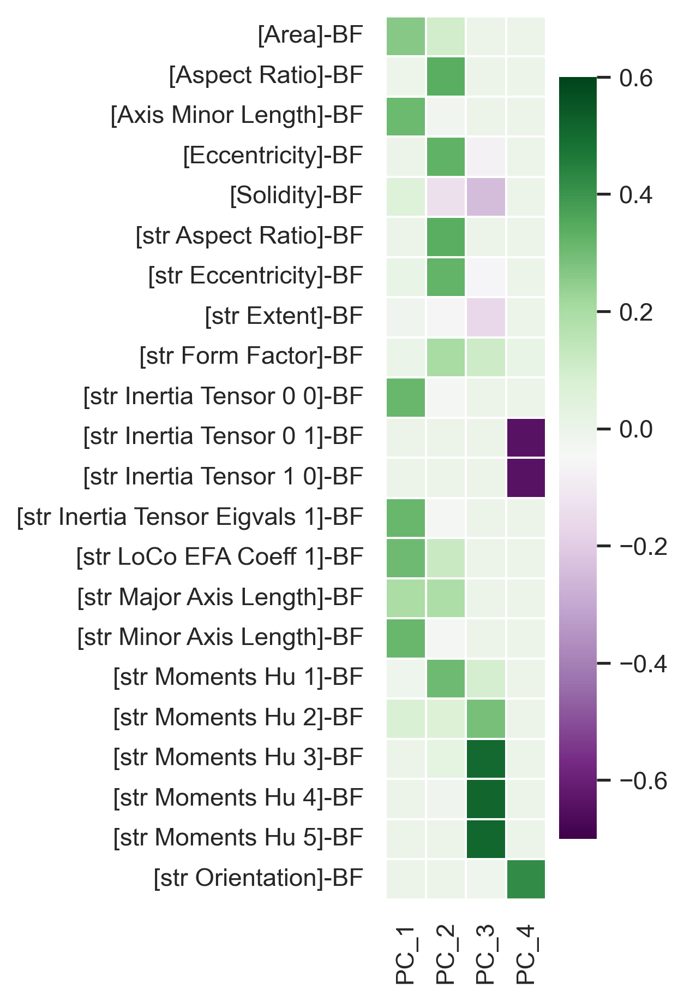

In [16]:
fig,ax = plt.subplots(1,1,figsize=(2,7))
sns.heatmap(transformerloadings_area_shape.loc[sorted(["[Area]-BF",'[str Major Axis Length]-BF']+main_contributers)], cmap = "PRGn",vmin=-0.7, vmax=0.6, xticklabels='auto', yticklabels='auto', ax=ax,linewidths=0.5,square=True)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1_supp}/PCA Loadings PC1-4 0.5 quant Shape.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


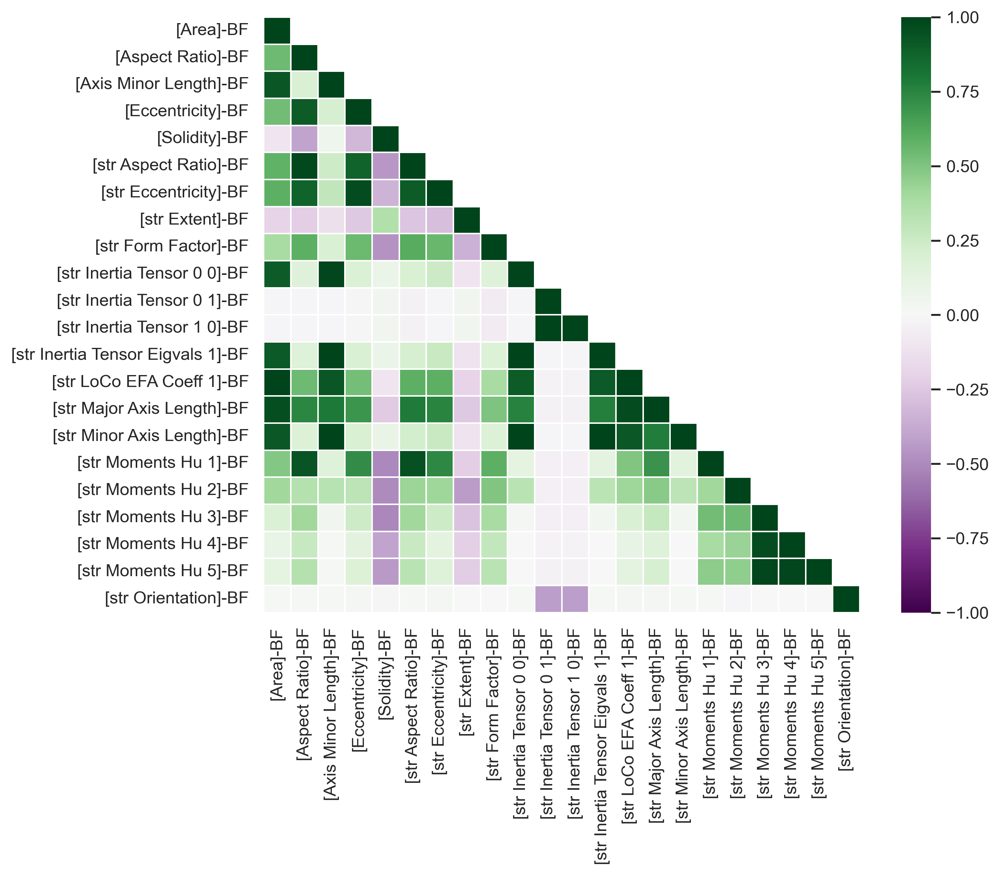

In [19]:
correlation_frame_shape_5quant = stacked_raw_data.drop(
    ["Hour","Run","Plate","ID"],axis=1
).rename(
    columns= areashape_name_mapping
)[sorted(["[Area]-BF",'[str Major Axis Length]-BF']+main_contributers)].corr()

fig,ax = plt.subplots(1,1,figsize = (10,8))

mask_shape_5quant = np.ones(correlation_frame_shape_5quant.shape, dtype= bool)
mask_shape_5quant = np.triu(mask_shape_5quant, k = 1)

sns.heatmap(correlation_frame_shape_5quant, cmap = "PRGn",vmin=-1, vmax=1, xticklabels='auto', yticklabels='auto', mask=mask_shape_5quant, ax=ax,linewidths=0.5,square=True)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1_supp}/Correlation Plot Shape 0.5 quantile feats .pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


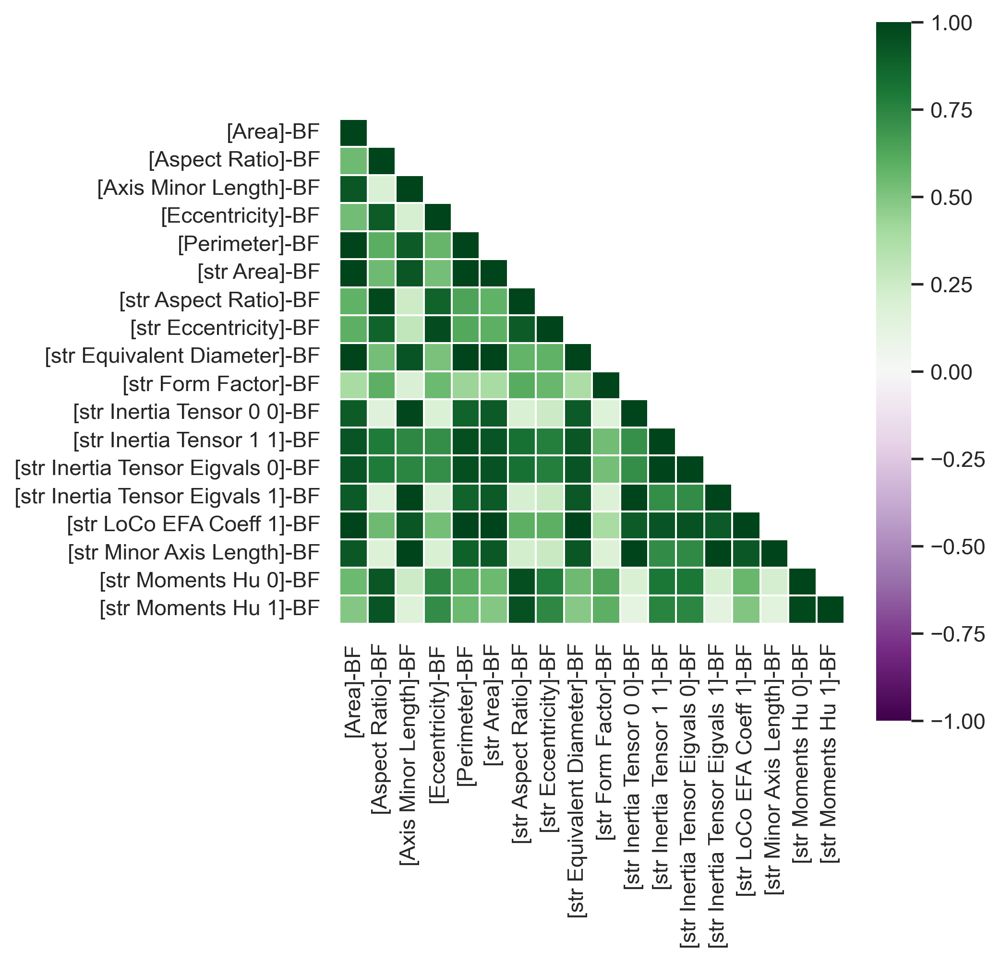

In [19]:
PC_12_loadings = transformerloadings_area_shape[["PC_1","PC_2"]]
quantiles = np.quantile(PC_12_loadings,0.9,axis=0)

main_pc_12_contributers = [key for key in PC_12_loadings.index if (PC_12_loadings.loc[key][0]>=quantiles[0] or PC_12_loadings.loc[key][1]>=quantiles[1])]

fig,ax = plt.subplots(1,1,figsize = (7,7))

corr_pc_12_contributers = stacked_raw_data.rename(columns = areashape_name_mapping)[main_pc_12_contributers].corr()
mask = np.ones(corr_pc_12_contributers.shape, dtype= bool)
mask = np.triu(mask, k = 1)

sns.heatmap(corr_pc_12_contributers, cmap = "PRGn",vmin=-1, vmax=1, xticklabels='auto', yticklabels='auto', mask=mask, ax=ax,linewidths=0.5,square=True)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1_supp}/Correlation Plot PC12 Contributers.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


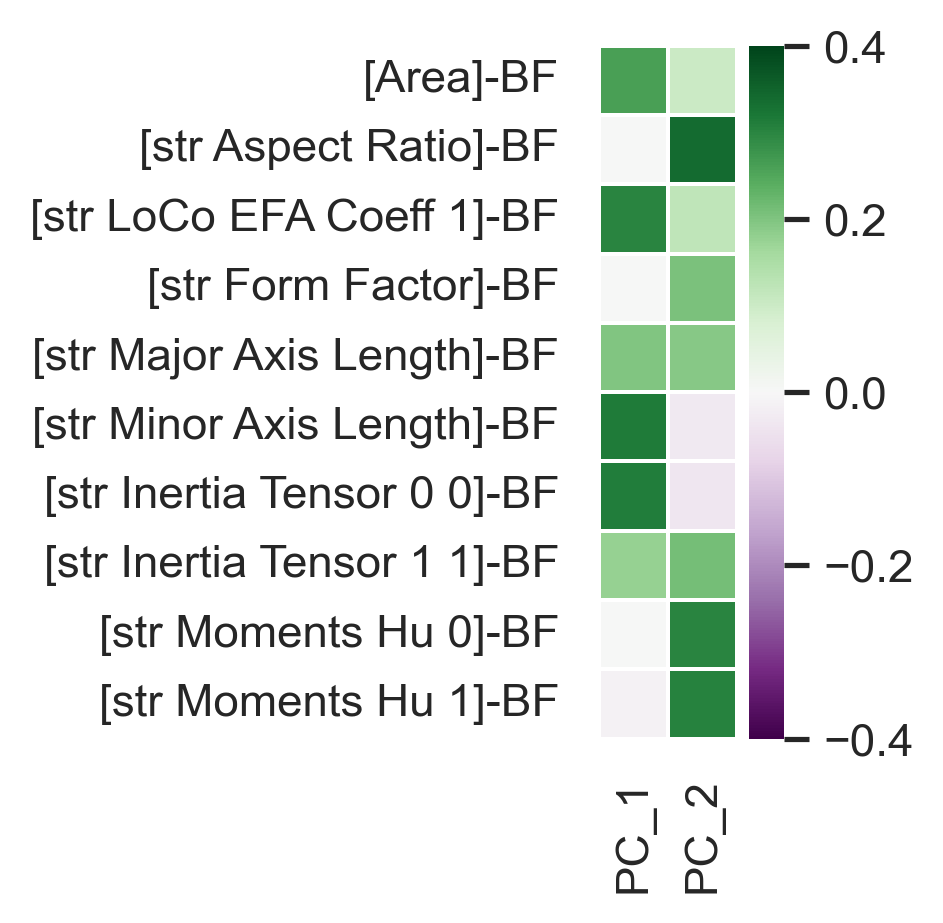

In [41]:
interested_feats = [
    '[Area]-BF',
    '[str Aspect Ratio]-BF', 
    '[str LoCo EFA Coeff 1]-BF',
    '[str Form Factor]-BF',
    '[str Major Axis Length]-BF',
    '[str Minor Axis Length]-BF',
    '[str Inertia Tensor 0 0]-BF',
    '[str Inertia Tensor 1 1]-BF',
    '[str Moments Hu 0]-BF',
    '[str Moments Hu 1]-BF'
]

fig,ax = plt.subplots(1,1,figsize=(1,3))

correlating_feats = transformerloadings_area_shape[["PC_1","PC_2"]].loc[interested_feats]

sns.heatmap(correlating_feats, cmap = "PRGn",vmin=-0.4, vmax=0.4, xticklabels='auto', yticklabels='auto', ax=ax,linewidths=0.5,square=True)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1}/PCA Loadings PC1&2 Shape.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


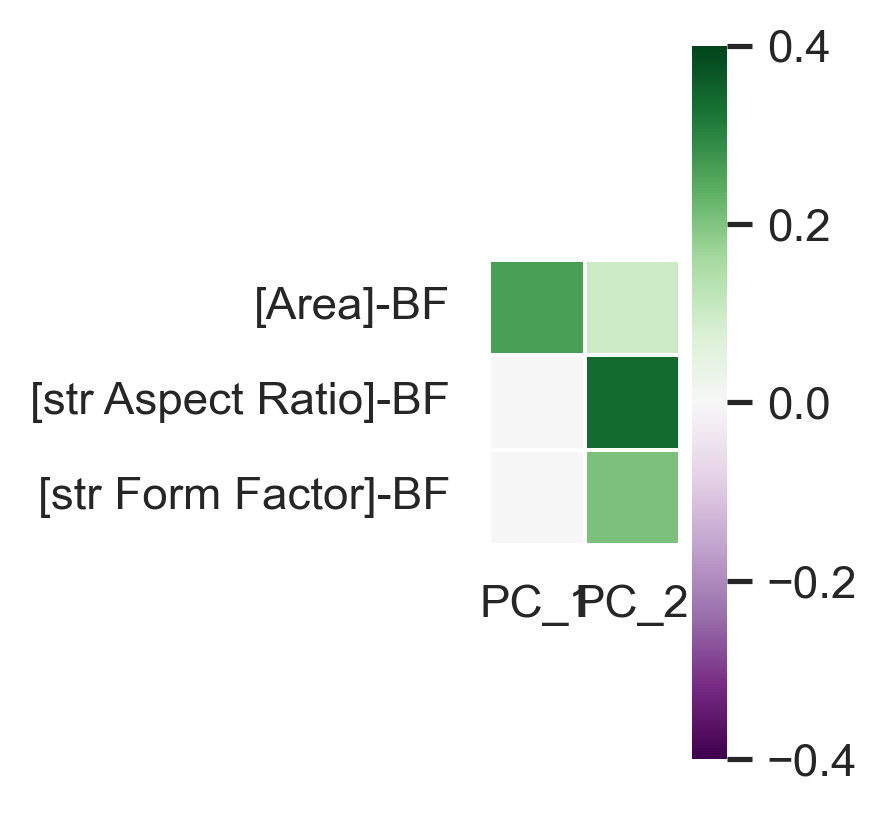

In [42]:
fig_1_feats = [
    '[Area]-BF',
    '[str Aspect Ratio]-BF', 
    '[str Form Factor]-BF',
]

fig,ax = plt.subplots(1,1,figsize=(3,6))

correlating_feats = transformerloadings_area_shape[["PC_1","PC_2"]].loc[fig_1_feats]

sns.heatmap(correlating_feats, cmap = "PRGn",vmin=-0.4, vmax=0.4, xticklabels='auto', yticklabels='auto', ax=ax,linewidths=0.5,square=True)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1}/fig 1 PCA Loadings PC1&2 Shape.pdf", format="pdf", bbox_inches="tight")
plt.show()

Hour
48    766
72    662
96    546
Name: [Area]-BF, dtype: int64


meta NOT subset; don't know how to subset; dropped


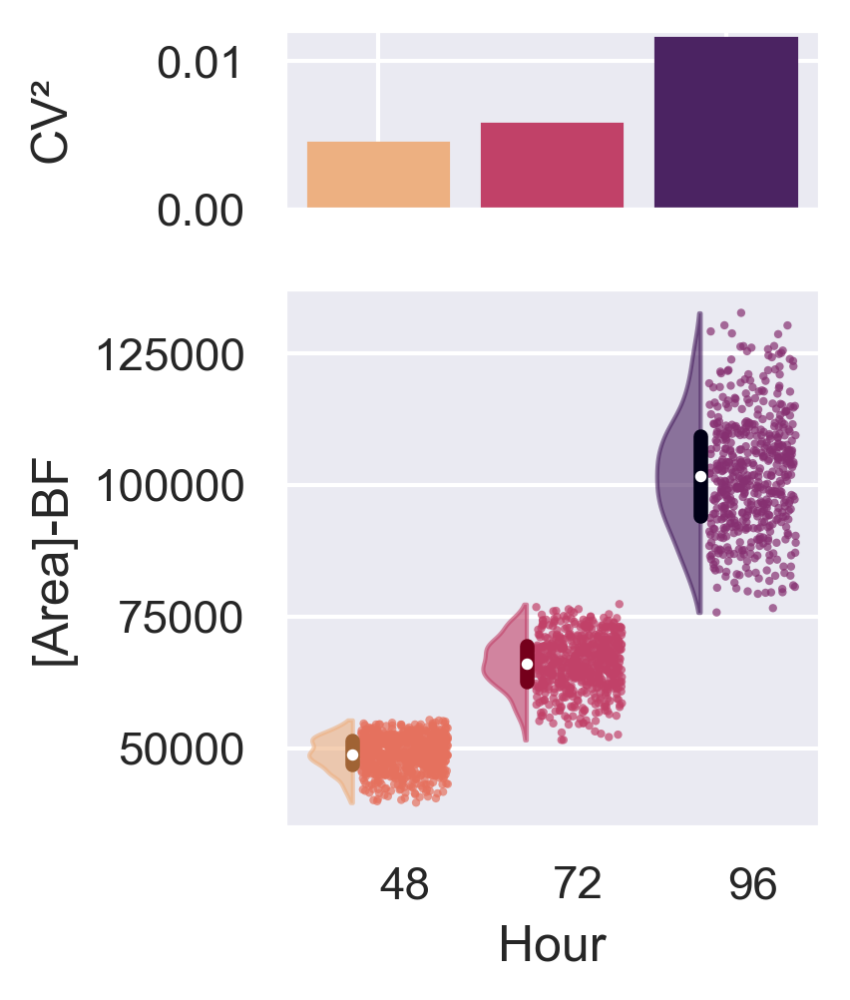

Hour
48    766
72    662
96    546
Name: [str LoCo EFA Coeff 1]-BF, dtype: int64


meta NOT subset; don't know how to subset; dropped


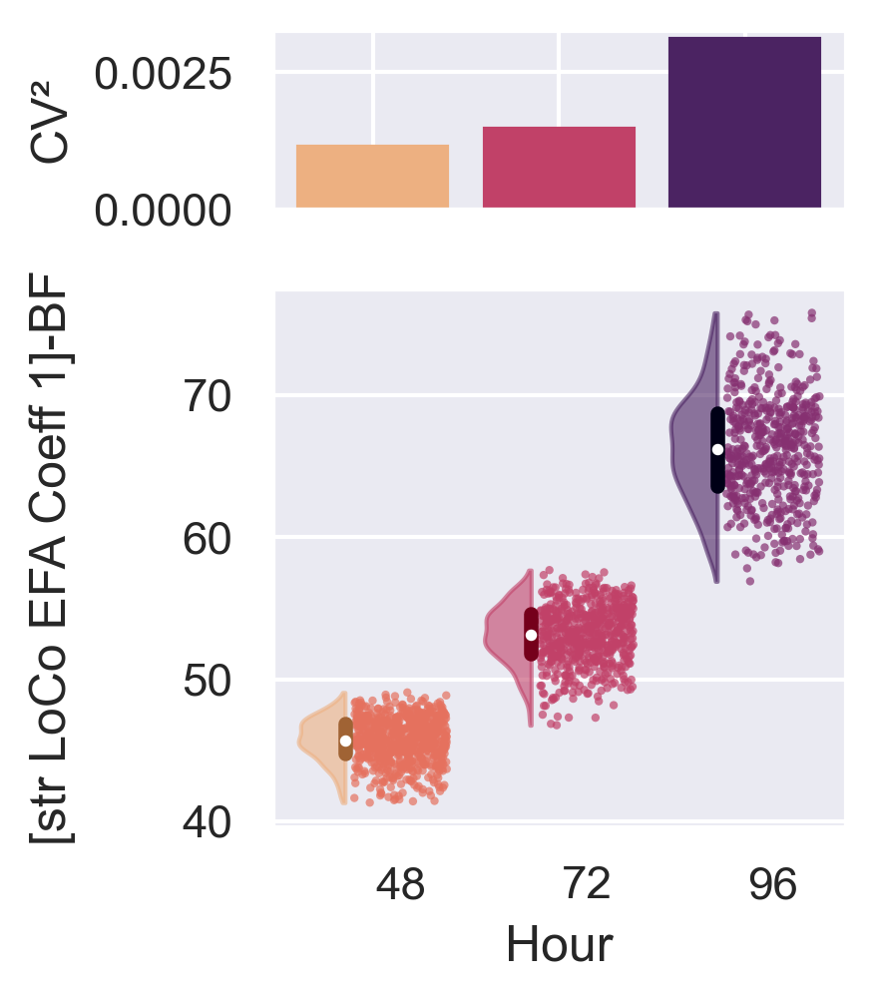

Hour
48    766
72    662
96    546
Name: [str Minor Axis Length]-BF, dtype: int64


meta NOT subset; don't know how to subset; dropped


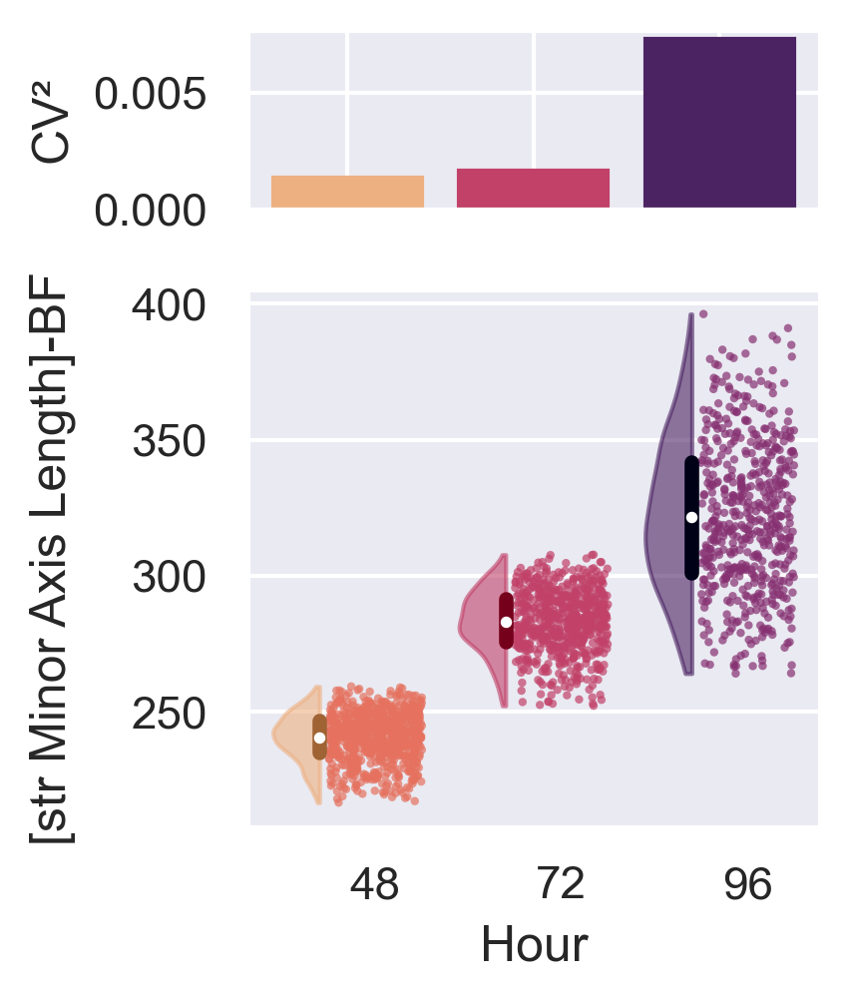

Hour
48    766
72    662
96    546
Name: [str Major Axis Length]-BF, dtype: int64


meta NOT subset; don't know how to subset; dropped


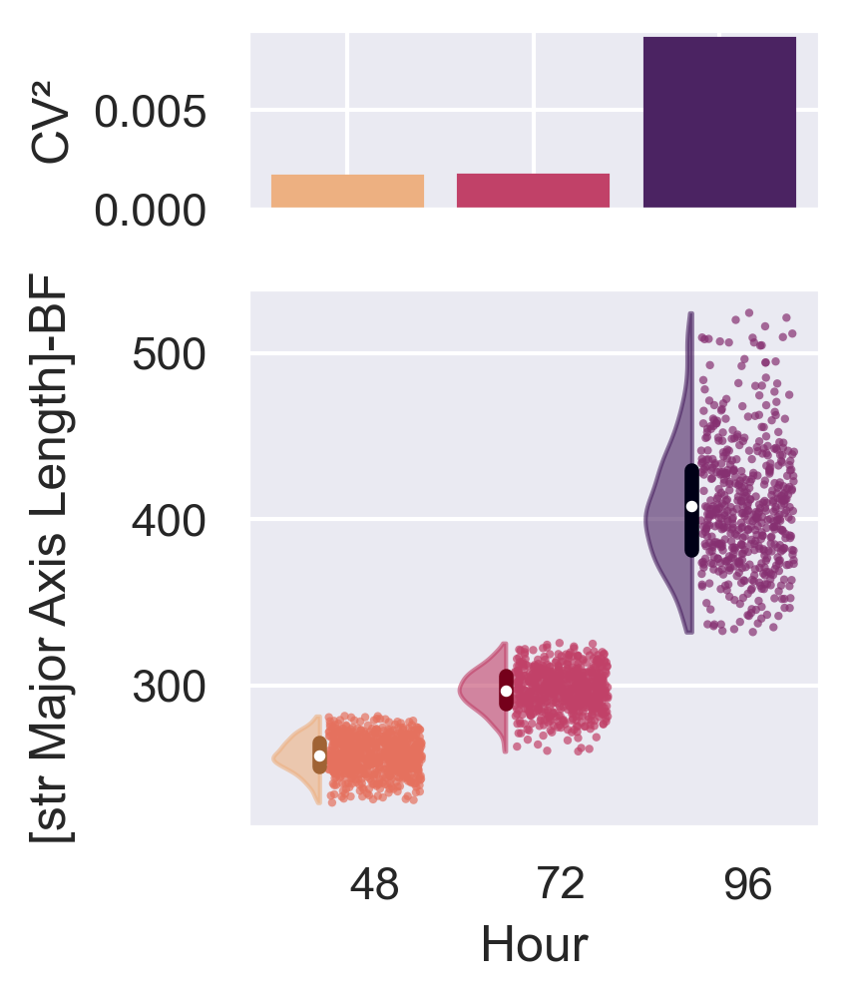

Hour
48    766
72    662
96    546
Name: [str Inertia Tensor 0 0]-BF, dtype: int64


meta NOT subset; don't know how to subset; dropped


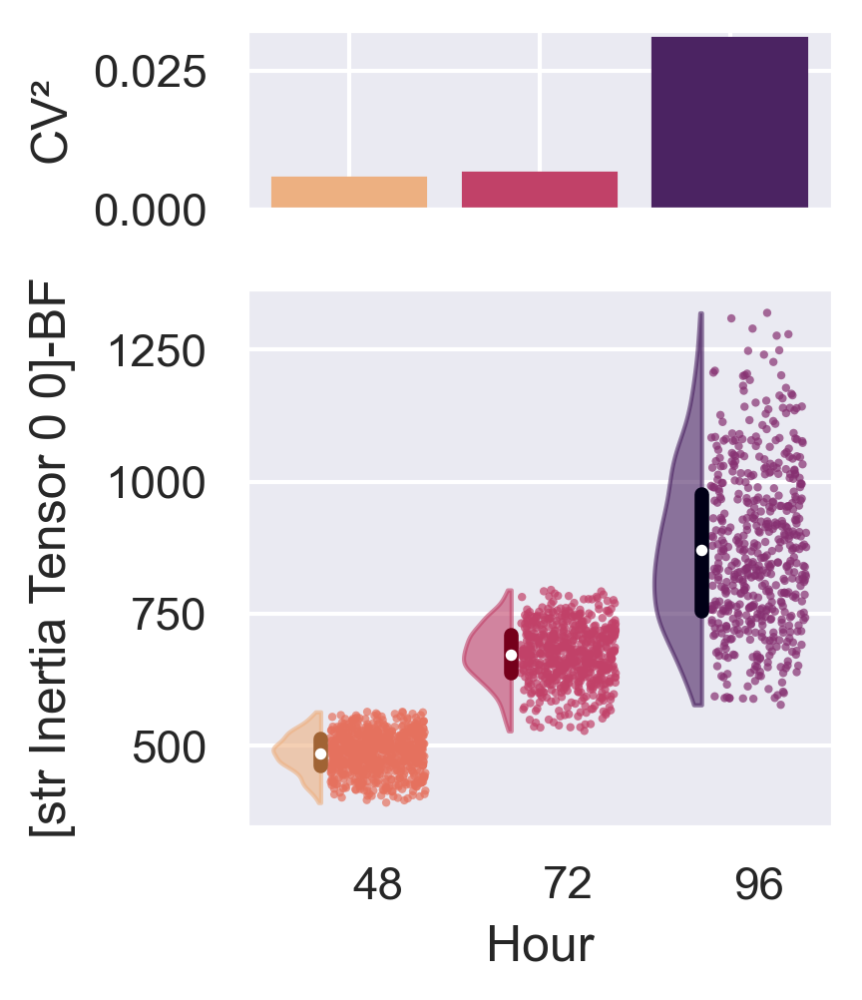

In [43]:
plotting_feats_PC1 = [
    'raw_BF_AreaShape_area', 
    'str_BF_AreaShape_locoefa_coeff_1',
    'str_BF_AreaShape_minor_axis_length',
    'str_BF_AreaShape_major_axis_length',
    'str_BF_AreaShape_inertia_tensor_0_0',
    
]

hours = [48,72,96]
df = stacked_raw_data.set_index(["Run","Plate","ID"])[plotting_feats_PC1+["Hour"]].rename(columns = areashape_name_mapping).dropna()

for feature in plotting_feats_PC1:
    
    feature = areashape_name_mapping[feature]
    df_filtered = pd.concat([
        filter_outliers_quantile(df[df['Hour']==hour],columns =[feature],quantile=0.01) for hour in hours
    ],axis=0)
    
    counts = df.groupby("Hour")[feature].count()
    print(counts)
    fig, axs = plt.subplots(2, 1, gridspec_kw={'height_ratios': [1, 3]},figsize = (3,3.5))
    CVs = [(np.std(df_filtered[df_filtered['Hour']==hour][feature])/np.mean(df_filtered[df_filtered['Hour']==hour][feature]))**2 for hour in hours]
    colors = [mpl.colormaps["flare"](float(i)) for i in [0,0.5,1]]
    axs[0].bar([0,1,2],CVs,color=colors,edgecolor=colors)
    axs[0].xaxis.set_tick_params(labelbottom=False)
    axs[0].set_ylabel("CV\u00b2")
    opp.raincloud_plot(df_filtered,"Hour",feature,ax=axs[1] ,jitter = 0.3,palette = 'flare', quantiles = [0.25,0.75], size_cloud = 2, size_quant = 3.5)
    fig.align_labels()
    plt.tight_layout()
    plt.savefig(f"{out_fig_1}/Feature Plots PC_1 {feature}.pdf", format="pdf", bbox_inches="tight")
    plt.show()

Hour
48    766
72    662
96    546
Name: [str Aspect Ratio]-BF, dtype: int64


meta NOT subset; don't know how to subset; dropped


Hour
48    766
72    662
96    546
Name: [str Form Factor]-BF, dtype: int64


meta NOT subset; don't know how to subset; dropped


Hour
48    766
72    662
96    546
Name: [str Inertia Tensor 1 1]-BF, dtype: int64


meta NOT subset; don't know how to subset; dropped


Hour
48    766
72    662
96    546
Name: [str Moments Hu 0]-BF, dtype: int64


meta NOT subset; don't know how to subset; dropped


Hour
48    766
72    662
96    546
Name: [str Moments Hu 1]-BF, dtype: int64


meta NOT subset; don't know how to subset; dropped


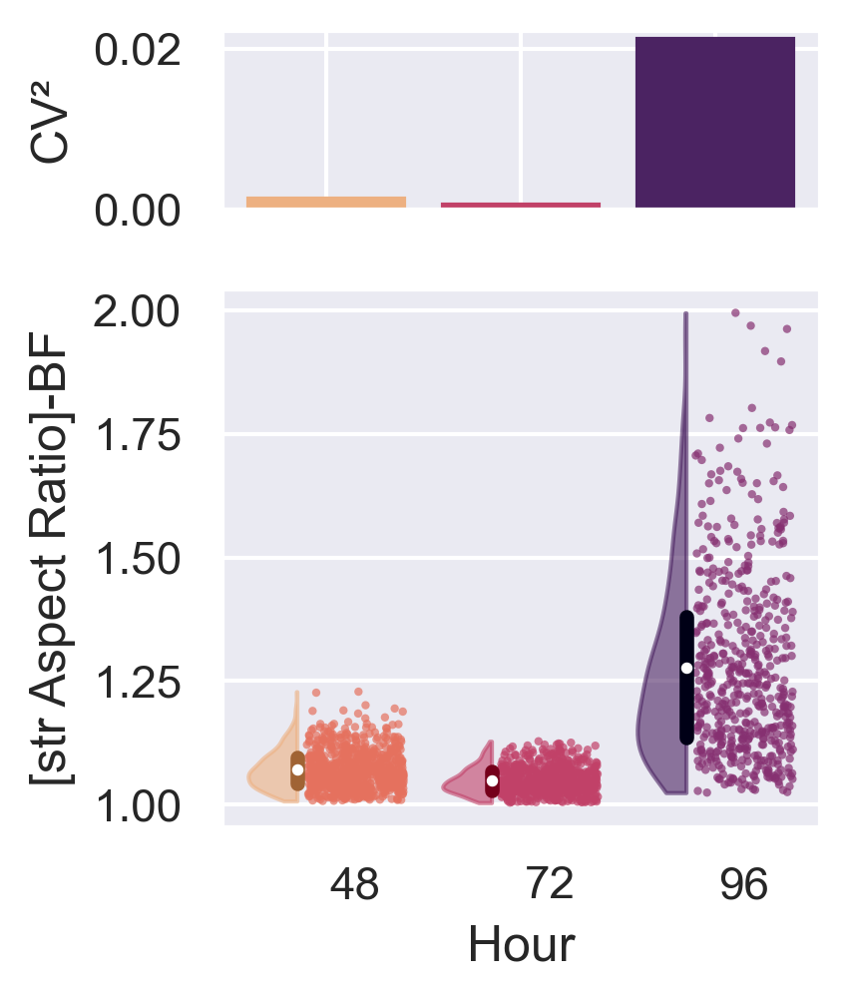

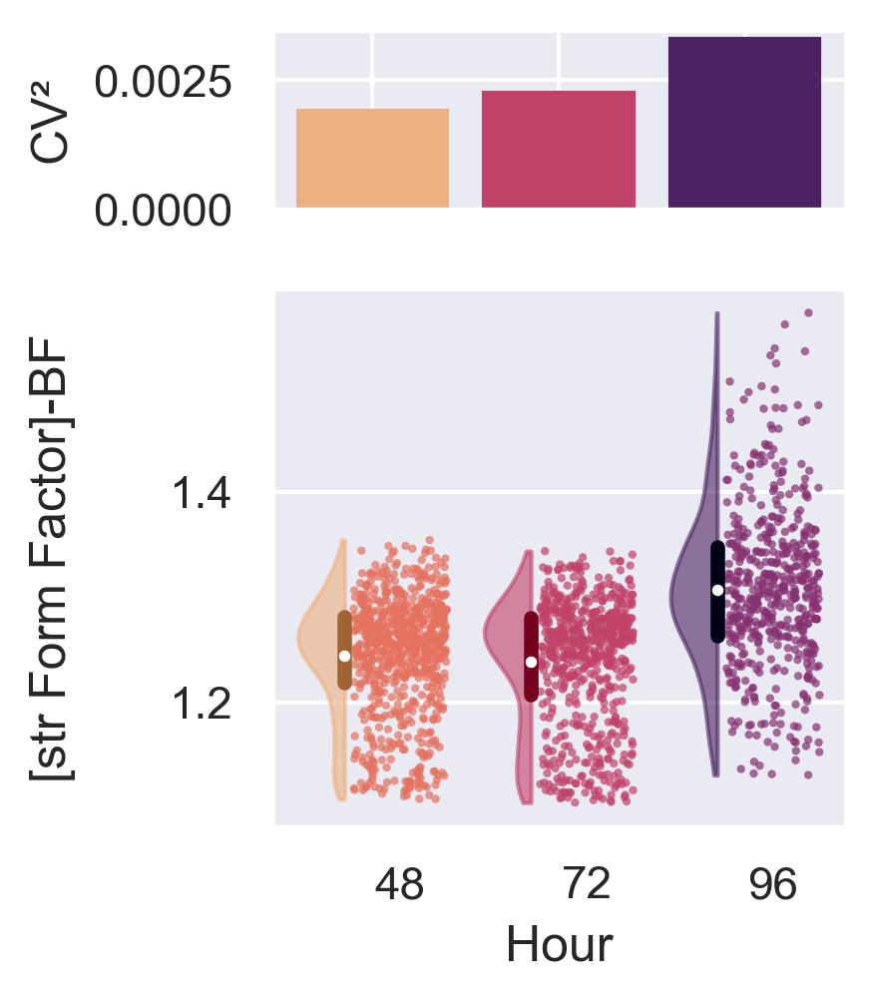

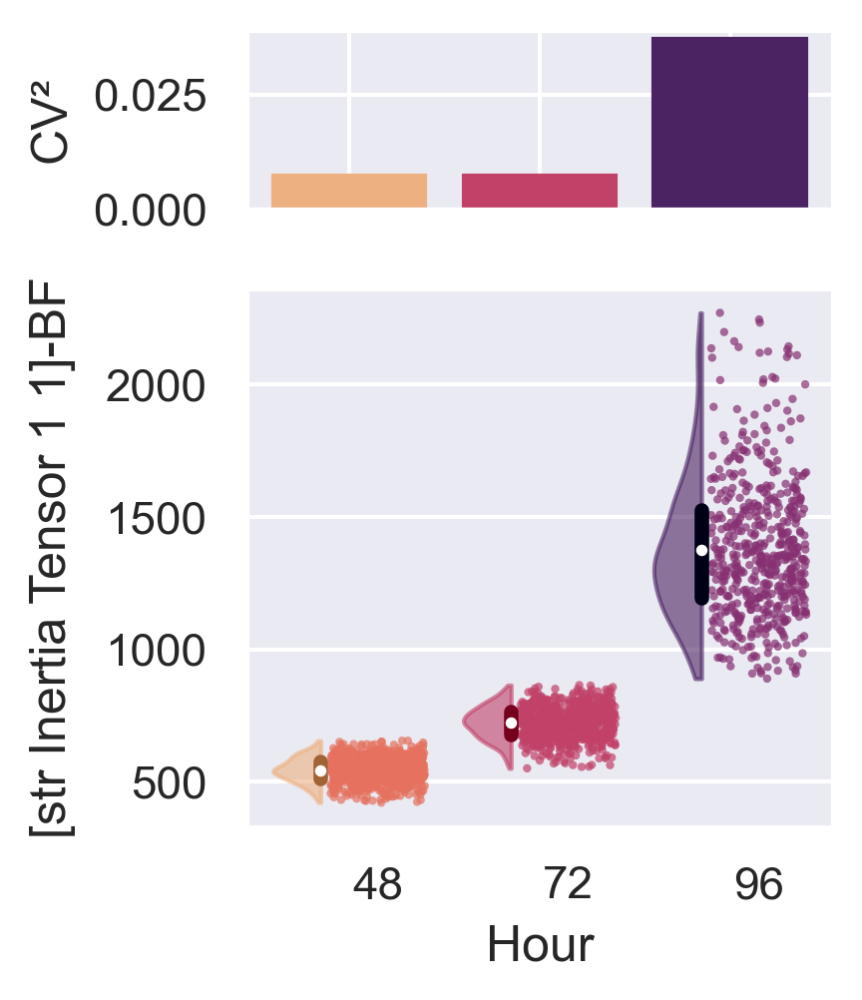

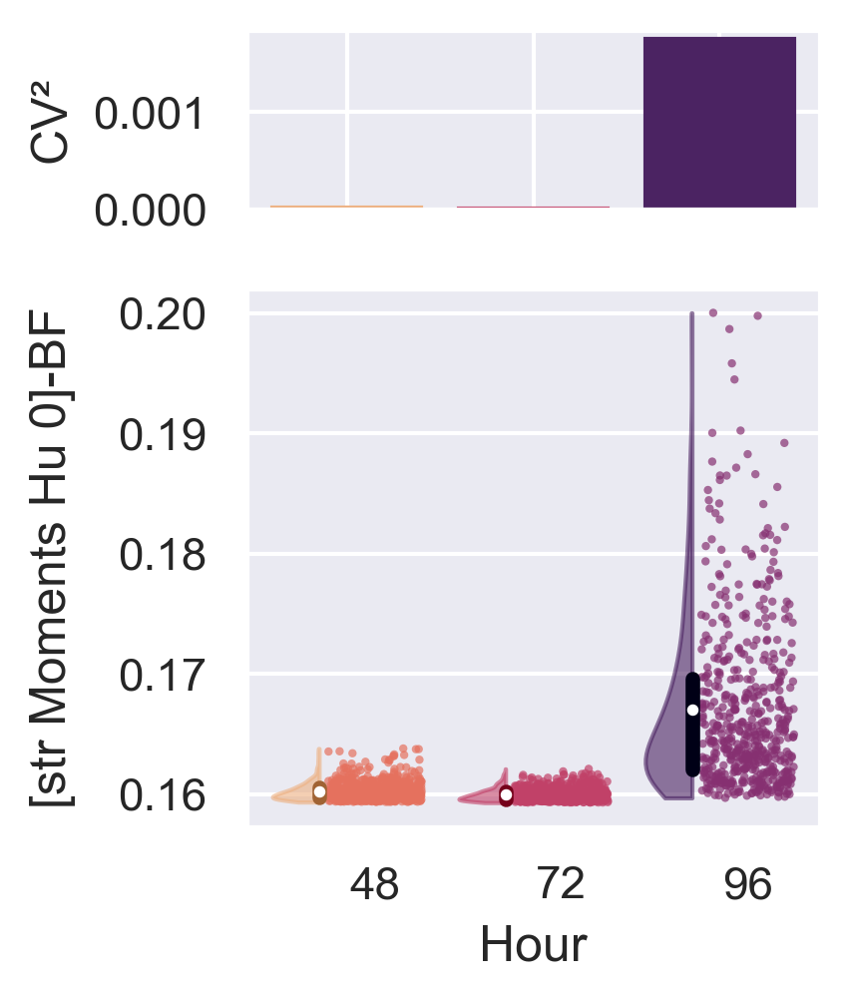

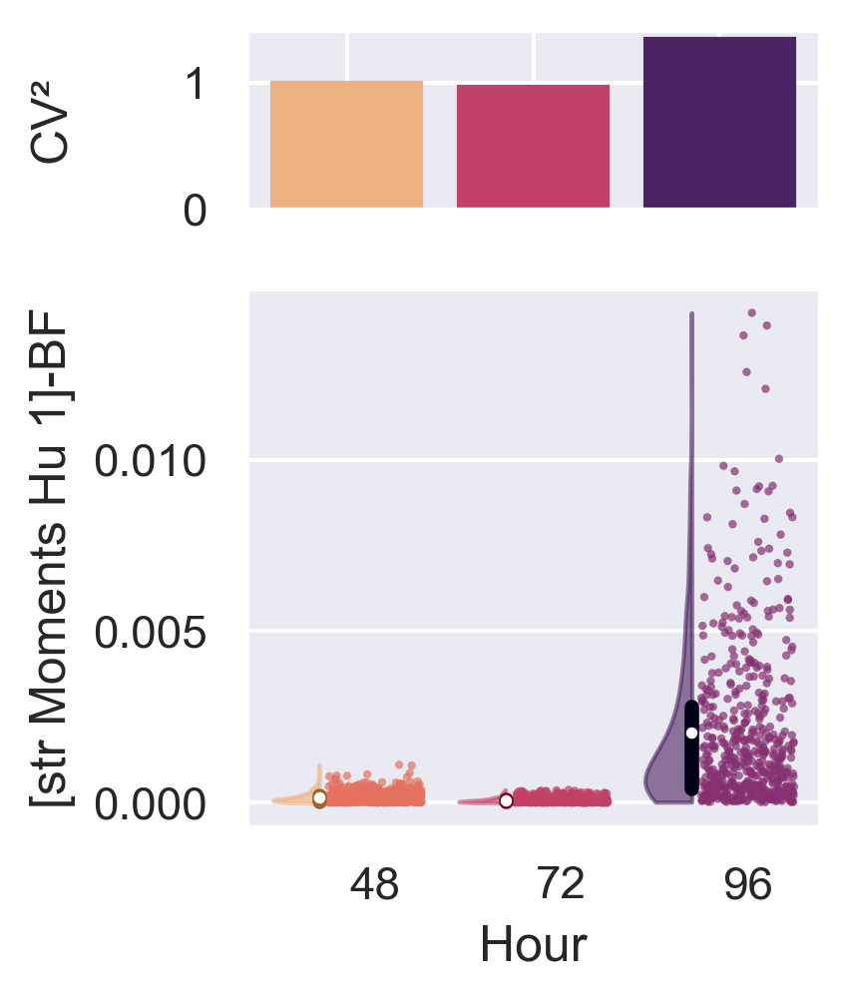

In [44]:
plotting_feats_PC2 = [
    'str_BF_AreaShape_aspect_ratio',
    'str_BF_AreaShape_form_factor',
    'str_BF_AreaShape_inertia_tensor_1_1',
    'str_BF_AreaShape_moments_hu_0',
    'str_BF_AreaShape_moments_hu_1'
]

hours = [48,72,96]
df = stacked_raw_data.set_index(["Run","Plate","ID"])[plotting_feats_PC2+["Hour"]].rename(columns = areashape_name_mapping).dropna()

for feature in plotting_feats_PC2:
    feature = areashape_name_mapping[feature]
    df_filtered = pd.concat([
        filter_outliers_quantile(df[df['Hour']==hour],columns =[feature],quantile=0.01) for hour in hours
    ],axis=0)
    counts = df.groupby("Hour")[feature].count()
    print(counts)
    fig, axs = plt.subplots(2, 1, gridspec_kw={'height_ratios': [1, 3]},figsize = (3,3.5))
    CVs = [(np.std(df_filtered[df_filtered['Hour']==hour][feature])/np.mean(df_filtered[df_filtered['Hour']==hour][feature]))**2 for hour in hours]
    colors = [mpl.colormaps["flare"](float(i)) for i in [0,0.5,1]]
    axs[0].bar([0,1,2],CVs,color=colors,edgecolor=colors)
    axs[0].xaxis.set_tick_params(labelbottom=False)
    axs[0].set_ylabel("CV\u00b2")
    opp.raincloud_plot(df_filtered,"Hour",feature,ax=axs[1] ,jitter = 0.3,palette = 'flare', quantiles = [0.25,0.75], size_cloud = 2, size_quant = 3.5)
    fig.align_labels()
    plt.tight_layout()
    plt.savefig(f"{out_fig_1}/Feature Plots PC_1 {feature}.pdf", format="pdf", bbox_inches="tight")
    plt.show

# Intensity Features

In [45]:
translation_intensity = pd.read_csv("translation_dataframe_intensity.csv")
intensity_name_mapping = {key:new_key for key,new_key in zip(translation_intensity["original_names"],translation_intensity["plot_names"])}

In [46]:
stacked_intensity = stacked_raw_data.set_index(["Run","Plate","ID","Hour"])[[key for key in stacked_raw_data.keys() if "CH" in key and "Location" not in key and ("bf_mask" in key or "Polarisation" in key)]].reset_index()
stacked_intensity

,Run,Plate,ID,Hour,raw_CH__bf_mask_Intensity_IntegratedIntensityEdge,raw_CH__bf_mask_Intensity_IntegratedIntensity,raw_CH__bf_mask_Intensity_LowerQuartileIntensity,raw_CH__bf_mask_Intensity_MADIntensity,raw_CH__bf_mask_Intensity_MassDisplacement,raw_CH__bf_mask_Intensity_MaxIntensityEdge,...,raw_CH__bf_mask_RadialDistribution_RadialCV_2of9,raw_CH__bf_mask_RadialDistribution_RadialCV_3of9,raw_CH__bf_mask_RadialDistribution_RadialCV_4of9,raw_CH__bf_mask_RadialDistribution_RadialCV_5of9,raw_CH__bf_mask_RadialDistribution_RadialCV_6of9,raw_CH__bf_mask_RadialDistribution_RadialCV_7of9,raw_CH__bf_mask_RadialDistribution_RadialCV_8of9,raw_CH__bf_mask_RadialDistribution_RadialCV_9of9,str_CH_AreaShape_Bra_MajorAxis_Polarisation,str_CH_AreaShape_Bra_MinorAxis_Polarisation
0,RR,1,A1,48,1132.460011,30404.082708,4.320230,0.151038,0.028621,8.936507,...,0.004932,0.006158,0.005967,0.004276,0.003854,0.006812,0.005774,0.007652,0.033602,0.009469
1,RR,1,A2,48,1104.095288,27371.370576,4.327778,0.156104,0.068145,5.000000,...,0.004867,0.005225,0.006738,0.004694,0.003055,0.009238,0.007633,0.008265,0.006087,0.002021
2,RR,1,A3,48,1222.842997,32424.706884,4.335179,0.152635,0.161943,5.571893,...,0.008475,0.008893,0.013924,0.005426,0.004544,0.006895,0.010967,0.012468,0.043632,0.003480
3,RR,1,A4,48,1126.279695,27771.055475,4.311009,0.165333,0.058567,4.923713,...,0.006409,0.005854,0.008474,0.004658,0.004575,0.007493,0.007832,0.006192,0.003000,0.005707
4,RR,1,A5,48,1145.347147,29971.192562,4.303294,0.164393,0.062234,5.666567,...,0.011102,0.008453,0.004818,0.007611,0.002931,0.004113,0.009191,0.005434,0.026882,0.017541
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2296,TR,2,H8,96,6556.801202,462639.113364,25.350388,6.214839,3.039192,27.766291,...,0.042135,0.064024,0.064368,0.049464,0.053564,0.065979,0.097842,0.174145,0.010821,0.026928
2297,TR,2,H9,96,6635.232520,486682.873229,21.564569,8.117262,6.946939,27.029905,...,0.044967,0.047617,0.099008,0.174405,0.183116,0.200912,0.251102,0.303376,0.035616,0.026081
2298,TR,2,H10,96,7230.961206,559454.539333,24.635021,8.256464,4.151917,27.589903,...,0.031158,0.029164,0.035251,0.058248,0.076069,0.095931,0.127835,0.164975,0.009338,0.004076
2299,TR,2,H11,96,6532.386625,495147.816723,24.326976,7.154193,0.825404,22.077049,...,0.038785,0.042553,0.041750,0.038205,0.048451,0.054394,0.068936,0.068984,0.012343,0.042325


meta NOT subset; don't know how to subset; dropped


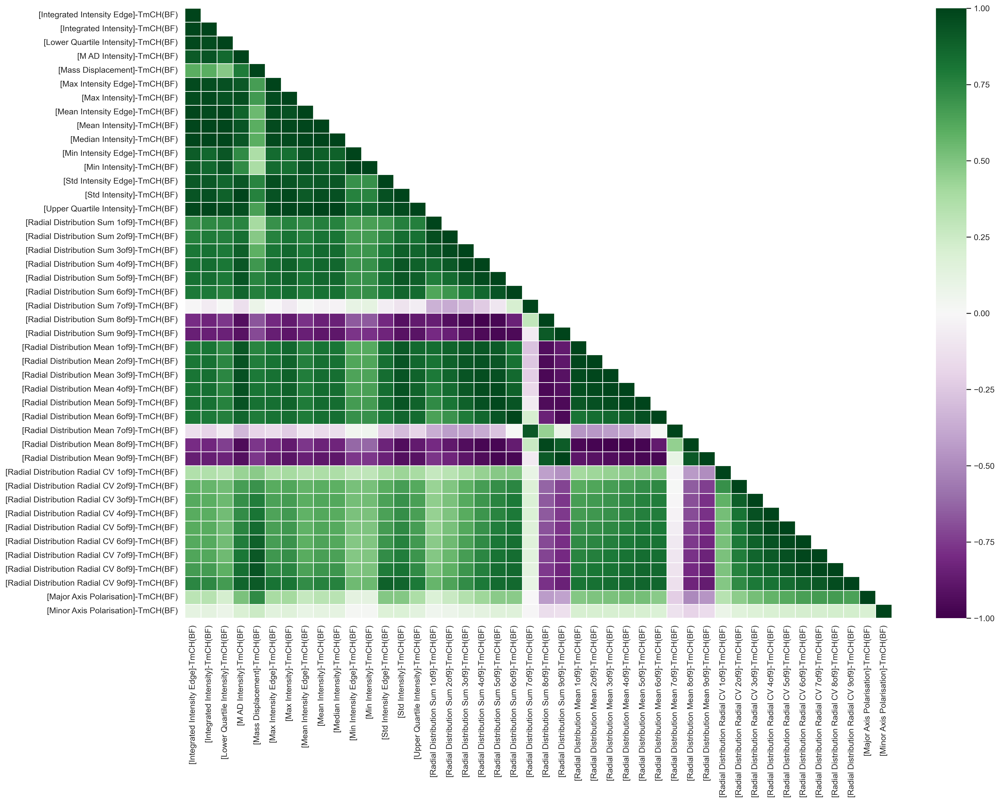

In [47]:
correlation_frame_intensity = stacked_intensity.drop(["Hour","Run","Plate","ID"],axis=1).rename(columns=intensity_name_mapping).corr()

fig,ax = plt.subplots(1,1,figsize = (20,15))

mask = np.ones(correlation_frame_intensity.shape, dtype= bool)
mask = np.triu(mask, k = 1)

sns.heatmap(correlation_frame_intensity, cmap = "PRGn",vmin=-1, vmax=1, xticklabels='auto', yticklabels='auto', mask=mask, ax=ax,linewidths=0.5)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1_supp}/Correlation Plot Brachyury.pdf", format="pdf", bbox_inches="tight")
plt.show()

In [48]:
#df = stacked_intensity.drop(["Hour","Run","Plate","ID"],axis=1)
#correlating_features(df)

In [49]:
stacked_intensity.keys().to_numpy()

array(['Run', 'Plate', 'ID', 'Hour',
       'raw_CH__bf_mask_Intensity_IntegratedIntensityEdge',
       'raw_CH__bf_mask_Intensity_IntegratedIntensity',
       'raw_CH__bf_mask_Intensity_LowerQuartileIntensity',
       'raw_CH__bf_mask_Intensity_MADIntensity',
       'raw_CH__bf_mask_Intensity_MassDisplacement',
       'raw_CH__bf_mask_Intensity_MaxIntensityEdge',
       'raw_CH__bf_mask_Intensity_MaxIntensity',
       'raw_CH__bf_mask_Intensity_MeanIntensityEdge',
       'raw_CH__bf_mask_Intensity_MeanIntensity',
       'raw_CH__bf_mask_Intensity_MedianIntensity',
       'raw_CH__bf_mask_Intensity_MinIntensityEdge',
       'raw_CH__bf_mask_Intensity_MinIntensity',
       'raw_CH__bf_mask_Intensity_StdIntensityEdge',
       'raw_CH__bf_mask_Intensity_StdIntensity',
       'raw_CH__bf_mask_Intensity_UpperQuartileIntensity',
       'raw_CH__bf_mask_RadialDistribution_FracAtD_1of9',
       'raw_CH__bf_mask_RadialDistribution_FracAtD_2of9',
       'raw_CH__bf_mask_RadialDistribution_FracAt

In [50]:
reg_columns = [
        'str_CH_AreaShape_Bra_MajorAxis_Polarisation',
        'str_CH_AreaShape_Bra_MinorAxis_Polarisation',
        'raw_CH__bf_mask_Intensity_MassDisplacement',
]

others = [key for key in stacked_intensity.drop(["Hour","Run","Plate","ID"],axis=1).keys() if key not in reg_columns]
stacked_indexed = stacked_intensity.set_index(["Run","Plate","ID"])
to_scale = stacked_indexed.loc[stacked_indexed[stacked_indexed["Hour"]==96].dropna().index].dropna().reset_index()
to_scale

,Run,Plate,ID,Hour,raw_CH__bf_mask_Intensity_IntegratedIntensityEdge,raw_CH__bf_mask_Intensity_IntegratedIntensity,raw_CH__bf_mask_Intensity_LowerQuartileIntensity,raw_CH__bf_mask_Intensity_MADIntensity,raw_CH__bf_mask_Intensity_MassDisplacement,raw_CH__bf_mask_Intensity_MaxIntensityEdge,...,raw_CH__bf_mask_RadialDistribution_RadialCV_2of9,raw_CH__bf_mask_RadialDistribution_RadialCV_3of9,raw_CH__bf_mask_RadialDistribution_RadialCV_4of9,raw_CH__bf_mask_RadialDistribution_RadialCV_5of9,raw_CH__bf_mask_RadialDistribution_RadialCV_6of9,raw_CH__bf_mask_RadialDistribution_RadialCV_7of9,raw_CH__bf_mask_RadialDistribution_RadialCV_8of9,raw_CH__bf_mask_RadialDistribution_RadialCV_9of9,str_CH_AreaShape_Bra_MajorAxis_Polarisation,str_CH_AreaShape_Bra_MinorAxis_Polarisation
0,RR,1,A1,48,1132.460011,30404.082708,4.320230,0.151038,0.028621,8.936507,...,0.004932,0.006158,0.005967,0.004276,0.003854,0.006812,0.005774,0.007652,0.033602,0.009469
1,RR,1,A1,72,2239.774543,101744.265766,9.336175,1.079727,1.805361,9.390489,...,0.024831,0.035742,0.045388,0.064073,0.082004,0.096488,0.107059,0.099171,0.034712,0.004817
2,RR,1,A1,96,5641.713953,427306.592041,22.838628,5.545329,4.352333,29.757420,...,0.034539,0.041787,0.032717,0.048528,0.074071,0.109946,0.215912,0.292312,0.027743,0.018767
3,RR,1,A2,48,1104.095288,27371.370576,4.327778,0.156104,0.068145,5.000000,...,0.004867,0.005225,0.006738,0.004694,0.003055,0.009238,0.007633,0.008265,0.006087,0.002021
4,RR,1,A2,72,2097.041809,78496.988087,9.016112,0.774042,1.420113,9.725360,...,0.028786,0.021880,0.011946,0.043994,0.065817,0.067212,0.092454,0.091808,0.033152,0.000424
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1632,TR,2,H11,72,2416.456887,97434.172291,12.605261,1.261052,1.426458,13.626520,...,0.023630,0.031093,0.031733,0.032381,0.046578,0.061625,0.092709,0.124392,0.011360,0.017500
1633,TR,2,H11,96,6532.386625,495147.816723,24.326976,7.154193,0.825404,22.077049,...,0.038785,0.042553,0.041750,0.038205,0.048451,0.054394,0.068936,0.068984,0.012343,0.042325
1634,TR,2,H12,48,852.776360,20736.575800,3.346849,0.150823,0.075753,4.000000,...,0.008015,0.007367,0.006591,0.007653,0.017061,0.016759,0.009647,0.005321,0.003848,0.016681
1635,TR,2,H12,72,3073.835258,126350.101178,14.534070,1.140832,0.392734,14.775661,...,0.017438,0.034358,0.035226,0.017295,0.026817,0.034122,0.045264,0.041386,0.000110,0.001110


In [51]:
scaled_timecourse = opp.differential_standard_scaling(
    to_scale.set_index(["Hour","Run","Plate","ID"]), 
    columns_regular = reg_columns,
    columns_by_index = others, 
    by_index_grouping = ["Run","Plate"],
    columns_group_scaling=[],
    columns_unscaled=[],
    
).reset_index().dropna()

scaled_timecourse

,Hour,Run,Plate,ID,str_CH_AreaShape_Bra_MajorAxis_Polarisation,str_CH_AreaShape_Bra_MinorAxis_Polarisation,raw_CH__bf_mask_Intensity_MassDisplacement,raw_CH__bf_mask_Intensity_IntegratedIntensityEdge,raw_CH__bf_mask_Intensity_IntegratedIntensity,raw_CH__bf_mask_Intensity_LowerQuartileIntensity,...,raw_CH__bf_mask_RadialDistribution_MeanFrac_9of9,raw_CH__bf_mask_RadialDistribution_RadialCV_1of9,raw_CH__bf_mask_RadialDistribution_RadialCV_2of9,raw_CH__bf_mask_RadialDistribution_RadialCV_3of9,raw_CH__bf_mask_RadialDistribution_RadialCV_4of9,raw_CH__bf_mask_RadialDistribution_RadialCV_5of9,raw_CH__bf_mask_RadialDistribution_RadialCV_6of9,raw_CH__bf_mask_RadialDistribution_RadialCV_7of9,raw_CH__bf_mask_RadialDistribution_RadialCV_8of9,raw_CH__bf_mask_RadialDistribution_RadialCV_9of9
0,48,RR,1,A1,0.785618,-0.253316,-0.728327,-0.924754,-0.841580,-0.940229,...,1.145404,-0.738310,-1.156568,-1.033442,-0.981470,-0.987004,-0.986696,-0.965028,-1.005788,-0.999723
1,72,RR,1,A1,0.849875,-0.660319,-0.198223,-0.228260,-0.296664,-0.069600,...,-0.143300,-0.727027,-0.376444,-0.159357,-0.139459,-0.020163,-0.010934,-0.044071,-0.108472,-0.212903
2,96,RR,1,A1,0.446566,0.560322,0.561686,1.911539,2.190070,2.274052,...,-1.244192,-0.174584,0.004162,0.019257,-0.410111,-0.271514,-0.109982,0.094138,0.855892,1.447585
3,48,RR,1,A2,-0.806597,-0.904969,-0.716534,-0.942595,-0.864745,-0.938919,...,1.144717,-0.610822,-1.159108,-1.061010,-0.965011,-0.980243,-0.996672,-0.940108,-0.989314,-0.994454
4,72,RR,1,A2,0.759591,-1.044762,-0.313164,-0.318038,-0.474233,-0.125154,...,0.101068,-0.198972,-0.221403,-0.568911,-0.853777,-0.344808,-0.213036,-0.344727,-0.237865,-0.276209
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1632,72,TR,2,H11,-0.501478,0.449399,-0.311271,-0.205217,-0.383740,0.200152,...,-0.405668,0.480466,-0.306598,-0.223653,-0.363037,-0.477314,-0.338503,-0.243753,-0.057418,0.133526
1633,96,TR,2,H11,-0.444581,2.621673,-0.490600,1.663559,1.910733,1.681990,...,-1.136494,-0.586222,0.442275,0.202126,-0.070485,-0.347686,-0.305679,-0.345912,-0.327803,-0.413859
1634,48,TR,2,H12,-0.936188,0.377802,-0.714264,-0.915183,-0.826221,-0.970279,...,1.136918,-0.259995,-1.078147,-1.105104,-1.097381,-1.027650,-0.855868,-0.877679,-1.002135,-1.042788
1635,72,TR,2,H12,-1.152510,-0.984757,-0.619691,0.093256,-0.216919,0.443989,...,0.060730,-0.496770,-0.612532,-0.102327,-0.261036,-0.813060,-0.684864,-0.632340,-0.597035,-0.686500


<Axes: xlabel='UMAP_1', ylabel='UMAP_2'>

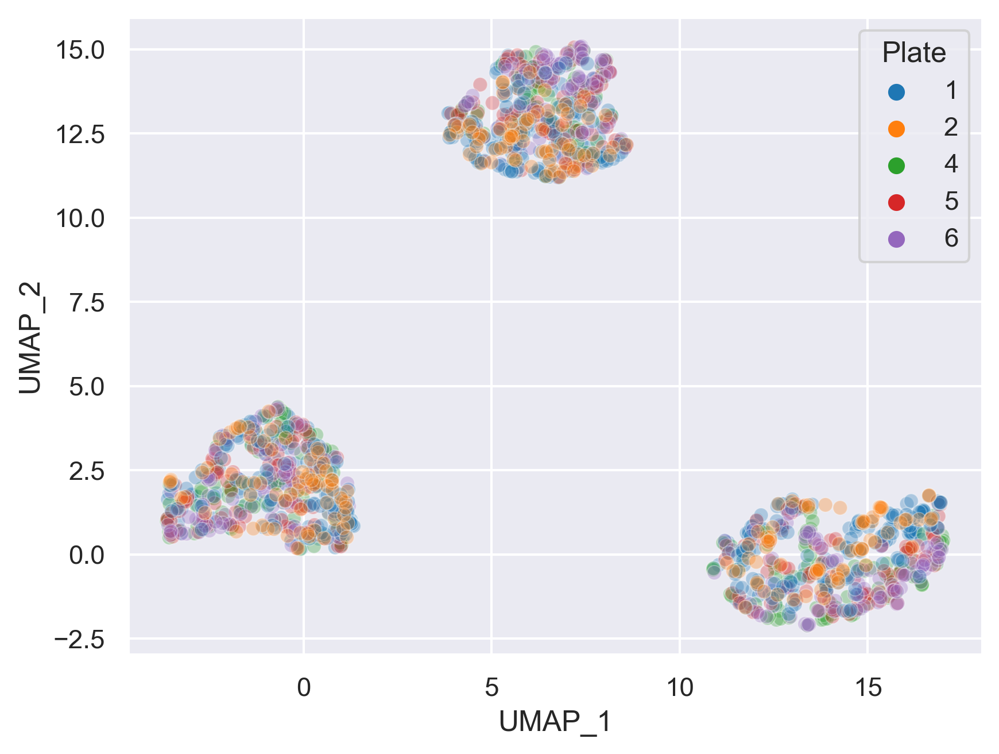

In [52]:
# check if scaling is biased by individual plates
scale_indexed = scaled_timecourse.set_index(["Run","Plate","ID"])

check_umap = opp.umap_with_indices_and_ground_truth(
    scale_indexed.drop("Hour",axis=1),
    ground_truth_df=scale_indexed,
    gt_keys=["Hour"],
    standardscale=False,
    random_state=21,
    n_components=2,
    n_neighbors=5,
)

sns.scatterplot(
    check_umap.reset_index(),x="UMAP_1",y="UMAP_2",hue = "Plate",**{"alpha":0.3},palette="tab10"
)

<Axes: xlabel='UMAP_1', ylabel='UMAP_2'>

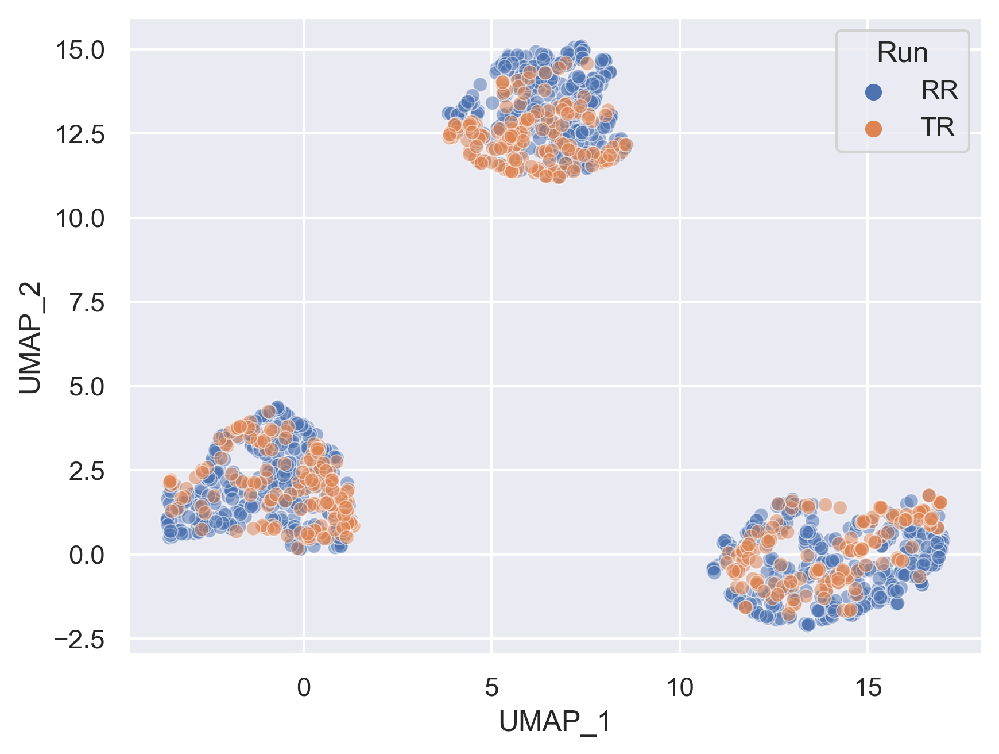

In [53]:
sns.scatterplot(check_umap.reset_index(),x="UMAP_1",y="UMAP_2",hue = "Run",**{"alpha":0.5})

<Axes: xlabel='UMAP_1', ylabel='UMAP_2'>

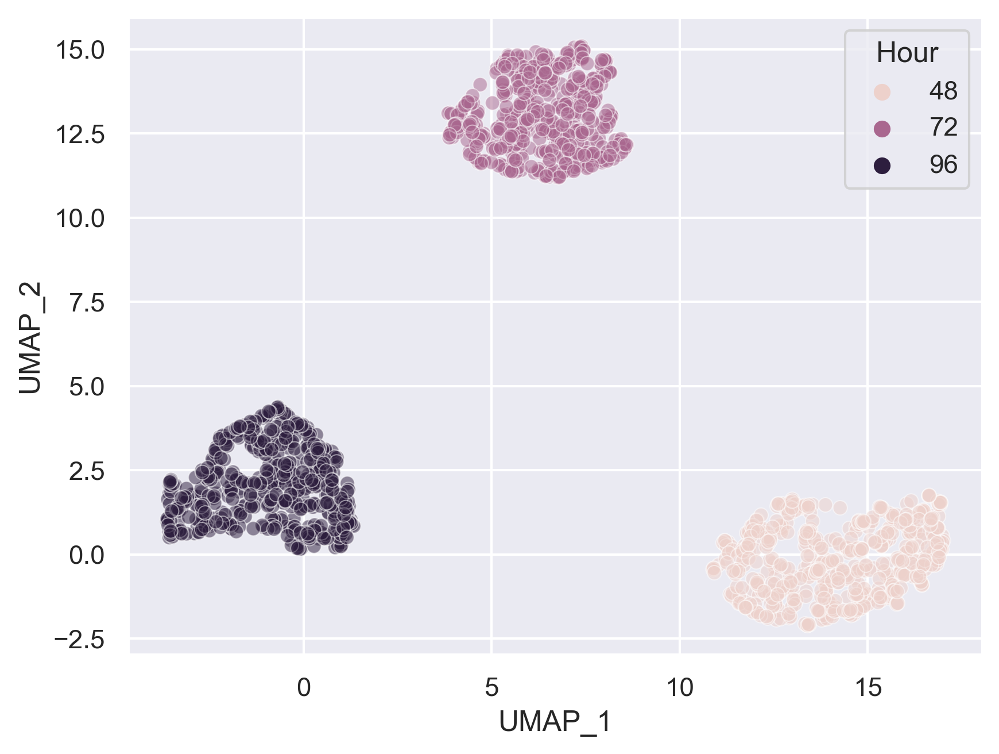

In [54]:
sns.scatterplot(check_umap.reset_index(),x="UMAP_1",y="UMAP_2",hue = "Hour",**{"alpha":0.5})

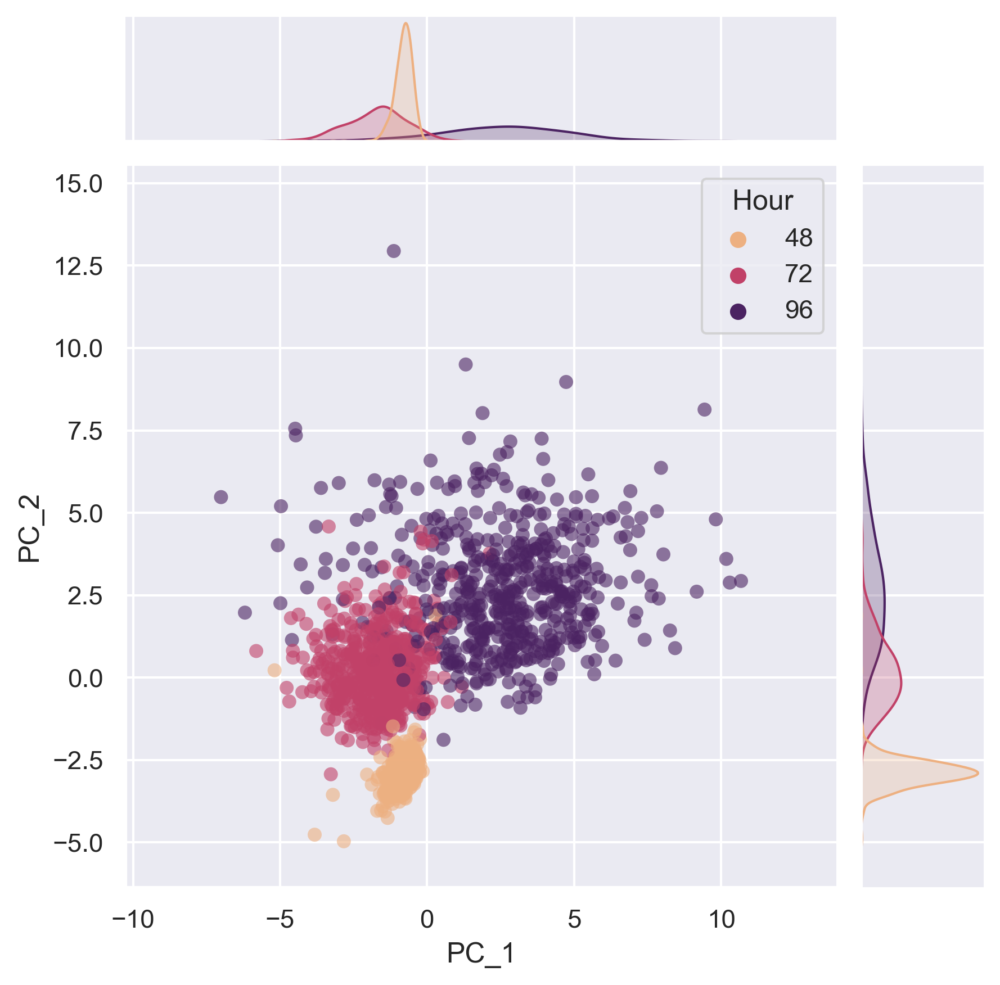

In [55]:
selected_intensity_feats = scaled_timecourse.set_index(["Run","Plate","ID"])

pca_df_intensity, transformer_intensity = opp.sparse_PCA_with_indices_and_ground_truth(
    selected_intensity_feats.drop("Hour",axis=1),
    ground_truth_df=pd.DataFrame(selected_intensity_feats["Hour"].astype(int)),
    gt_keys=["Hour"],
    n_components=4,
    remove_unclassified=False,
    return_transformer=True,
    randomstate=42,
    standardscale=False,
)

sns.jointplot(pca_df_intensity,x="PC_1",y="PC_2",hue="Hour",palette="flare", **{"alpha":0.6,"edgecolor":"none"},)

In [56]:
counts = pca_df_intensity.groupby("Hour")["PC_1"].count()
print(counts)

Hour
48    545
72    546
96    546
Name: PC_1, dtype: int64


meta NOT subset; don't know how to subset; dropped


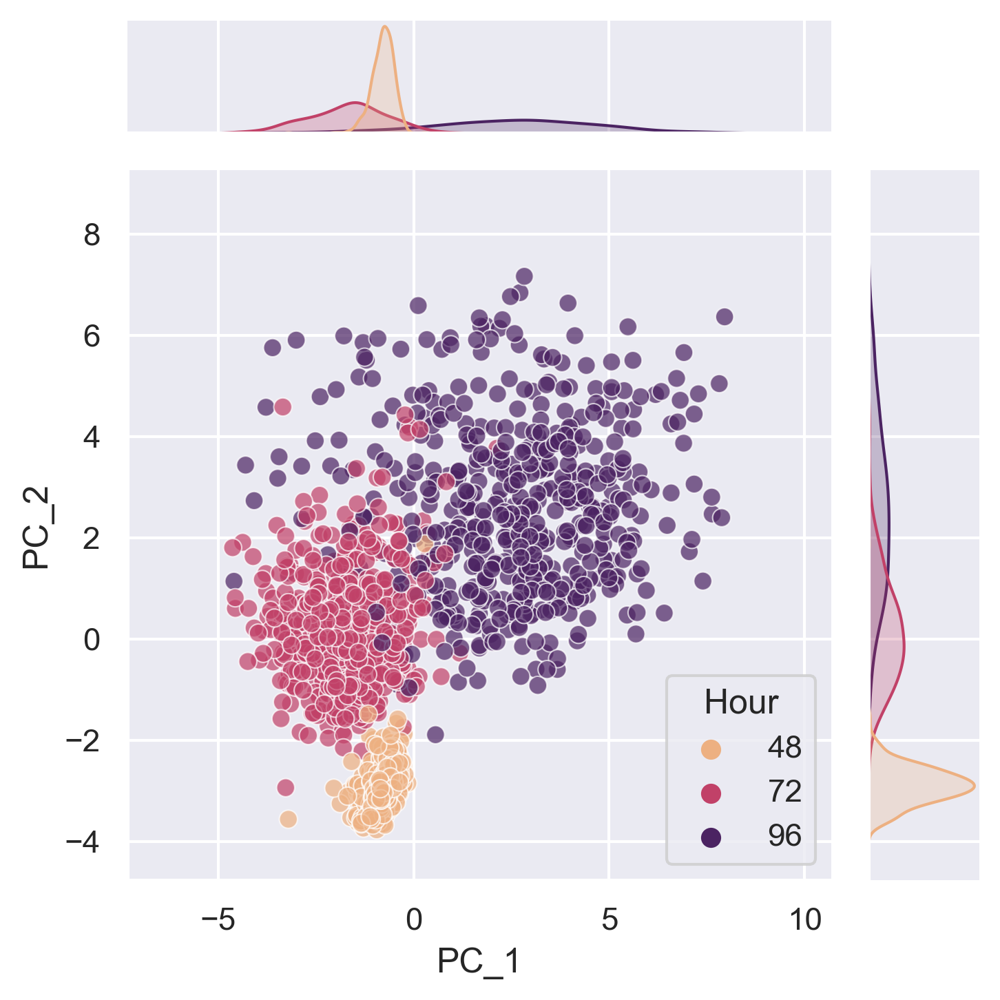

In [57]:
sns.jointplot(filter_outliers_quantile(pca_df_intensity,columns=["PC_1","PC_2"]),x="PC_1",y="PC_2",hue="Hour",palette="flare", **{"alpha":0.7,"s":40},height=5)

plt.tight_layout()
plt.savefig(f"{out_fig_1}/PCA Plot PC1&2 Brachyury.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


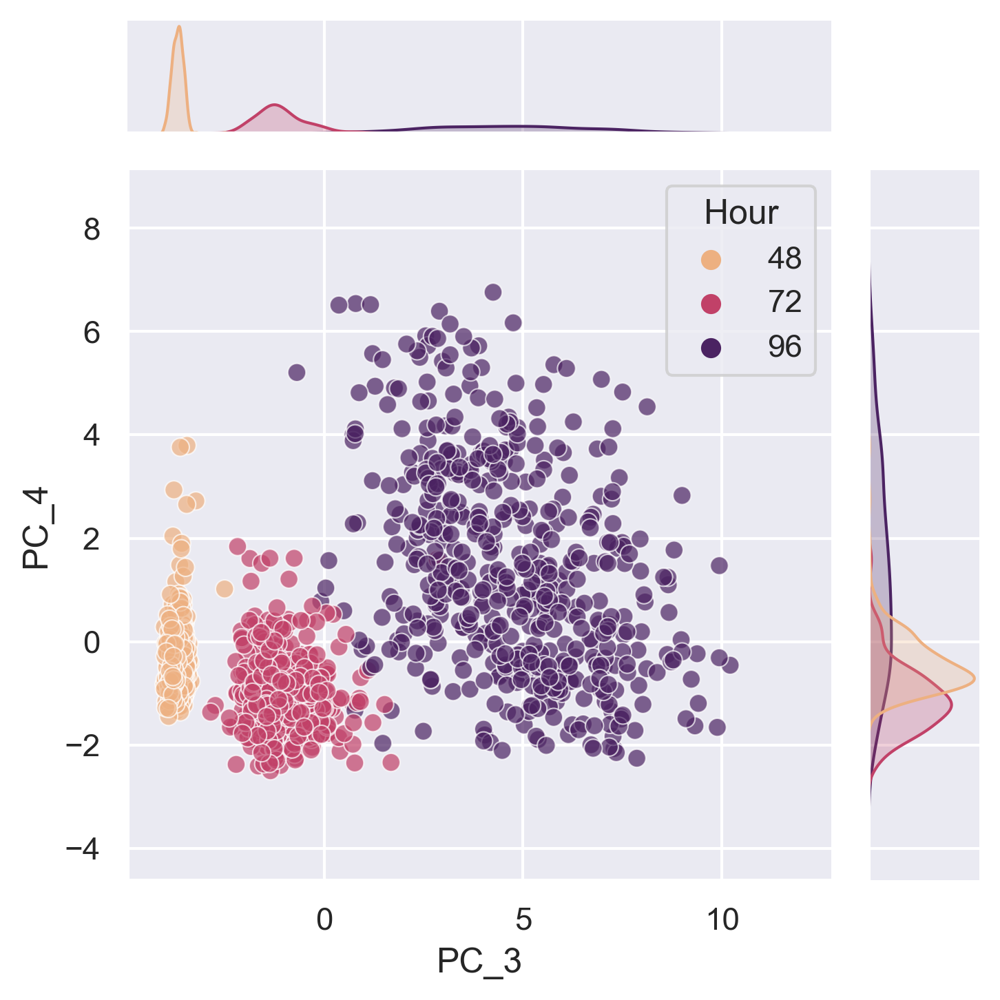

In [58]:
ax = sns.jointplot(filter_outliers_quantile(pca_df_intensity,columns=["PC_3","PC_4"]),x="PC_3",y="PC_4",hue="Hour",palette="flare", **{"alpha":0.7,"s":40},height=5)

plt.tight_layout()
plt.savefig(f"{out_fig_1}/PCA Plot PC3&4 Brachyury.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


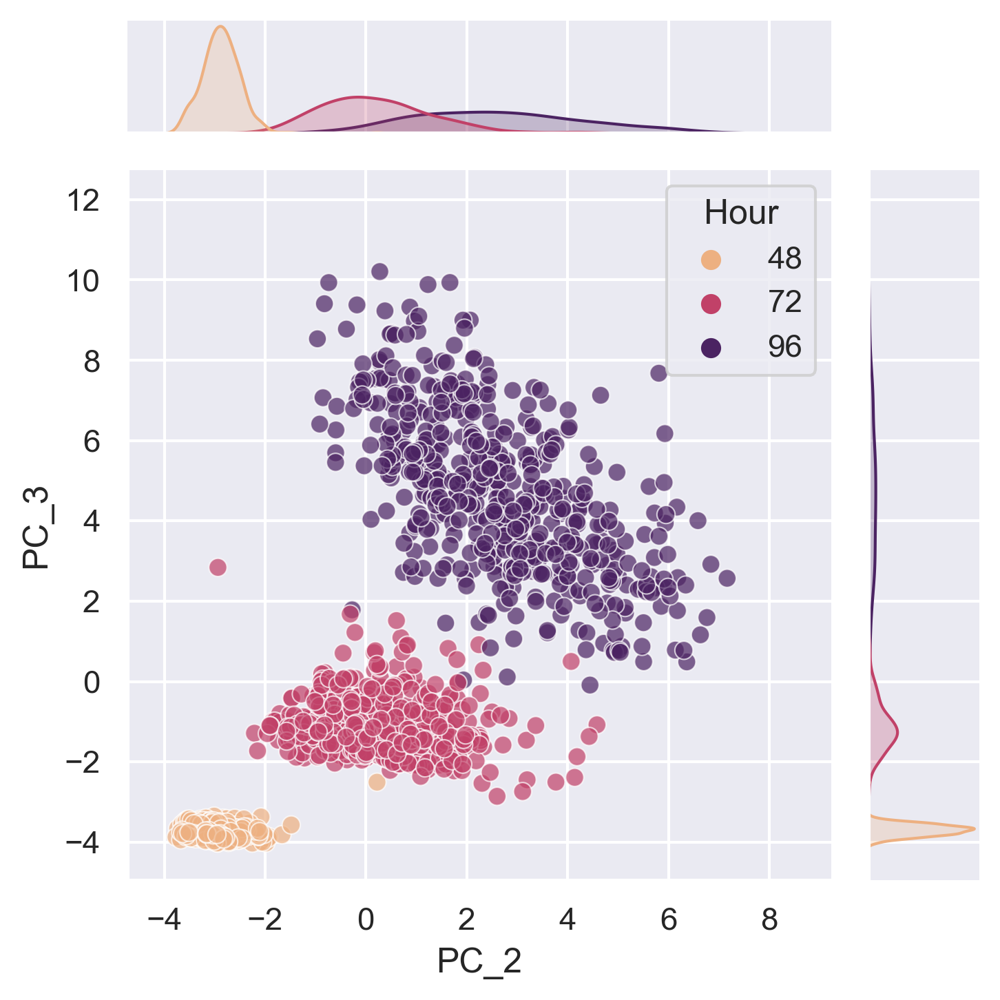

In [59]:
sns.jointplot(filter_outliers_quantile(pca_df_intensity,columns=["PC_2","PC_3"]),x="PC_2",y="PC_3",hue="Hour",palette="flare", **{"alpha":0.7,"s":40},height=5)

plt.tight_layout()
plt.savefig(f"{out_fig_1}/PCA Plot PC2&3 Brachyury.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


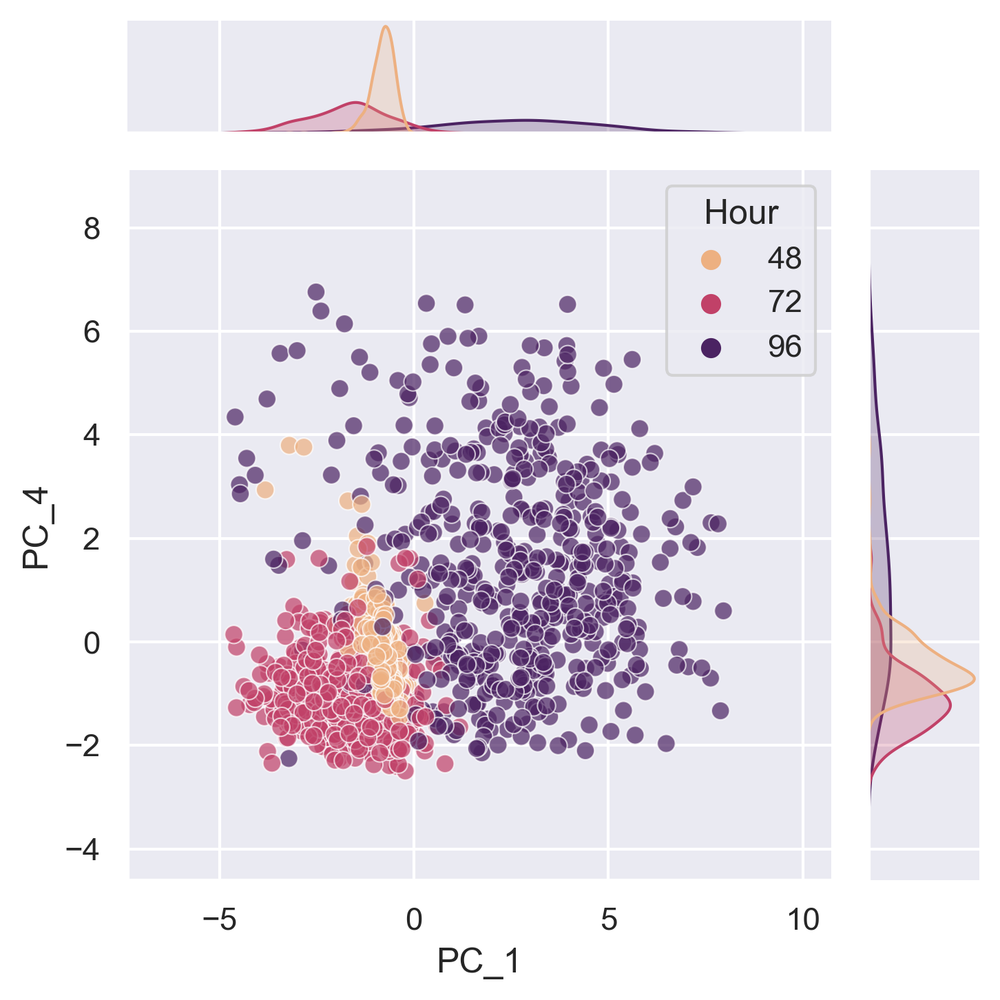

In [60]:
sns.jointplot(filter_outliers_quantile(pca_df_intensity,columns=["PC_1","PC_4"]),x="PC_1",y="PC_4",hue="Hour",palette="flare", **{"alpha":0.7,"s":40},height=5)

plt.tight_layout()
plt.savefig(f"{out_fig_1}/PCA Plot PC1&4 Brachyury.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


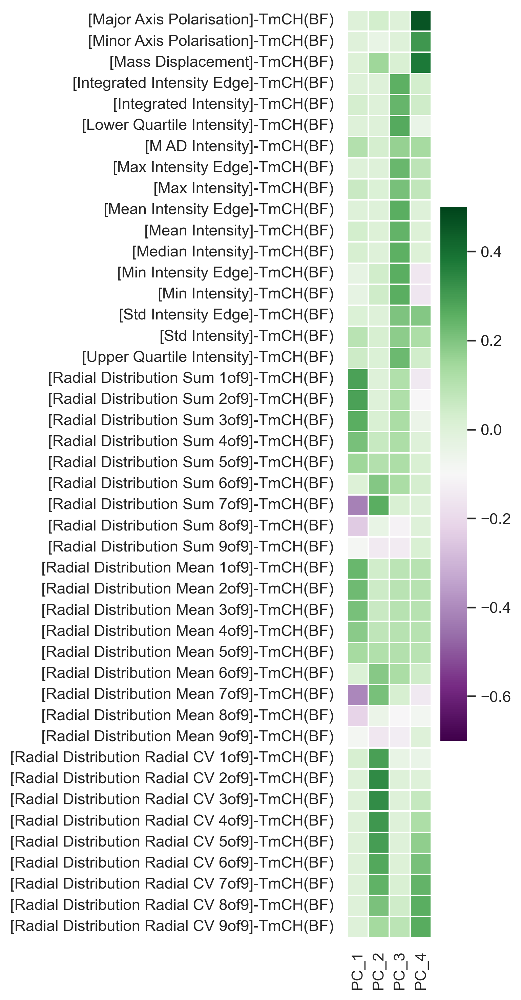

In [61]:
fig,ax = plt.subplots(1,1,figsize=(4,10))
transformerloadings_int = pd.DataFrame(
        transformer_intensity.components_.T, 
        columns=[f'PC_{i+1}' for i in range(4)], 
        index=selected_intensity_feats.rename(columns=intensity_name_mapping).drop("Hour",axis=1).columns
)

sns.heatmap(transformerloadings_int, cmap = "PRGn",vmin=-0.7, vmax=0.5, xticklabels='auto', yticklabels='auto', ax=ax,linewidths=0.5,square=True)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1}/PCA Loadings PC1-4 Brachyury.pdf", format="pdf", bbox_inches="tight")
plt.show()

In [62]:
quantiles_upper_int = np.quantile(transformerloadings_int,0.95,axis=0)
quantiles_lower_int = np.quantile(transformerloadings_int,0.05,axis=0)
main_contributers_int = [
    key for key in transformerloadings_int.index if (
        any(
            [
                transformerloadings_int.loc[key][i]>quantiles_upper_int[i] 
                or transformerloadings_int.loc[key][i]<quantiles_lower_int[i] 
                for i in range(len(transformerloadings_int.columns))
            ]
        )
    )
]

main_contributers_int

['[Major Axis Polarisation]-TmCH(BF)',
 '[Minor Axis Polarisation]-TmCH(BF)',
 '[Mass Displacement]-TmCH(BF)',
 '[Lower Quartile Intensity]-TmCH(BF)',
 '[Mean Intensity Edge]-TmCH(BF)',
 '[Min Intensity Edge]-TmCH(BF)',
 '[Min Intensity]-TmCH(BF)',
 '[Radial Distribution Sum 1of9]-TmCH(BF)',
 '[Radial Distribution Sum 2of9]-TmCH(BF)',
 '[Radial Distribution Sum 3of9]-TmCH(BF)',
 '[Radial Distribution Sum 7of9]-TmCH(BF)',
 '[Radial Distribution Sum 8of9]-TmCH(BF)',
 '[Radial Distribution Sum 9of9]-TmCH(BF)',
 '[Radial Distribution Mean 7of9]-TmCH(BF)',
 '[Radial Distribution Mean 8of9]-TmCH(BF)',
 '[Radial Distribution Mean 9of9]-TmCH(BF)',
 '[Radial Distribution Radial CV 2of9]-TmCH(BF)',
 '[Radial Distribution Radial CV 3of9]-TmCH(BF)',
 '[Radial Distribution Radial CV 4of9]-TmCH(BF)']

meta NOT subset; don't know how to subset; dropped


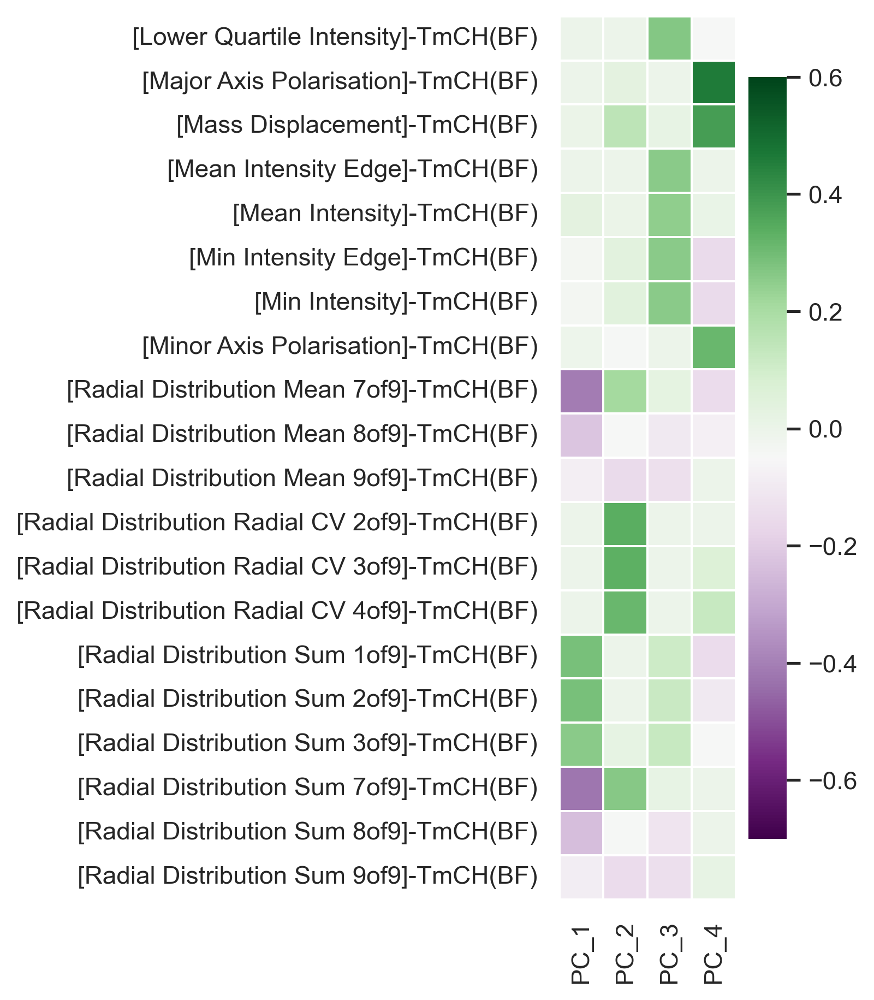

In [63]:
fig,ax = plt.subplots(1,1,figsize=(2,7))
sns.heatmap(transformerloadings_int.loc[sorted(["[Mean Intensity]-TmCH(BF)"]+main_contributers_int)], cmap = "PRGn",vmin=-0.7, vmax=0.6, xticklabels='auto', yticklabels='auto', ax=ax,linewidths=0.5,square=True)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1_supp}/PCA Loadings PC1-4 0.5 quant Intensity.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


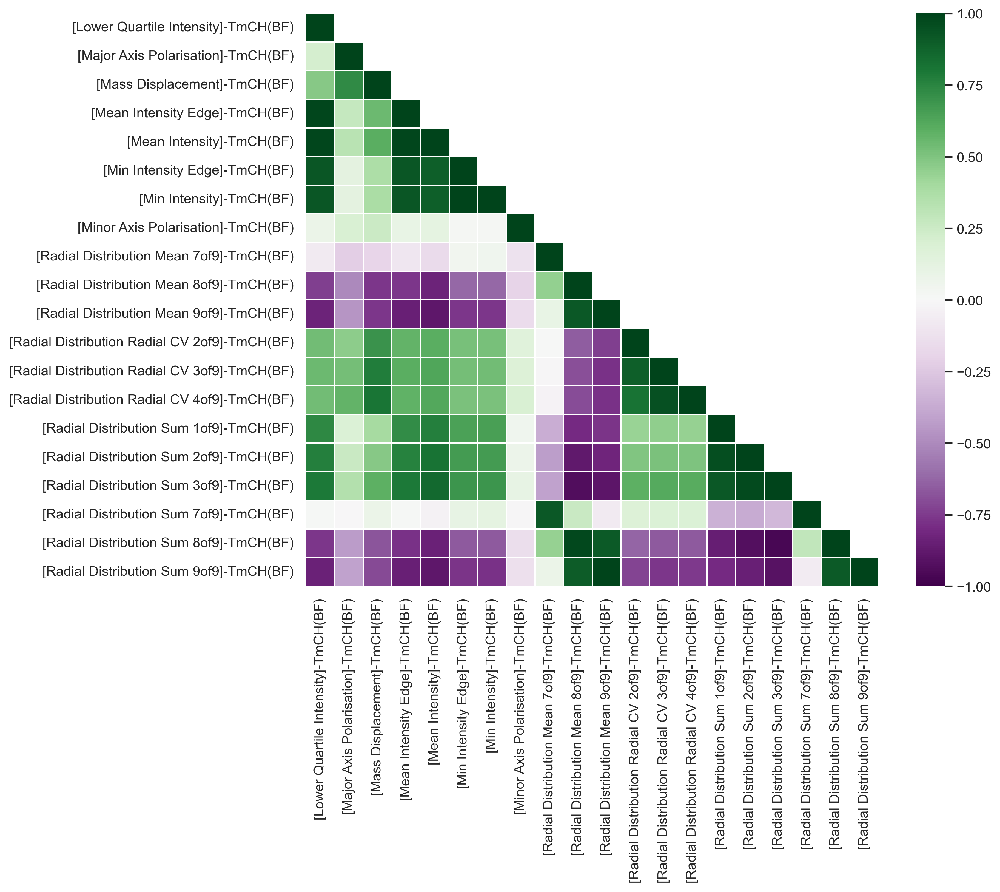

In [64]:
correlation_frame_int_5quant = stacked_intensity.drop(
    ["Hour","Run","Plate","ID"],axis=1
).rename(
    columns=intensity_name_mapping
)[sorted(["[Mean Intensity]-TmCH(BF)"]+main_contributers_int)].corr()

fig,ax = plt.subplots(1,1,figsize = (12,10))

mask_int_5quant = np.ones(correlation_frame_int_5quant.shape, dtype= bool)
mask_int_5quant = np.triu(mask_int_5quant, k = 1)

sns.heatmap(correlation_frame_int_5quant, cmap = "PRGn",vmin=-1, vmax=1, xticklabels='auto', yticklabels='auto', mask=mask_int_5quant, ax=ax,linewidths=0.5,square=True)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1_supp}/Correlation Plot Brachyury 0.5 quantile feats .pdf", format="pdf", bbox_inches="tight")
plt.show()

In [47]:
transformerloadings_int.index

Index(['[Major Axis Polarisation]-TmCH(BF)',
       '[Minor Axis Polarisation]-TmCH(BF)', '[Mass Displacement]-TmCH(BF)',
       '[Integrated Intensity Edge]-TmCH(BF)',
       '[Integrated Intensity]-TmCH(BF)',
       '[Lower Quartile Intensity]-TmCH(BF)', '[M AD Intensity]-TmCH(BF)',
       '[Max Intensity Edge]-TmCH(BF)', '[Max Intensity]-TmCH(BF)',
       '[Mean Intensity Edge]-TmCH(BF)', '[Mean Intensity]-TmCH(BF)',
       '[Median Intensity]-TmCH(BF)', '[Min Intensity Edge]-TmCH(BF)',
       '[Min Intensity]-TmCH(BF)', '[Std Intensity Edge]-TmCH(BF)',
       '[Std Intensity]-TmCH(BF)', '[Upper Quartile Intensity]-TmCH(BF)',
       '[Radial Distribution Sum 1of9]-TmCH(BF)',
       '[Radial Distribution Sum 2of9]-TmCH(BF)',
       '[Radial Distribution Sum 3of9]-TmCH(BF)',
       '[Radial Distribution Sum 4of9]-TmCH(BF)',
       '[Radial Distribution Sum 5of9]-TmCH(BF)',
       '[Radial Distribution Sum 6of9]-TmCH(BF)',
       '[Radial Distribution Sum 7of9]-TmCH(BF)',
       '[Radi

meta NOT subset; don't know how to subset; dropped


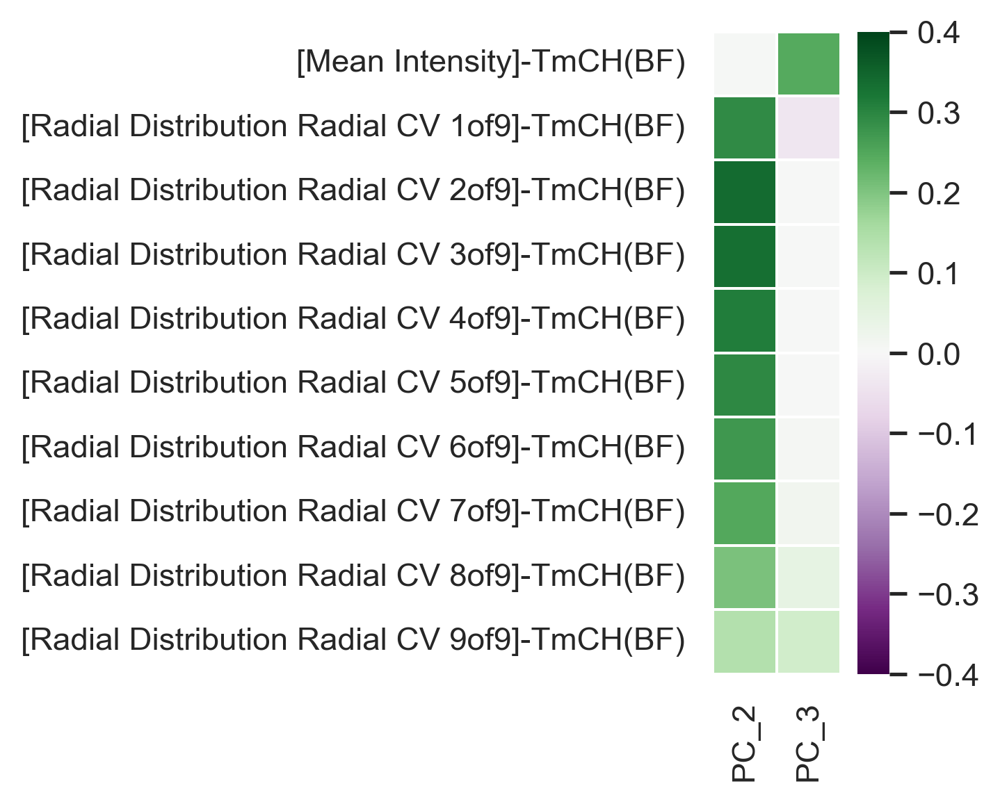

In [48]:
keys_int_fig_1 = [
    '[Mean Intensity]-TmCH(BF)',
    '[Radial Distribution Radial CV 1of9]-TmCH(BF)',
    '[Radial Distribution Radial CV 2of9]-TmCH(BF)',
    '[Radial Distribution Radial CV 3of9]-TmCH(BF)',
    '[Radial Distribution Radial CV 4of9]-TmCH(BF)',
    '[Radial Distribution Radial CV 5of9]-TmCH(BF)',
    '[Radial Distribution Radial CV 6of9]-TmCH(BF)',
    '[Radial Distribution Radial CV 7of9]-TmCH(BF)',
    '[Radial Distribution Radial CV 8of9]-TmCH(BF)',
    '[Radial Distribution Radial CV 9of9]-TmCH(BF)'
]

fig,ax = plt.subplots(1,1,figsize=(2,4))
sns.heatmap(transformerloadings_int[["PC_2","PC_3"]].loc[sorted(keys_int_fig_1)], cmap = "PRGn",vmin=-0.4, vmax=0.4, xticklabels='auto', yticklabels='auto', ax=ax,linewidths=0.5,square=True)
ax.set_facecolor('white')

plt.tight_layout()
plt.savefig(f"{out_fig_1}/figure 1 PCA Loadings PC2&3 features.pdf", format="pdf", bbox_inches="tight")
plt.show()

In [49]:
mean_frac_feats = stacked_intensity[["Run","Plate","ID","Hour"]+[key for key in selected_intensity_feats.keys() if "MeanFrac" in key]].dropna()
mean_frac_feats

,Run,Plate,ID,Hour,raw_CH__bf_mask_RadialDistribution_MeanFrac_1of9,raw_CH__bf_mask_RadialDistribution_MeanFrac_2of9,raw_CH__bf_mask_RadialDistribution_MeanFrac_3of9,raw_CH__bf_mask_RadialDistribution_MeanFrac_4of9,raw_CH__bf_mask_RadialDistribution_MeanFrac_5of9,raw_CH__bf_mask_RadialDistribution_MeanFrac_6of9,raw_CH__bf_mask_RadialDistribution_MeanFrac_7of9,raw_CH__bf_mask_RadialDistribution_MeanFrac_8of9,raw_CH__bf_mask_RadialDistribution_MeanFrac_9of9
0,RR,1,A1,48,1.006025,1.005816,1.006726,1.003745,1.003870,1.001386,1.005981,1.007929,0.980798
1,RR,1,A2,48,1.005666,0.997871,1.008272,1.004589,1.007309,1.006035,1.007040,1.002661,0.980695
2,RR,1,A3,48,1.009470,1.004743,1.001329,1.003508,1.001250,1.000686,1.006848,1.008436,0.983060
3,RR,1,A4,48,1.002323,1.003848,1.007757,1.004151,1.005075,1.005568,1.008757,1.007292,0.976263
4,RR,1,A5,48,0.995509,1.001472,0.999883,1.001452,0.998802,0.999895,1.008273,1.009335,0.985327
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2296,TR,2,H8,96,1.512014,1.492214,1.430833,1.334899,1.215683,1.107399,0.998181,0.858230,0.645591
2297,TR,2,H9,96,1.591572,1.569688,1.516788,1.388192,1.229863,1.121291,1.016165,0.839298,0.616222
2298,TR,2,H10,96,1.521499,1.506348,1.471568,1.409264,1.288146,1.132448,0.984756,0.831435,0.615006
2299,TR,2,H11,96,1.473126,1.454181,1.422392,1.328618,1.255991,1.162664,1.022226,0.856647,0.643825


In [50]:
indexed = mean_frac_feats.set_index(["Hour","Run","Plate","ID"])
grouped_hour = indexed.groupby(["Run"])

out = []
for group,idx in grouped_hour.groups.items():
    df = indexed.loc[idx]
    df_np = df.to_numpy()
    scaled =  (df_np - df_np.min()) / df_np.max()
    out.append(pd.DataFrame(scaled, columns = df.columns, index =df.index))

mean_frac_scaled = pd.concat(out,axis=0)
mean_frac_scaled

raw_CH__bf_mask_RadialDistribution_MeanFrac_1of9  \
Hour Run Plate ID                                                      
48   RR  1     A1                                           0.253310   
               A2                                           0.253120   
               A3                                           0.255133   
               A4                                           0.251352   
               A5                                           0.247746   
...                                                              ...   
96   TR  2     H8                                           0.542540   
               H9                                           0.586715   
               H10                                          0.547807   
               H11                                          0.520947   
               H12                                          0.566577   

                    raw_CH__bf_mask_RadialDistribution_MeanFrac_2of9  \
Hour Run Plate ID                                                      
48   RR  1     A1                                           0.253200   
               A2                                           0.248996   
               A3                                           0.252632   
               A4                                           0.252158   
               A5                                           0.250901   
...                                                              ...   
96   TR  2     H8                                           0.531546   
               H9                                           0.574564   
               H10                                          0.539394   
               H11                                          0.510428   
               H12                                          0.544880   

                    raw_CH__bf_mask_RadialDistribution_MeanFrac_3of9  \
Hour Run Plate ID                                                      
48   RR  1     A1                                           0.253681   
               A2                                           0.254499   
               A3                                           0.250826   
               A4                                           0.254227   
               A5                                           0.250060   
...                                                              ...   
96   TR  2     H8                                           0.497464   
               H9                                           0.545191   
               H10                                          0.520082   
               H11                                          0.492777   
               H12                                          0.504710   

                    raw_CH__bf_mask_RadialDistribution_MeanFrac_4of9  \
Hour Run Plate ID                                                      
48   RR  1     A1                                           0.252104   
               A2                                           0.252551   
               A3                                           0.251978   
               A4                                           0.252319   
               A5                                           0.250891   
...                                                              ...   
96   TR  2     H8                                           0.444197   
               H9                                           0.473788   
               H10                                          0.485488   
               H11                                          0.440709   
               H12                                          0.456997   

                    raw_CH__bf_mask_RadialDistribution_MeanFrac_5of9  \
Hour Run Plate ID                                                      
48   RR  1     A1                                           0.252170   
               A2                                       

In [51]:
means = {}
stddevs = {}

grouped_hour = mean_frac_scaled.groupby(["Hour"])

for group,idx in grouped_hour.groups.items():
    df = indexed.loc[idx]
    means[group]   = np.array(df.mean())
    stddevs[group] = np.array(df.std())

means

{48: array([1.00317233, 1.00364647, 1.00324564, 1.00353809, 1.0037714 ,
        1.00473757, 1.00826275, 1.00507691, 0.98103069]),
 72: array([1.03755807, 1.04162362, 1.04823889, 1.05600255, 1.05989261,
        1.05988789, 1.04969258, 0.99486779, 0.85521213]),
 96: array([1.44279532, 1.432646  , 1.40535104, 1.34897624, 1.25806536,
        1.14099334, 1.00436279, 0.83864877, 0.63853277])}

[0.    0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.   ]
[0.    0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.   ]
[0.    0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.   ]


meta NOT subset; don't know how to subset; dropped


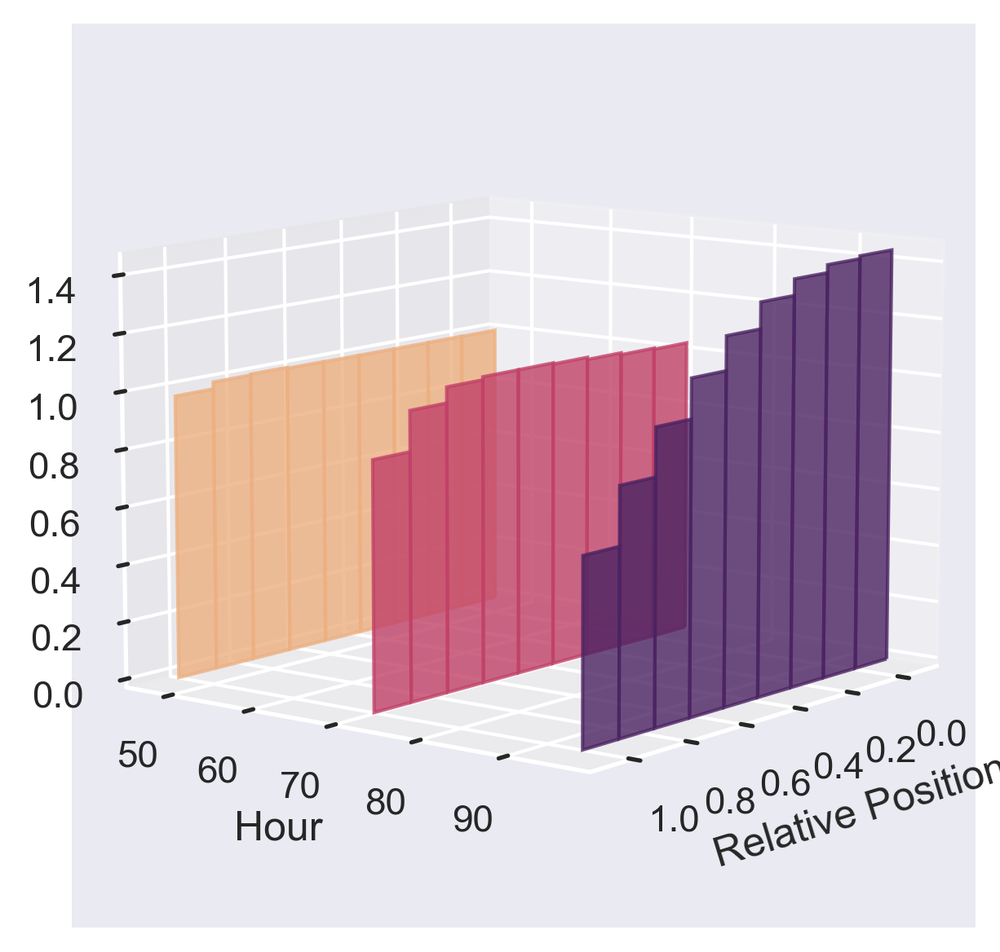

In [52]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib import colormaps
import numpy as np

cmap = colormaps["flare"]

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
nbins = 50
for c_idx, hour_str in zip([0.,0.5,1.], [48,72,96]):
    mean_vals = means[hour_str]
    c = cmap(c_idx)

    xs = np.linspace(0,1,9)
    print(xs)
    ax.bar(xs, mean_vals, zs=int(hour_str),width= 0.125, zdir='y', color=c, ec=c, alpha=0.8)

ax.set_xlabel('Relative Position')
ax.set_ylabel('Hour')
ax.set_zlabel('Intensity')
ax.view_init(10, 38)


plt.savefig(f"{out_fig_1}/Radial Distribution Brachyury.pdf", format="pdf", bbox_inches="tight")
plt.show()

meta NOT subset; don't know how to subset; dropped


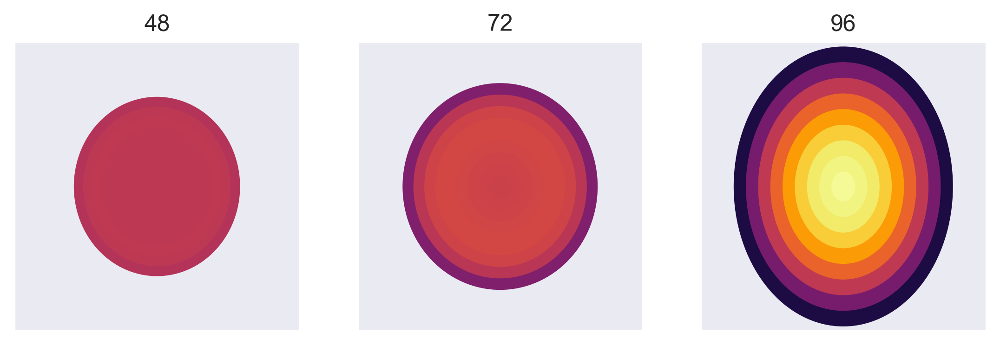

In [53]:
from matplotlib.patches import Ellipse

cmap_egg = colormaps["inferno"]

df = pd.concat(
    [
        mean_frac_scaled,stacked_raw_data[['str_BF_AreaShape_minor_axis_length','str_BF_AreaShape_major_axis_length']+["Hour","Run","Plate","ID"]].rename(
            columns={"hour":"Hour"}
        ).set_index(["Hour","Run","Plate","ID"])
    ],
    axis=1
).reset_index().dropna()
dist_keys = [key for key in selected_intensity_feats.keys() if "MeanFrac" in key]
gt_keys = ["Hour","Run","Plate","ID"]


def make_radial_dist_patches(df,dist_keys,factorintensity = 0.5, factor_axes= 420):
    df = df.median()
    dist_np = df[dist_keys].to_numpy()
    dist_vals = dist_np/factorintensity
    in_ax_length = df[['str_BF_AreaShape_minor_axis_length','str_BF_AreaShape_major_axis_length']].to_numpy()/factor_axes
    inside_axis_concentric = [i*in_ax_length for i in np.flip(np.linspace(0.1,1,9,))]
    circles_bra = [Ellipse((0.5, 0.5), width = rad[0], height = rad[1], color=cmap_egg(val)) for val,rad in zip(np.flip(dist_vals),inside_axis_concentric)]
    
    return circles_bra

fig, axs = plt.subplots(1,3,figsize = (9,2.7))

for ax,subset in zip(axs,[48,72,96]):
    ellipses = make_radial_dist_patches(
        df[df["Hour"]==subset].drop(gt_keys,axis=1),
        dist_keys
    )

    for circle in ellipses:
        ax.add_patch(circle)
        ax.set_xticks([])
        ax.set_yticks([])

    ax.set_title(subset)


plt.savefig(f"{out_fig_1}/Distribution eggs.pdf", format="pdf", bbox_inches="tight")

meta NOT subset; don't know how to subset; dropped


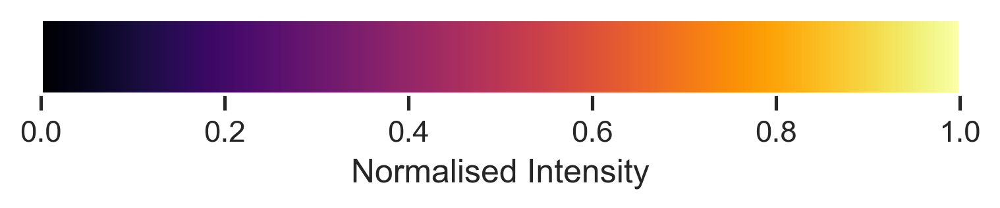

In [54]:
fig, ax = plt.subplots(figsize=(6, 1))
fig.subplots_adjust(bottom=0.5)

norm = mpl.colors.Normalize(vmin=0., vmax=1)

cb1 = mpl.colorbar.ColorbarBase(ax, cmap=cmap_egg,
                                norm=norm,
                                orientation='horizontal')
cb1.set_label('Normalised Intensity')
fig.show()
plt.savefig(f"{out_fig_1}/distribution colorbar eggs.pdf", format="pdf", bbox_inches="tight")

[0.    0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.   ]
[0.    0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.   ]
[0.    0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.   ]


meta NOT subset; don't know how to subset; dropped


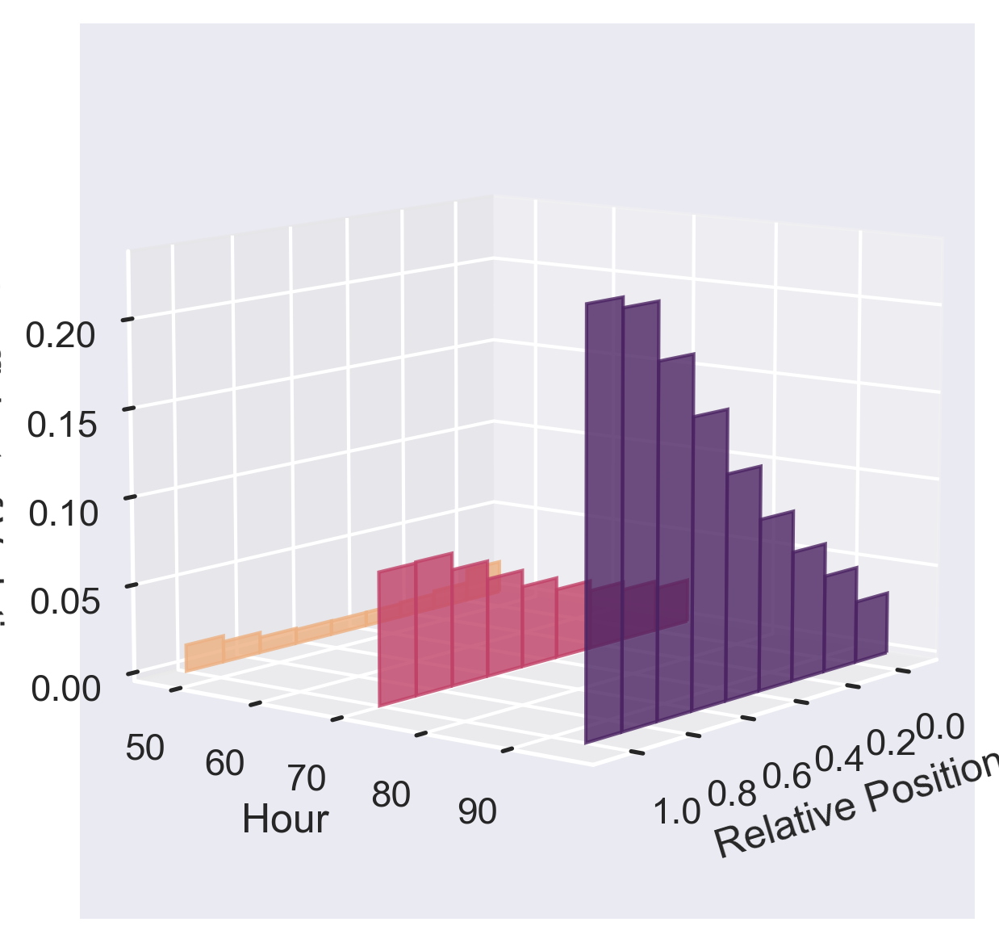

In [55]:
radial_CV_feats = stacked_intensity[["Hour","Run","Plate","ID"]+[key for key in selected_intensity_feats.keys() if "RadialCV" in key]].dropna()

indexed = radial_CV_feats.set_index(["Hour","Run","Plate","ID"])
grouped_run = indexed.groupby(["Run"])

out = []
for group,idx in grouped_run.groups.items():
    df = indexed.loc[idx]
    df_np = df.to_numpy()
    scaled =  (df_np - df_np.min()) / df_np.max()
    out.append(pd.DataFrame(scaled, columns = df.columns, index =df.index))

radial_cv_scaled = pd.concat(out,axis=0)    

means = {}
stddevs = {}
grouped_hour = radial_cv_scaled.groupby(["Hour"])

for group,idx in grouped_hour.groups.items():
    df = indexed.loc[idx]
    means[group]   = np.array(df.mean())
    stddevs[group] = np.array(df.std())

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
nbins = 50
for c_idx, hour_str in zip([0.,0.5,1.], [48,72,96]):
    mean_vals = means[hour_str]
    c = cmap(c_idx)

    xs = np.linspace(0,1,9)
    print(xs)
    ax.bar(xs, mean_vals, zs=int(hour_str),width= 0.125, zdir='y', color=c, ec=c, alpha=0.8)

ax.set_xlabel('Relative Position')
ax.set_ylabel('Hour')
ax.set_zlabel('Coefficient of Variation')
ax.view_init(10, 38)


plt.savefig(f"{out_fig_1}/Radial Distribution CV Brachyury.pdf", format="pdf", bbox_inches="tight")
plt.show()

In [56]:
means

{48: array([0.0183989 , 0.01041121, 0.00850392, 0.00778409, 0.00774359,
        0.00794517, 0.00870748, 0.01151216, 0.01493662]),
 72: array([0.02460892, 0.02896895, 0.03340919, 0.03918425, 0.04586942,
        0.05517405, 0.06540351, 0.07472994, 0.07406383]),
 96: array([0.03465814, 0.05438655, 0.07287657, 0.0960145 , 0.12570594,
        0.16130297, 0.19528745, 0.22735955, 0.23300554])}

raw_CH__bf_mask_RadialDistribution_RadialCV_1of9    0.017754
raw_CH__bf_mask_RadialDistribution_RadialCV_2of9    0.009766
raw_CH__bf_mask_RadialDistribution_RadialCV_3of9    0.007809
raw_CH__bf_mask_RadialDistribution_RadialCV_4of9    0.006783
raw_CH__bf_mask_RadialDistribution_RadialCV_5of9    0.006329
raw_CH__bf_mask_RadialDistribution_RadialCV_6of9    0.006424
raw_CH__bf_mask_RadialDistribution_RadialCV_7of9    0.007002
raw_CH__bf_mask_RadialDistribution_RadialCV_8of9    0.009139
raw_CH__bf_mask_RadialDistribution_RadialCV_9of9    0.012388
dtype: float64
[array([0.57454501, 0.61336305]), array([0.5099087 , 0.54435971]), array([0.44527239, 0.47535636]), array([0.38063607, 0.40635302]), array([0.31599976, 0.33734968]), array([0.25136344, 0.26834633]), array([0.18672713, 0.19934299]), array([0.12209082, 0.13033965]), array([0.0574545, 0.0613363])]
raw_CH__bf_mask_RadialDistribution_RadialCV_1of9    0.022664
raw_CH__bf_mask_RadialDistribution_RadialCV_2of9    0.026957
raw_CH__bf_mask_Ra

meta NOT subset; don't know how to subset; dropped


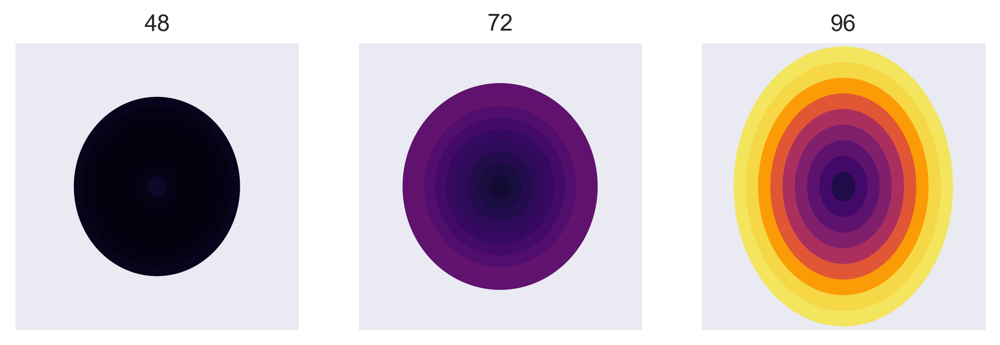

In [57]:
df = pd.concat(
    [
        radial_CV_feats.set_index(["Hour","Run","Plate","ID"]),stacked_raw_data[['str_BF_AreaShape_minor_axis_length','str_BF_AreaShape_major_axis_length']+["Hour","Run","Plate","ID"]].rename(
            columns={"hour":"Hour"}
        ).set_index(["Hour","Run","Plate","ID"])
    ],
    axis=1
).reset_index().dropna()
cv_keys = [key for key in selected_intensity_feats.keys() if "RadialCV" in key]
gt_keys = ["Hour","Run","Plate","ID"]


def make_radial_dist_patches(df,dist_keys,factorintensity = 0.25, factor_axes= 420):
    df = df.median()
    dist_np = df[dist_keys].to_numpy()
    dist_vals = dist_np/factorintensity
    print(df[dist_keys])
    in_ax_length = df[['str_BF_AreaShape_minor_axis_length','str_BF_AreaShape_major_axis_length']].to_numpy()/factor_axes
    inside_axis_concentric = [i*in_ax_length for i in np.flip(np.linspace(0.1,1,9,))]
    print(inside_axis_concentric)
    circles_bra = [Ellipse((0.5, 0.5), width = rad[0], height = rad[1], color=cmap_egg(val)) for val,rad in zip(np.flip(dist_vals),inside_axis_concentric)]
    
    return circles_bra

fig, axs = plt.subplots(1,3,figsize = (9,2.7))

for ax,subset in zip(axs,[48,72,96]):
    ellipses = make_radial_dist_patches(
        df[df["Hour"]==subset].drop(gt_keys,axis=1),
        cv_keys
    )

    for circle in ellipses:
        ax.add_patch(circle)
        ax.set_xticks([])
        ax.set_yticks([])

    ax.set_title(subset)

plt.savefig(f"{out_fig_1}/CV eggs.pdf", format="pdf", bbox_inches="tight")

meta NOT subset; don't know how to subset; dropped


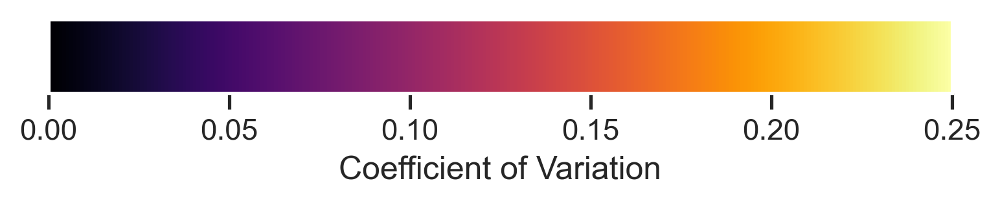

In [58]:
fig, ax = plt.subplots(figsize=(6, 1))
fig.subplots_adjust(bottom=0.5)

norm = mpl.colors.Normalize(vmin=0., vmax=0.25)

cb1 = mpl.colorbar.ColorbarBase(ax, cmap=cmap_egg,
                                norm=norm,
                                orientation='horizontal')
cb1.set_label('Coefficient of Variation')
fig.show()
plt.savefig(f"{out_fig_1}/CV colorbar eggs.pdf", format="pdf", bbox_inches="tight")

In [59]:
stacked_raw_data[['str_BF_AreaShape_minor_axis_length','str_BF_AreaShape_major_axis_length']+["Hour","Run","Plate","ID"]].rename(
            columns={"hour":"Hour"}
        ).set_index(["Hour","Run","Plate","ID"])

str_BF_AreaShape_minor_axis_length  \
Hour Run Plate ID                                        
48   RR  1     A1                           250.611943   
               A2                           240.207294   
               A3                           254.414352   
               A4                           237.791331   
               A5                           246.391674   
...                                                ...   
96   TR  2     H8                           344.275119   
               H9                           354.186991   
               H10                          372.702320   
               H11                          313.643540   
               H12                          352.110634   

                    str_BF_AreaShape_major_axis_length  
Hour Run Plate ID                                       
48   RR  1     A1                           264.021242  
               A2                           244.496177  
               A3                           277.076512  
               A4                           251.374987  
               A5                           260.627476  
...                                                ...  
96   TR  2     H8                           435.826496  
               H9                           468.535501  
               H10                          447.181922  
               H11                          506.264752  
               H12                          459.440398  

[2301 rows x 2 columns]

In [60]:
remaining_intensity_keys = [key for key in selected_intensity_feats.keys() if "RadialDistribution" not in key and "Hour" not in key]
remaining_intensity_keys

['str_CH_AreaShape_Bra_MajorAxis_Polarisation',
 'str_CH_AreaShape_Bra_MinorAxis_Polarisation',
 'raw_CH__bf_mask_Intensity_MassDisplacement',
 'raw_CH__bf_mask_Intensity_IntegratedIntensityEdge',
 'raw_CH__bf_mask_Intensity_IntegratedIntensity',
 'raw_CH__bf_mask_Intensity_LowerQuartileIntensity',
 'raw_CH__bf_mask_Intensity_MADIntensity',
 'raw_CH__bf_mask_Intensity_MaxIntensityEdge',
 'raw_CH__bf_mask_Intensity_MaxIntensity',
 'raw_CH__bf_mask_Intensity_MeanIntensityEdge',
 'raw_CH__bf_mask_Intensity_MeanIntensity',
 'raw_CH__bf_mask_Intensity_MedianIntensity',
 'raw_CH__bf_mask_Intensity_MinIntensityEdge',
 'raw_CH__bf_mask_Intensity_MinIntensity',
 'raw_CH__bf_mask_Intensity_StdIntensityEdge',
 'raw_CH__bf_mask_Intensity_StdIntensity',
 'raw_CH__bf_mask_Intensity_UpperQuartileIntensity']

In [61]:
interested_feats = [
    'raw_CH__bf_mask_Intensity_IntegratedIntensity',
    'raw_CH__bf_mask_Intensity_MADIntensity',
    'raw_CH__bf_mask_Intensity_MassDisplacement',
    'raw_CH__bf_mask_Intensity_MaxIntensity',
    'raw_CH__bf_mask_Intensity_MeanIntensity',
    'raw_CH__bf_mask_Intensity_MinIntensity',
    'raw_CH__bf_mask_Intensity_StdIntensity',
    'str_CH_AreaShape_Bra_MajorAxis_Polarisation',
    'str_CH_AreaShape_Bra_MinorAxis_Polarisation'
]
hours = [48,72,96]
df =selected_intensity_feats[interested_feats+["Hour"]].rename(columns=intensity_name_mapping)


In [62]:
df[df['Hour']==96]

[Integrated Intensity]-TmCH(BF)  [M AD Intensity]-TmCH(BF)  \
Run Plate ID                                                                
RR  1     A1                          2.190070                   0.976365   
          A2                          1.455852                   1.312135   
          A3                          1.784502                   1.404048   
          A4                          2.014170                   1.645994   
          A5                          0.304842                   0.724326   
...                                        ...                        ...   
TR  2     H8                          1.723185                   1.221142   
          H9                          1.861897                   1.863257   
          H10                         2.281729                   1.910241   
          H11                         1.910733                   1.538197   
          H12                         2.652385                   2.312230   

               [Mass Displacement]-TmCH(BF)  [Max Intensity]-TmCH(BF)  \
Run Plate ID                                                            
RR  1     A1                       0.561686                  1.414903   
          A2                       0.742580                  1.452101   
          A3                       1.280662                  1.577645   
          A4                       2.254973                  1.930130   
          A5                       1.034278                  0.504487   
...                                     ...                       ...   
TR  2     H8                       0.169901                  1.619712   
          H9                       1.335807                  2.014532   
          H10                      0.501891                  1.754604   
          H11                     -0.490600                  1.604993   
          H12                     -0.287275                  2.175685   

               [Mean Intensity]-TmCH(BF)  [Min Intensity]-TmCH(BF)  \
Run Plate ID                                                         
RR  1     A1                    1.968277                  1.713478   
          A2                    1.572942                  1.610104   
          A3                    1.736215                  2.343293   
          A4                    1.918038                  0.576337   
          A5                    0.294783                 -0.086337   
...                                  ...                       ...   
TR  2     H8                    1.692948                  1.602655   
          H9                    1.498170                  0.062452   
          H10                   1.822314                  1.420608   
          H11                   1.683728                  2.463167   
          H12                   2.315683                  2.932824   

               [Std Intensity]-TmCH(BF)  [Major Axis Polarisation]-TmCH(BF)  \
Run Plate ID                                                                  
RR  1     A1                   1.417646                            0.446566   
          A2                   1.408338                           -0.382456   
          A3                   1.397886                            1.217072   
          A4                   2.096211                            1.917257   
          A5                   0.741139                            1.072274   
...                                 ...                                 ...   
TR  2     H8                   1.461876                           -0.532642   
          H9                   1.931225                            0.902172   
          H10                  1.850026                           -0.618512   
          H11                  1.374848                           -0.444581   
          H12                  2.203183                           -1.049277   

               [Minor Axis Polarisation]-TmCH(BF)  Hour  
Run Plate ID                                             
RR  1   

meta NOT subset; don't know how to subset; dropped


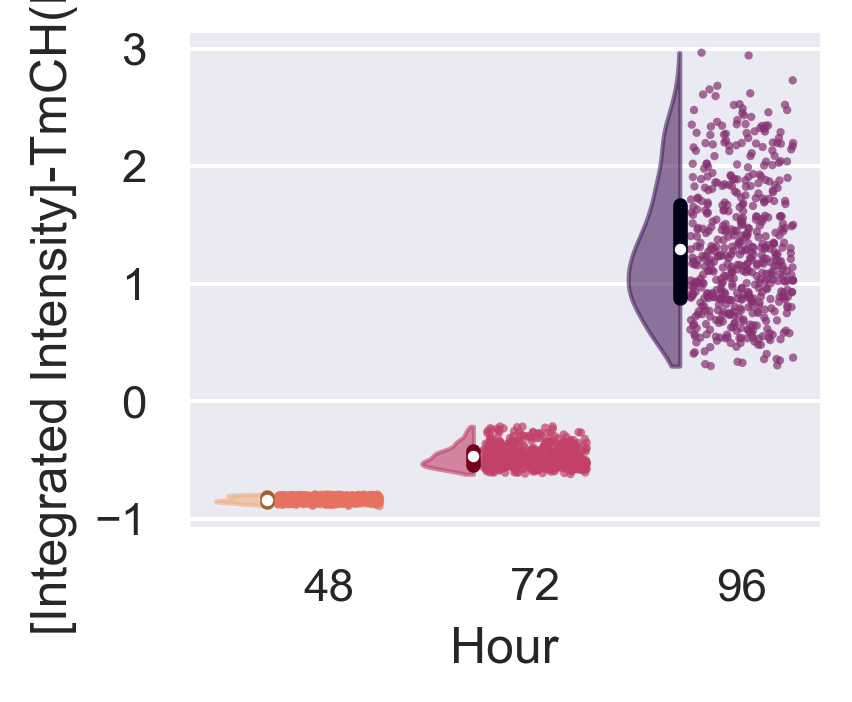

meta NOT subset; don't know how to subset; dropped


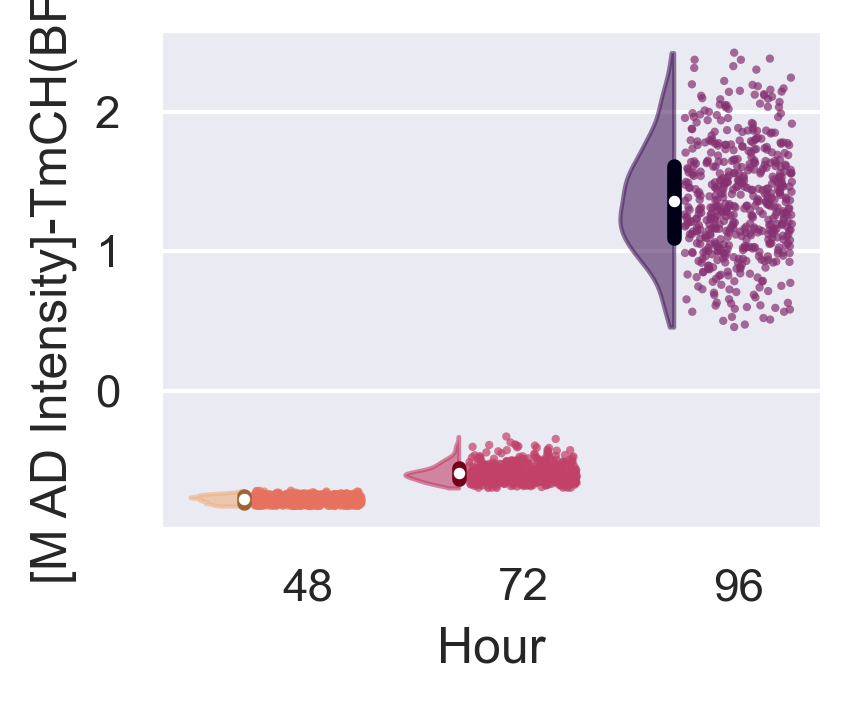

meta NOT subset; don't know how to subset; dropped


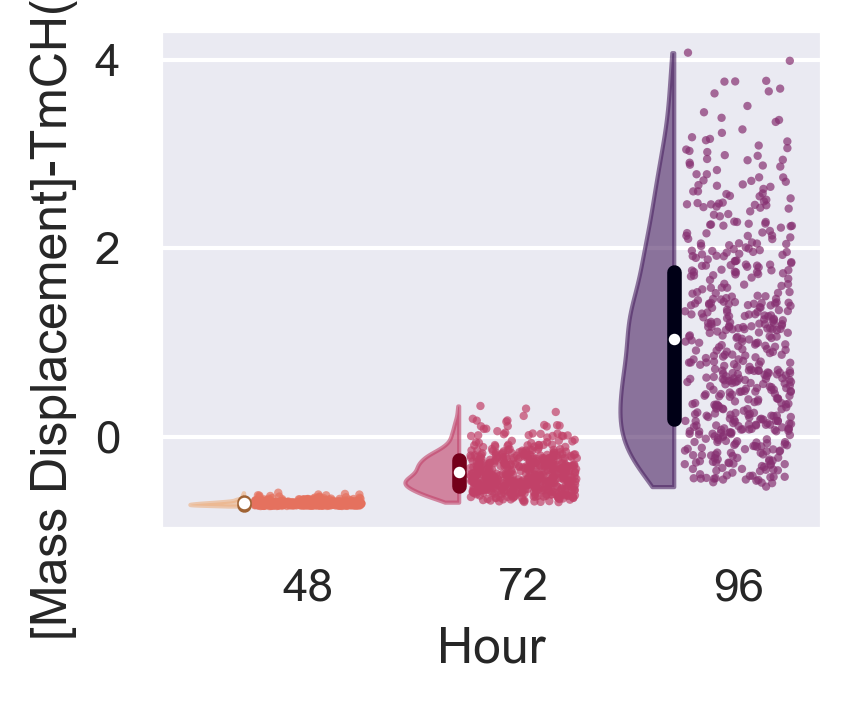

meta NOT subset; don't know how to subset; dropped


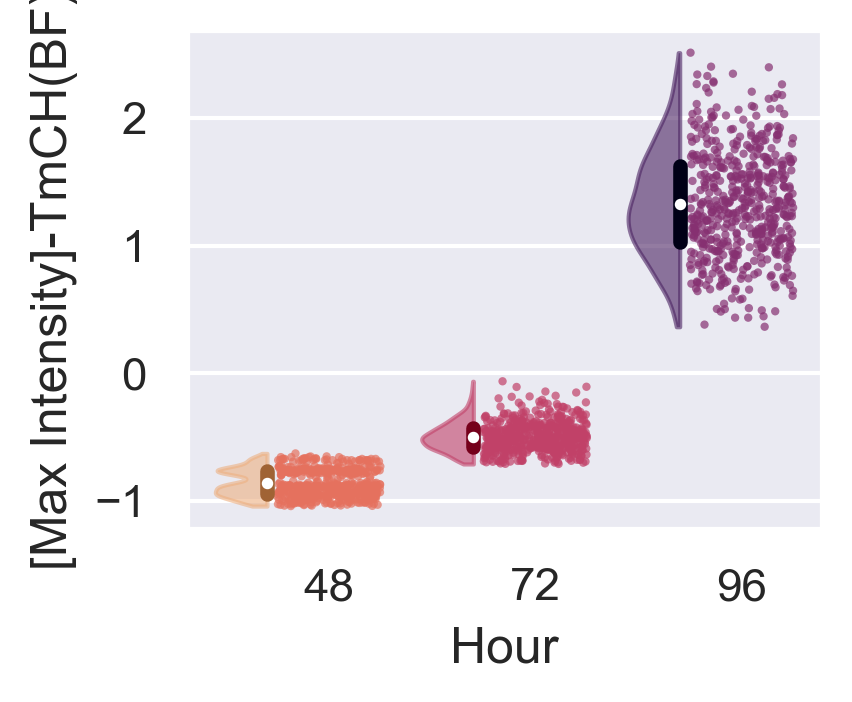

meta NOT subset; don't know how to subset; dropped


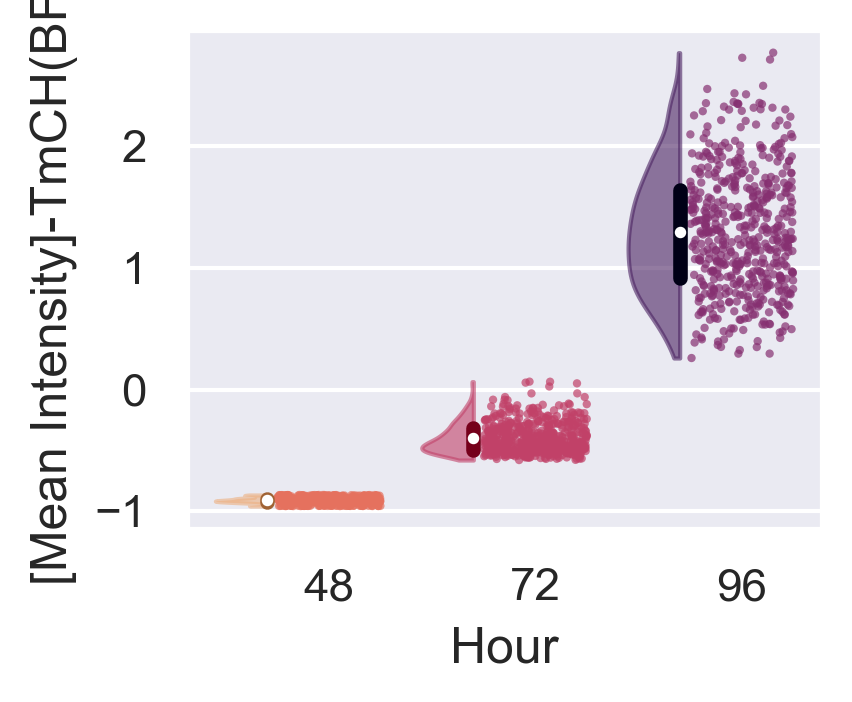

meta NOT subset; don't know how to subset; dropped


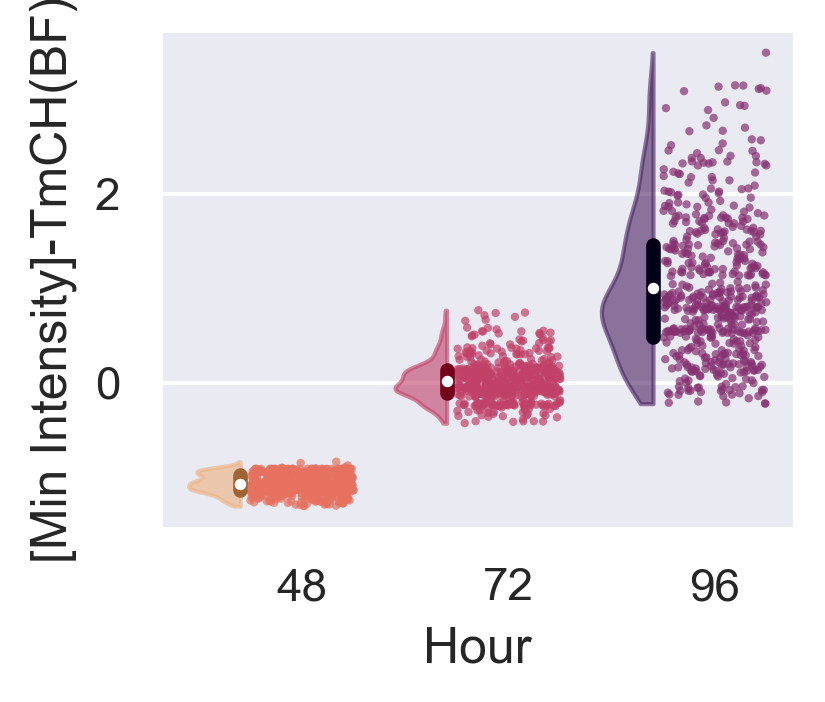

meta NOT subset; don't know how to subset; dropped


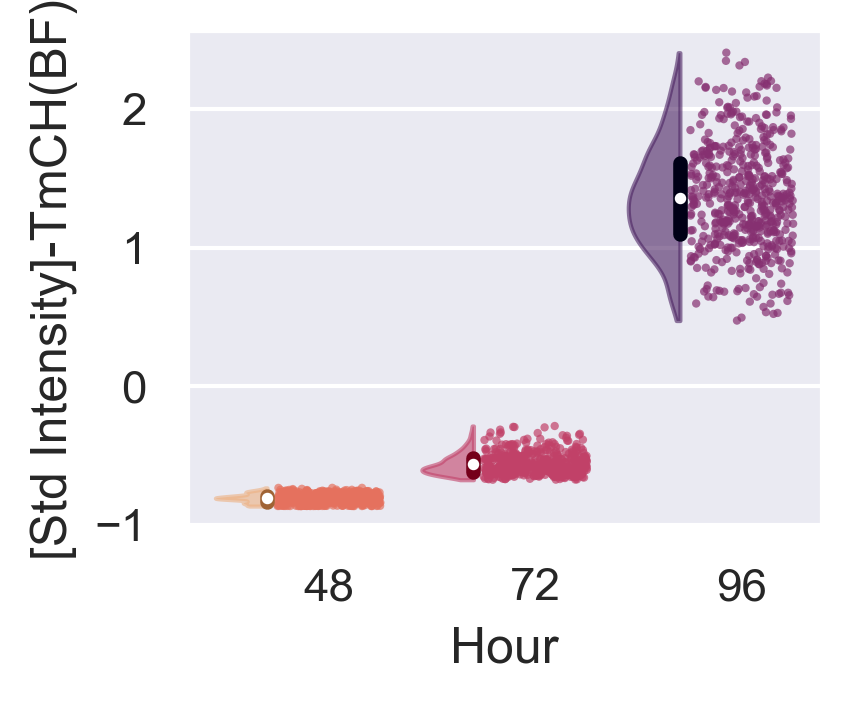

meta NOT subset; don't know how to subset; dropped


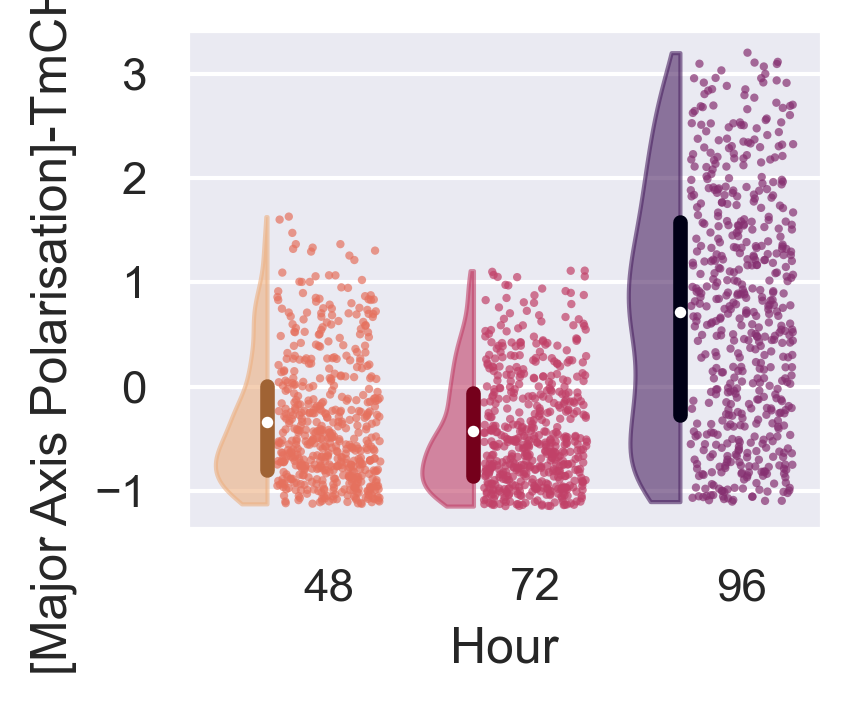

meta NOT subset; don't know how to subset; dropped


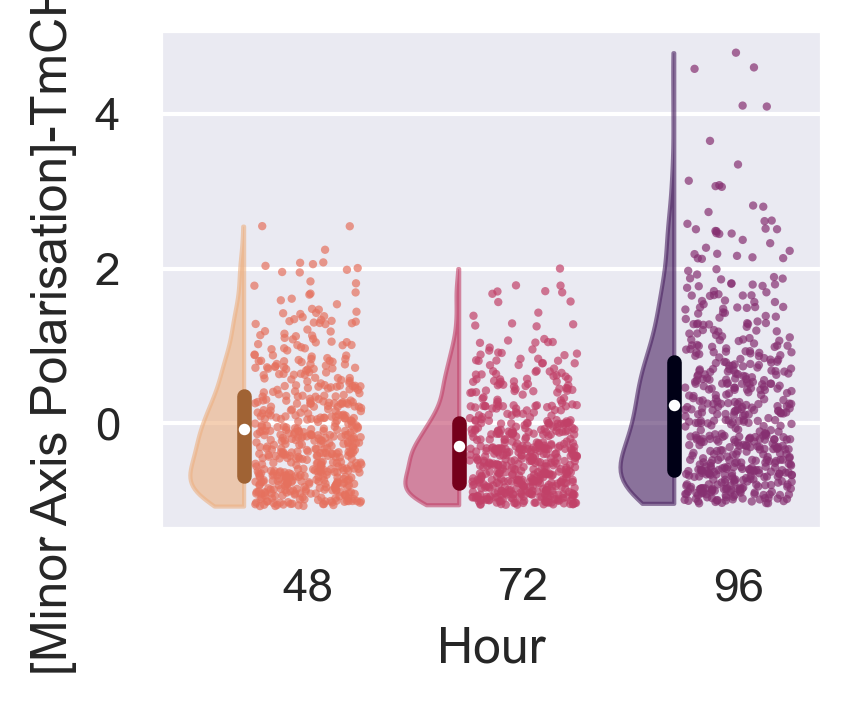

In [63]:
for feature in interested_feats:
    feature = intensity_name_mapping[feature]
    df_filtered = pd.concat([
        filter_outliers_quantile(df[df['Hour']==hour],columns =[feature],quantile=0.01) for hour in hours
    ],axis=0)
    fig, axs = plt.subplots(1, 1,figsize = (3,2.5))
    opp.raincloud_plot(df_filtered,"Hour",feature,ax=axs ,jitter = 0.3,palette = 'flare', quantiles = [0.25,0.75], size_cloud = 2, size_quant = 3.5)
    plt.tight_layout()
    plt.savefig(f"{out_fig_1}/Feature Plots Intensity {feature}.pdf", format="pdf", bbox_inches="tight")
    plt.show()

meta NOT subset; don't know how to subset; dropped


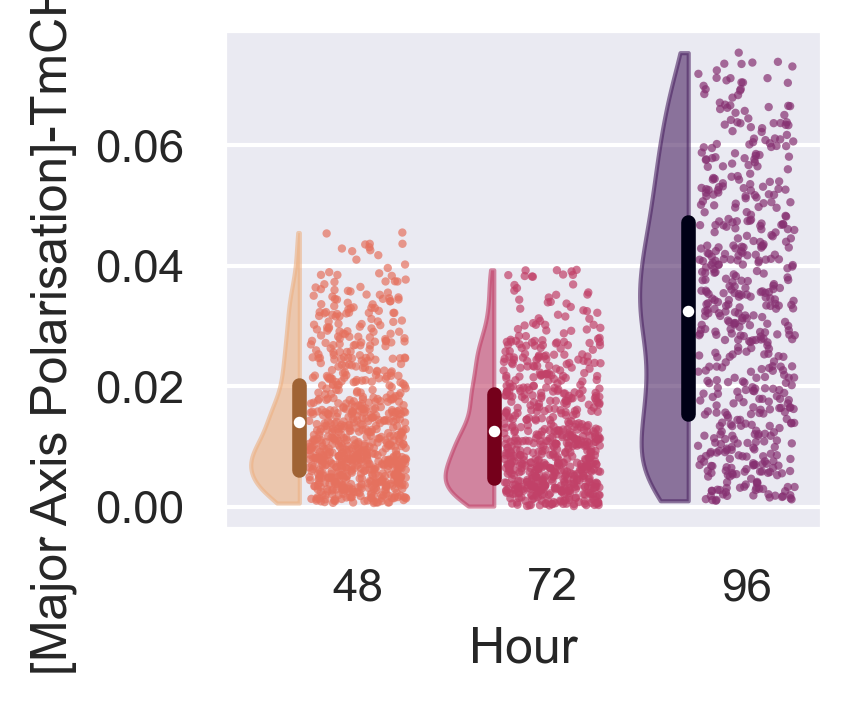

meta NOT subset; don't know how to subset; dropped


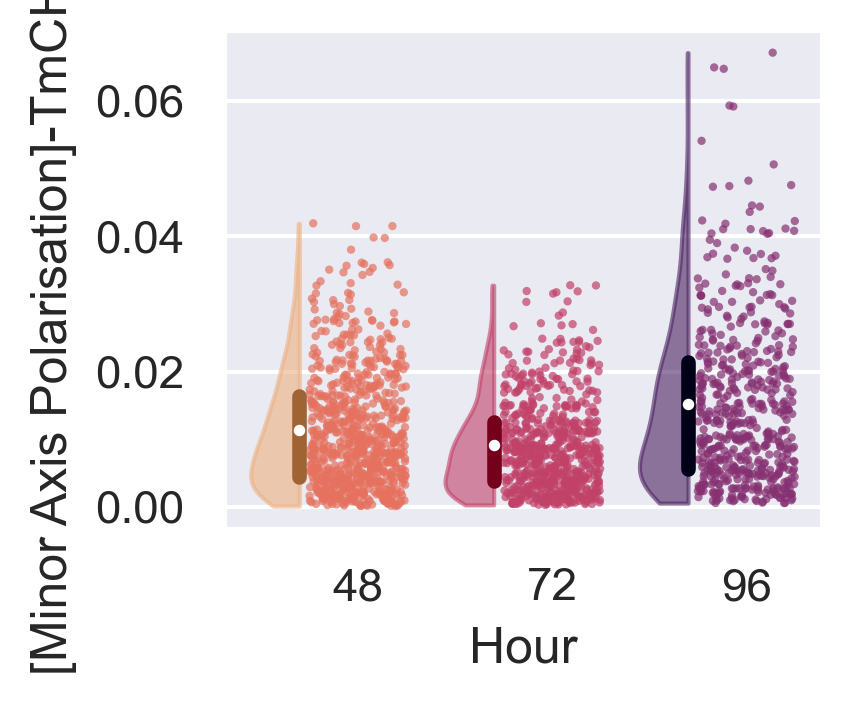

meta NOT subset; don't know how to subset; dropped


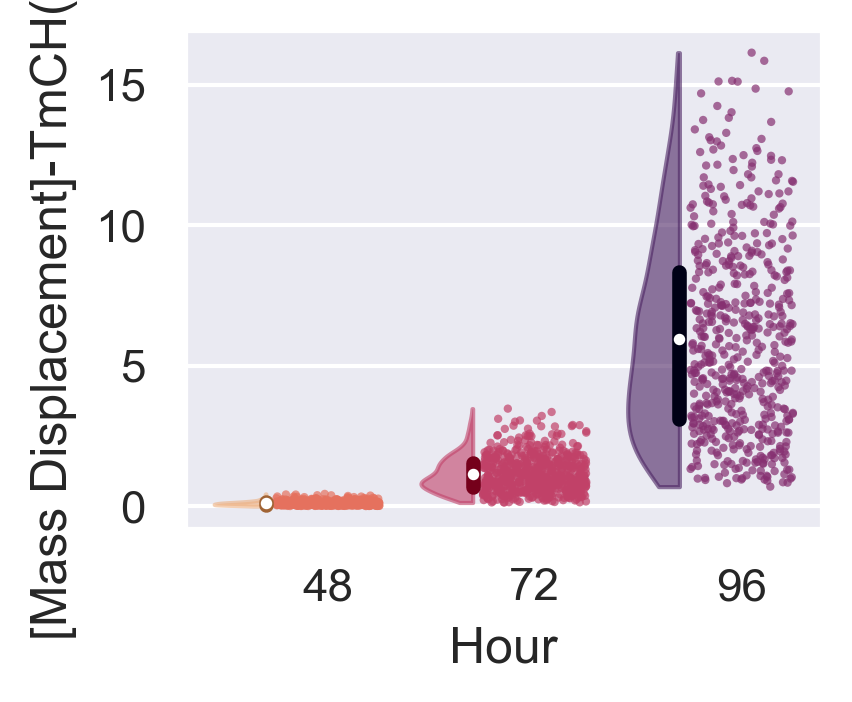

meta NOT subset; don't know how to subset; dropped


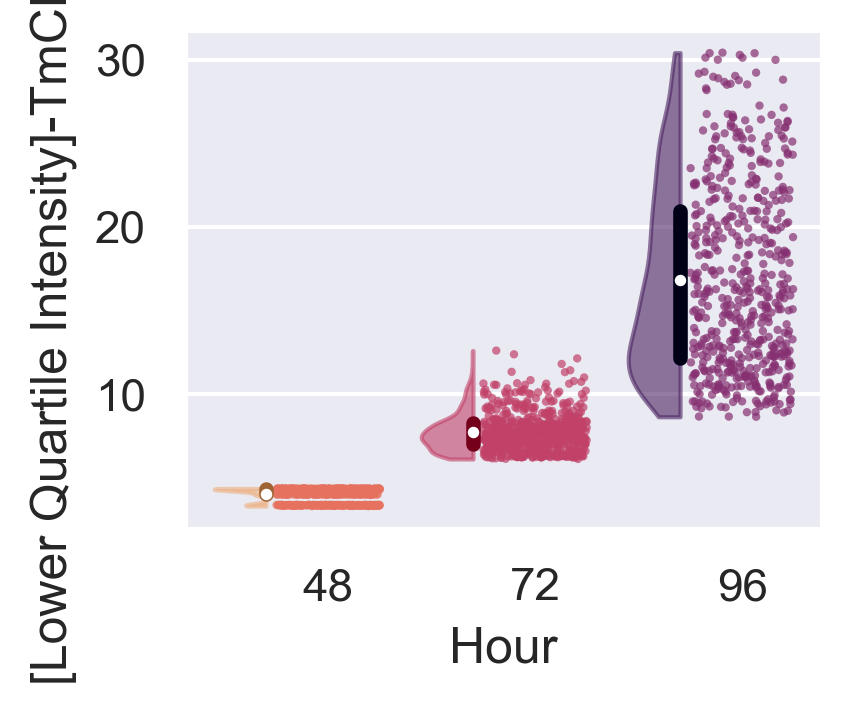

meta NOT subset; don't know how to subset; dropped


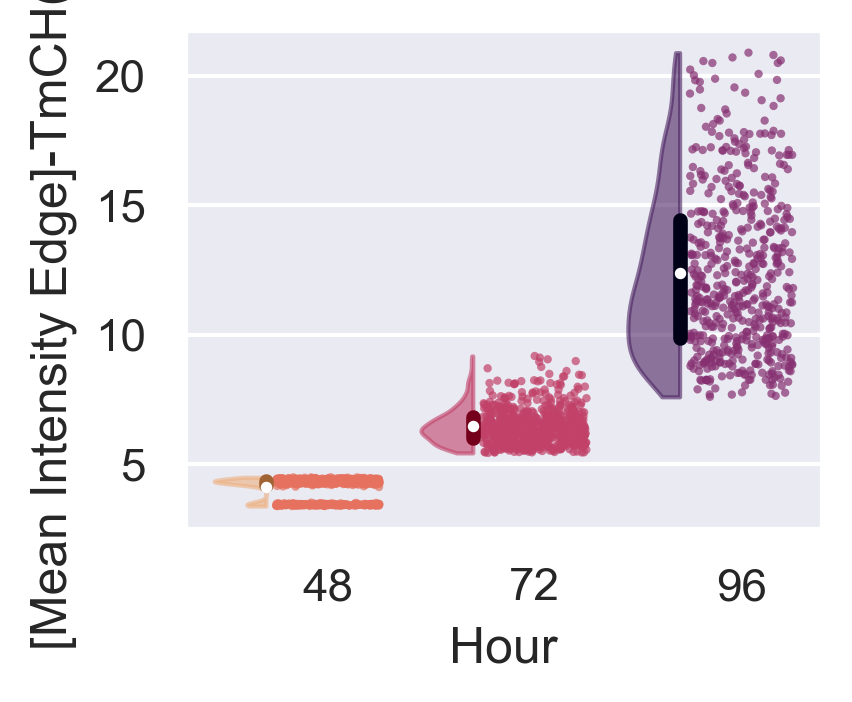

meta NOT subset; don't know how to subset; dropped


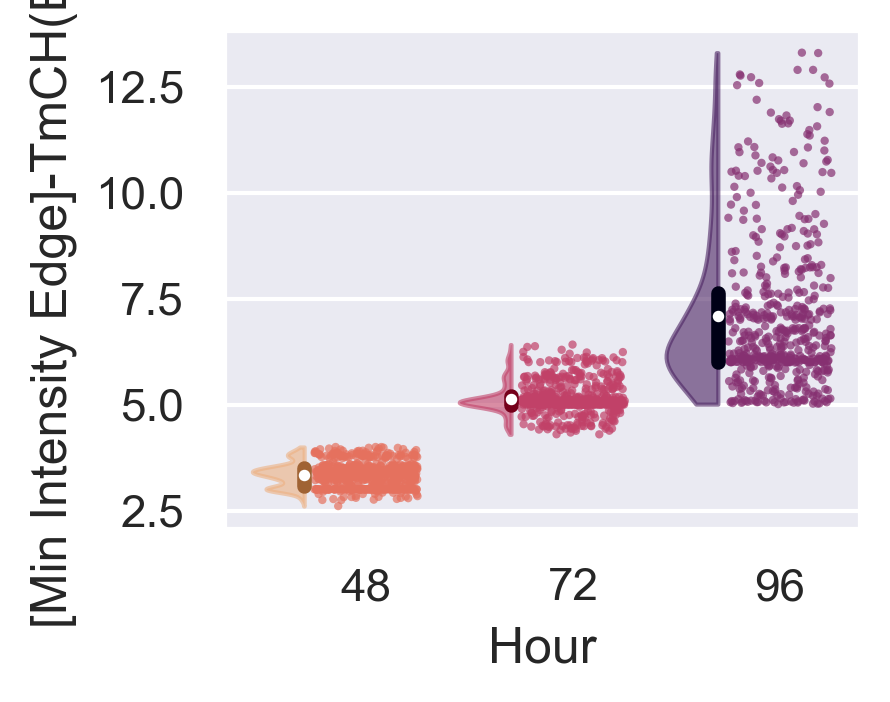

meta NOT subset; don't know how to subset; dropped


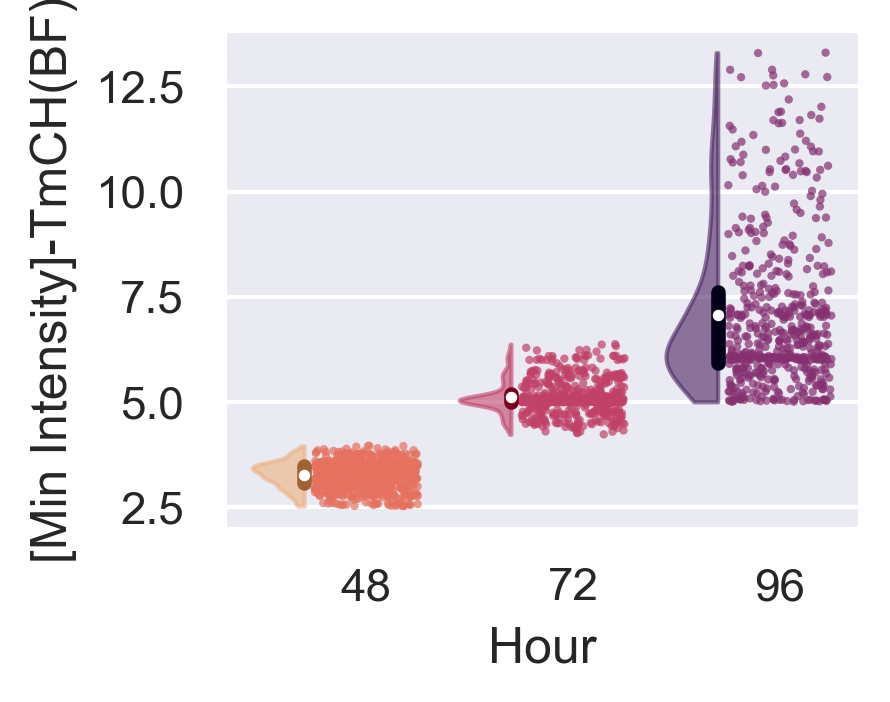

meta NOT subset; don't know how to subset; dropped


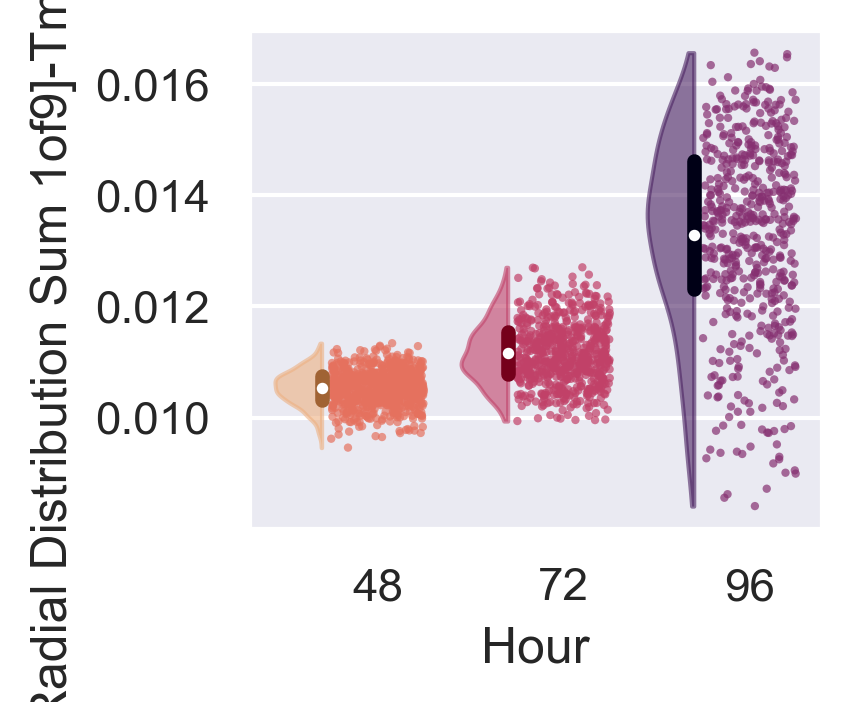

meta NOT subset; don't know how to subset; dropped


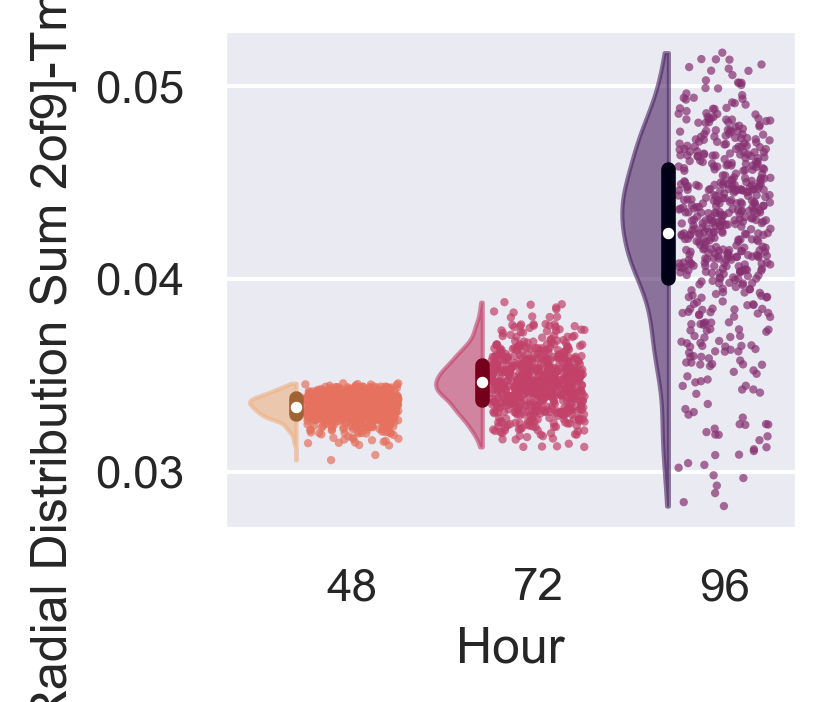

meta NOT subset; don't know how to subset; dropped


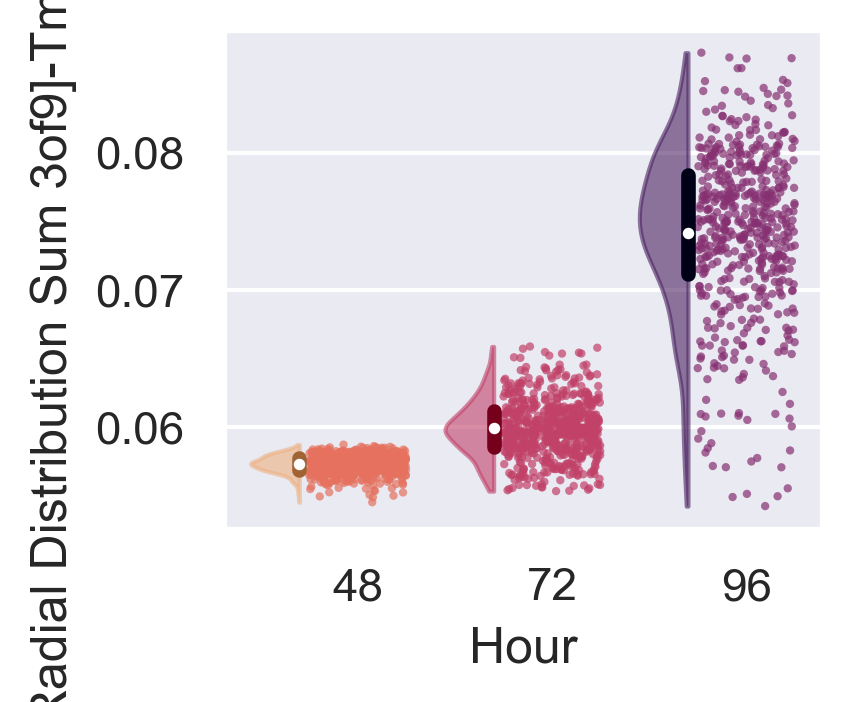

meta NOT subset; don't know how to subset; dropped


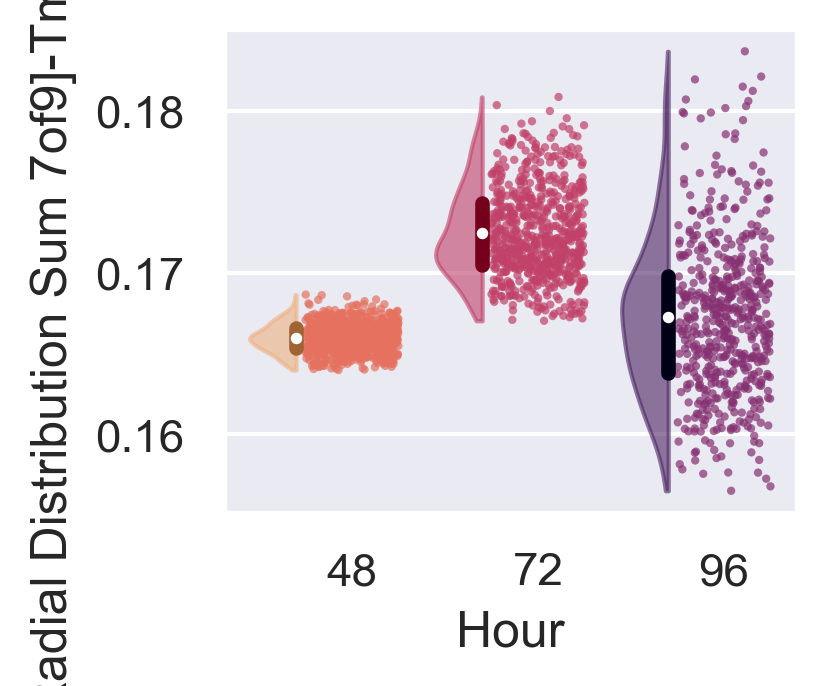

meta NOT subset; don't know how to subset; dropped


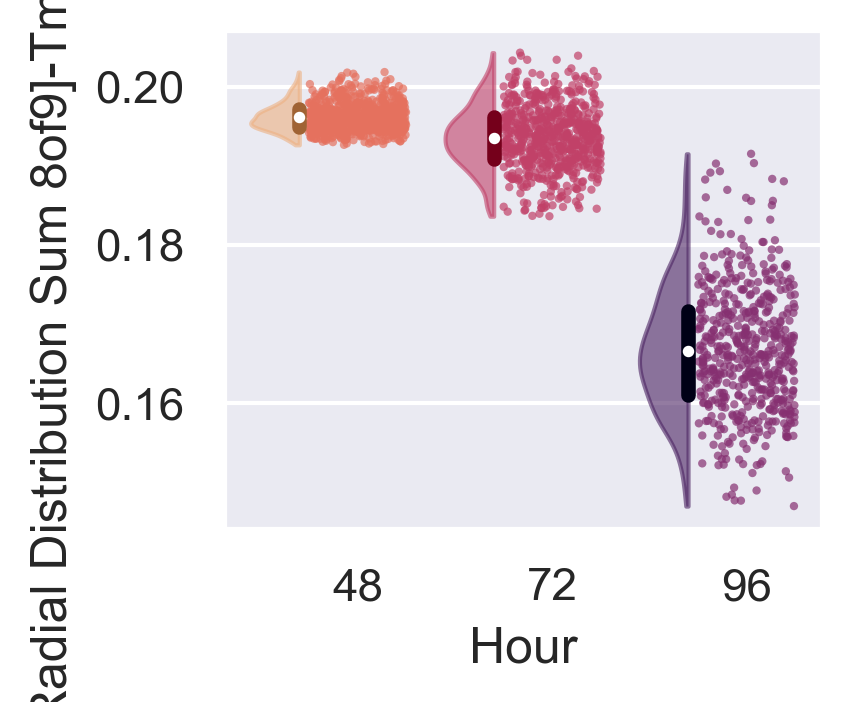

meta NOT subset; don't know how to subset; dropped


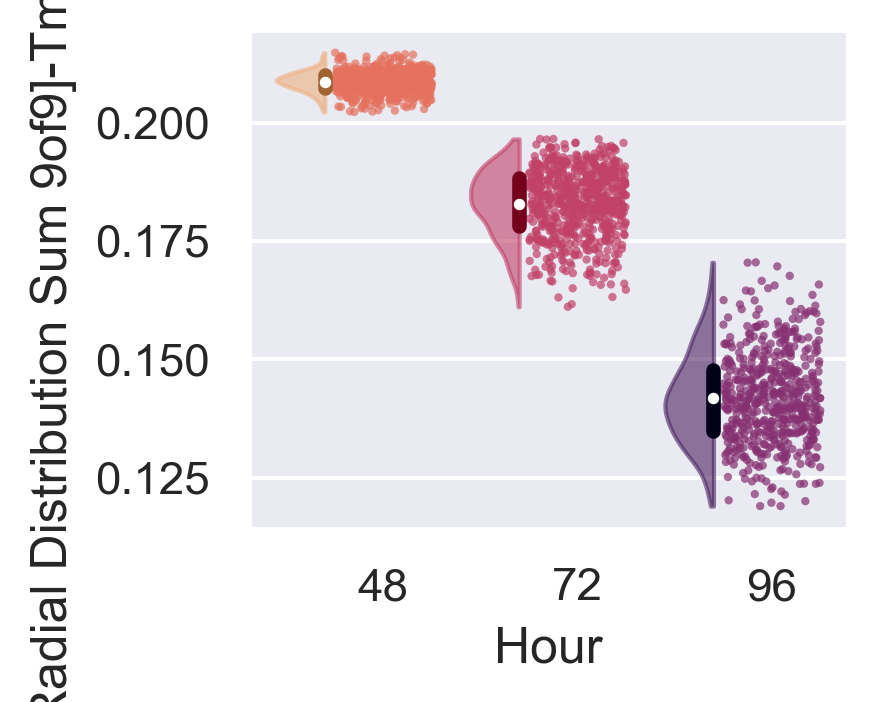

meta NOT subset; don't know how to subset; dropped


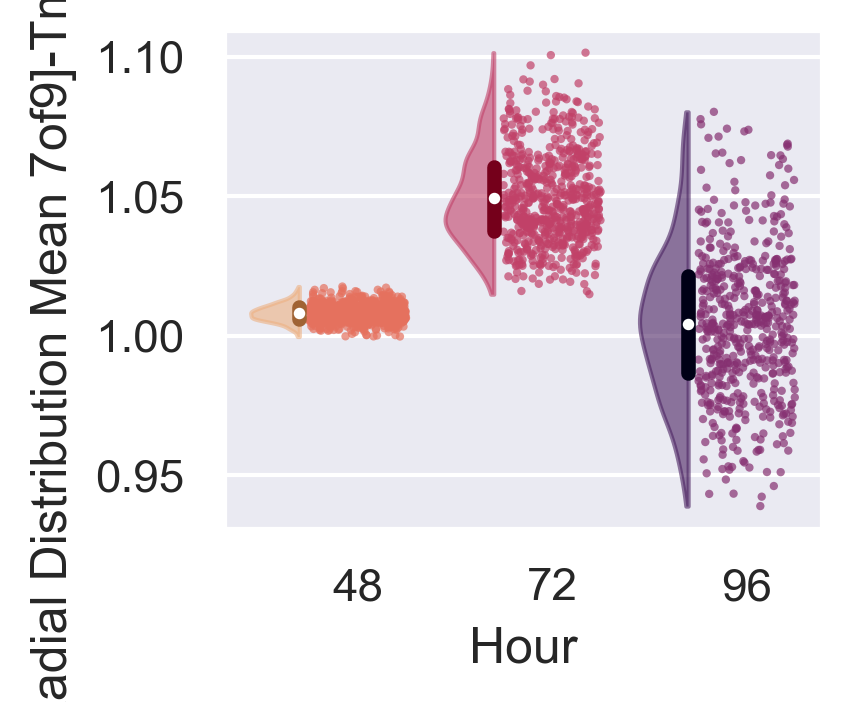

meta NOT subset; don't know how to subset; dropped


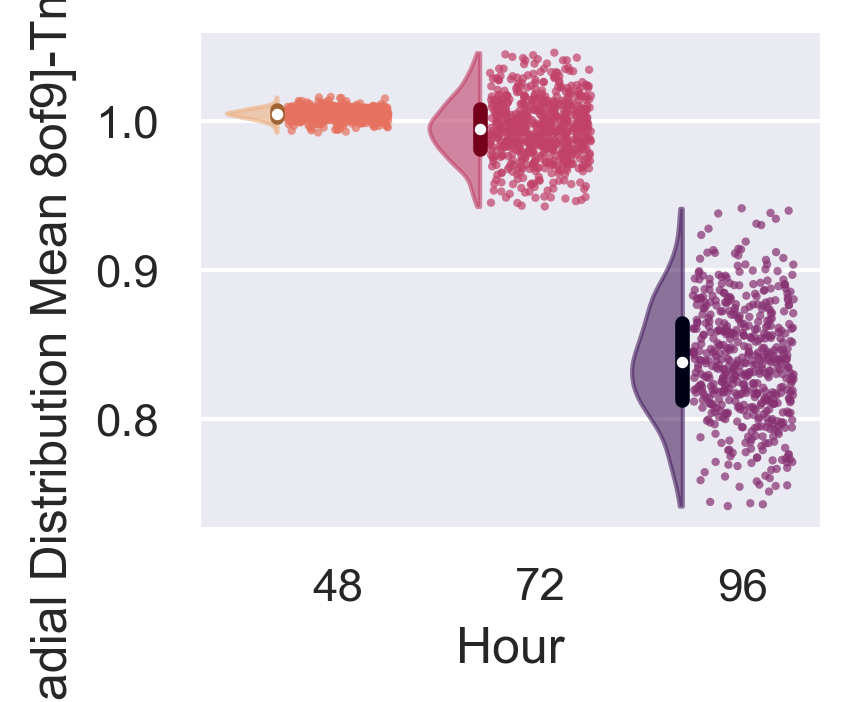

meta NOT subset; don't know how to subset; dropped


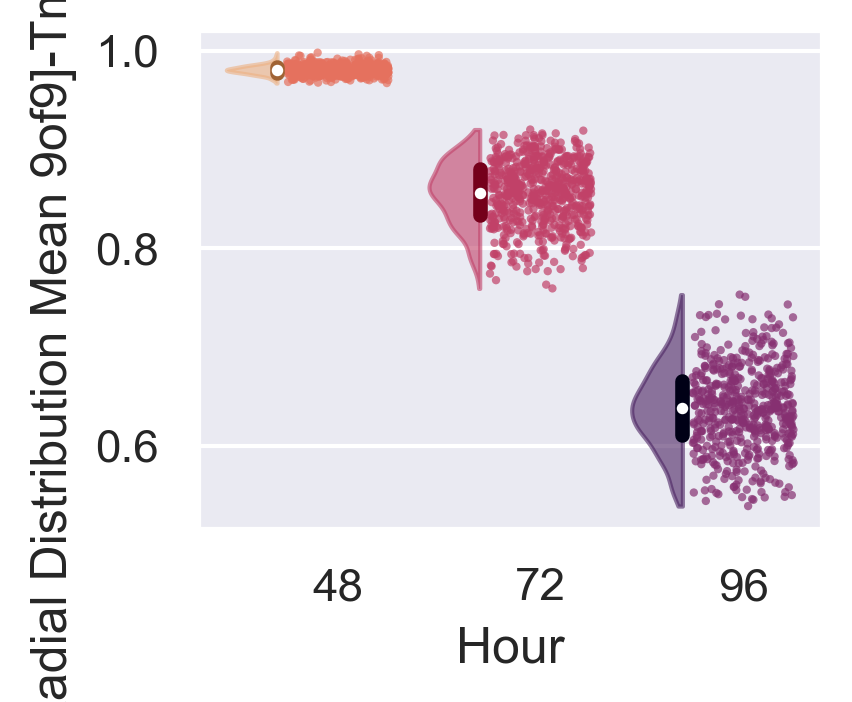

meta NOT subset; don't know how to subset; dropped


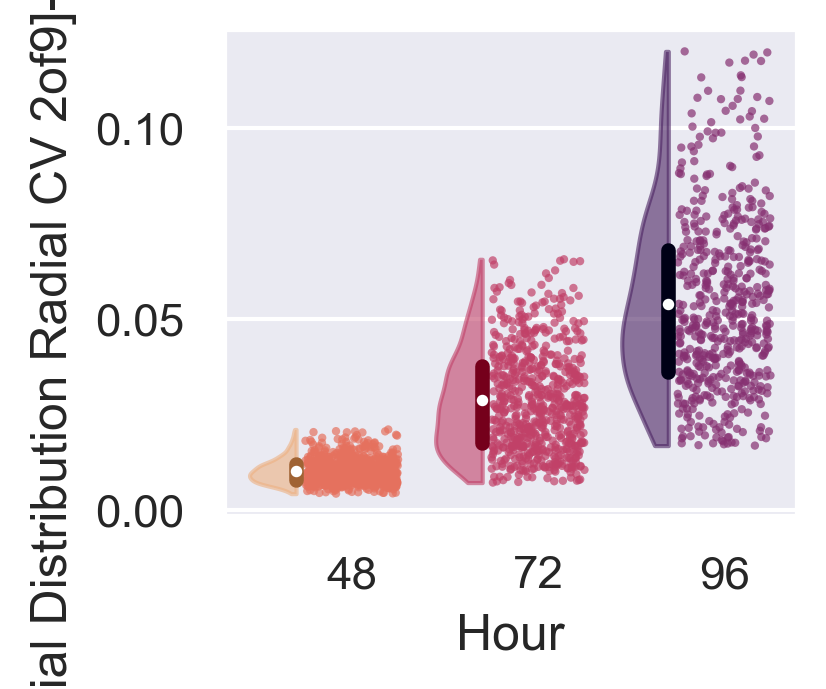

meta NOT subset; don't know how to subset; dropped


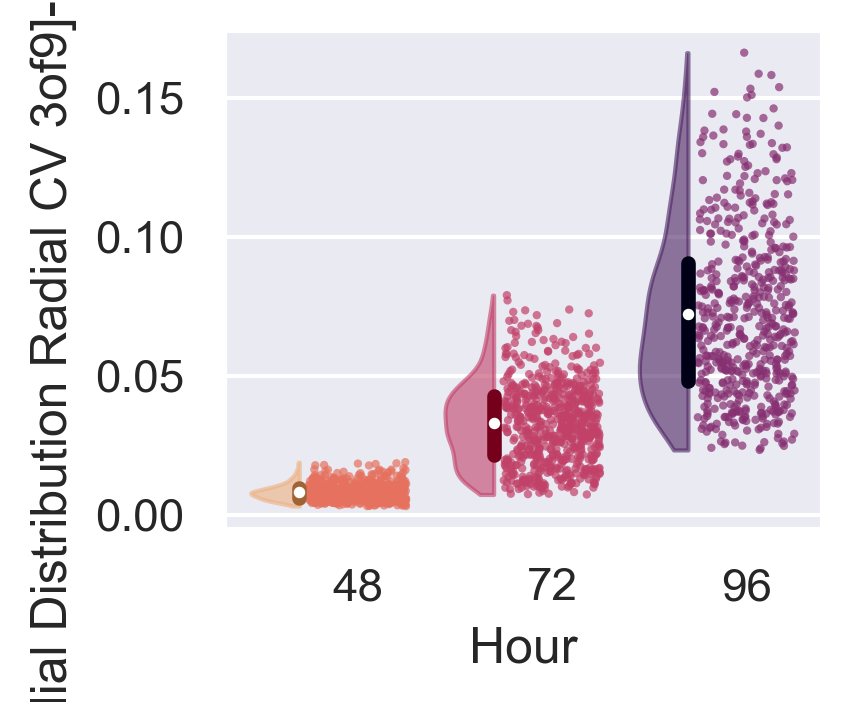

meta NOT subset; don't know how to subset; dropped


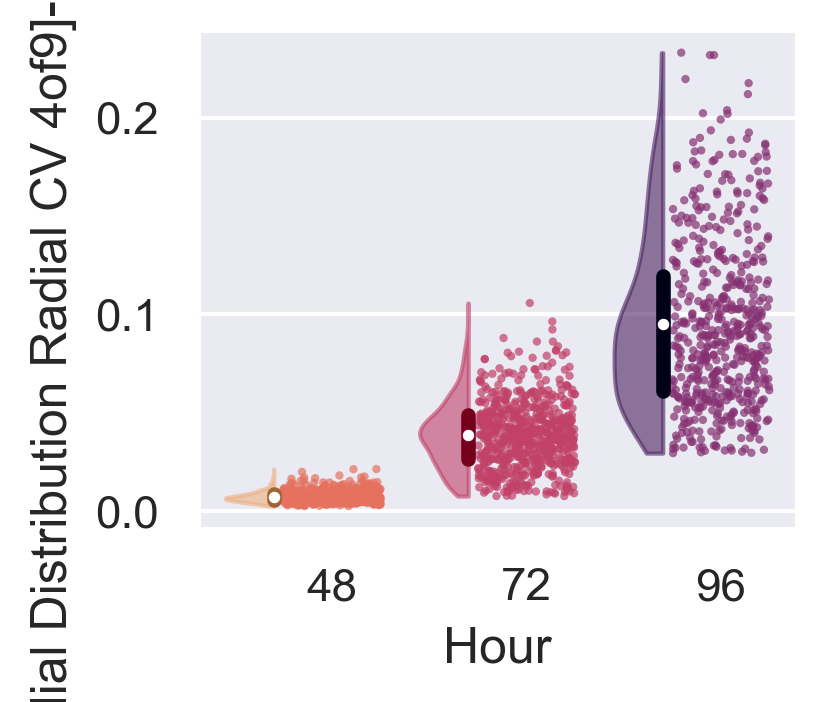

In [64]:
df= stacked_intensity.rename(columns=intensity_name_mapping)
for feature in main_contributers_int:
    feature
    df_filtered = pd.concat([
        filter_outliers_quantile(df[df['Hour']==hour],columns =[feature],quantile=0.01) for hour in hours
    ],axis=0)
    fig, axs = plt.subplots(1, 1,figsize = (3,2.5))
    opp.raincloud_plot(df_filtered,"Hour",feature,ax=axs ,jitter = 0.3,palette = 'flare', quantiles = [0.25,0.75], size_cloud = 2, size_quant = 3.5)
    plt.tight_layout()
    plt.savefig(f"{out_fig_1_supp}/Feature Plots Intensity Main Contributers {feature}.pdf", format="pdf", bbox_inches="tight")
    plt.show()



meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped


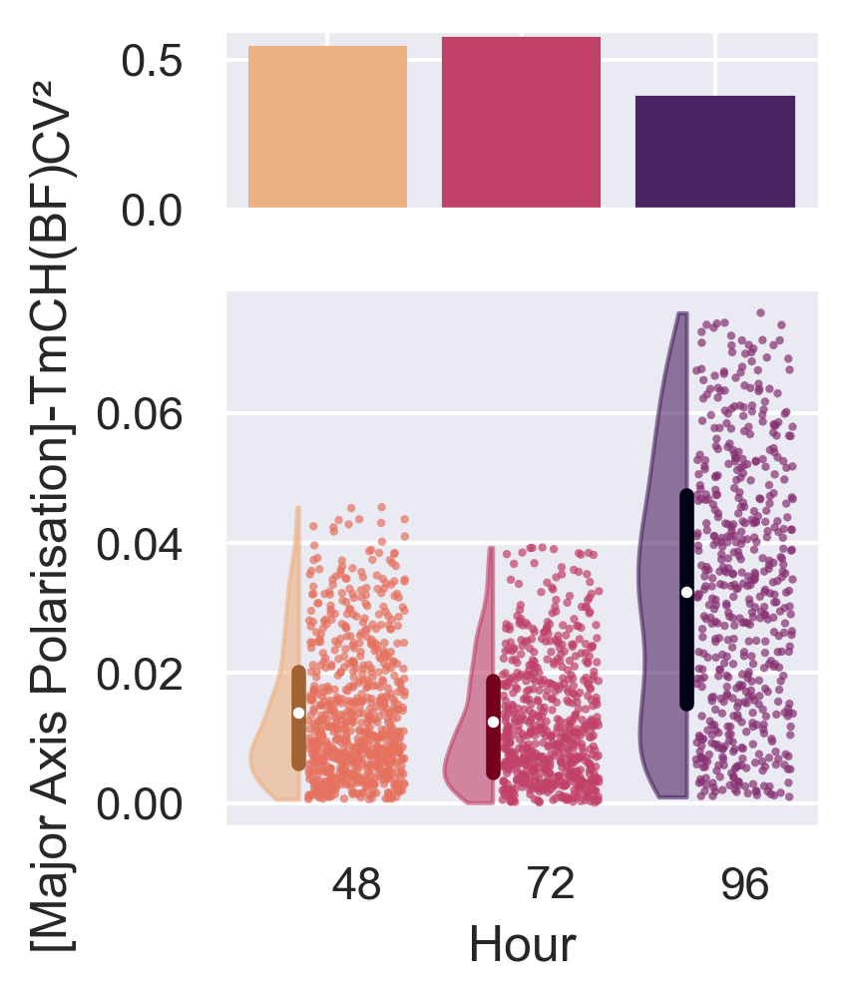

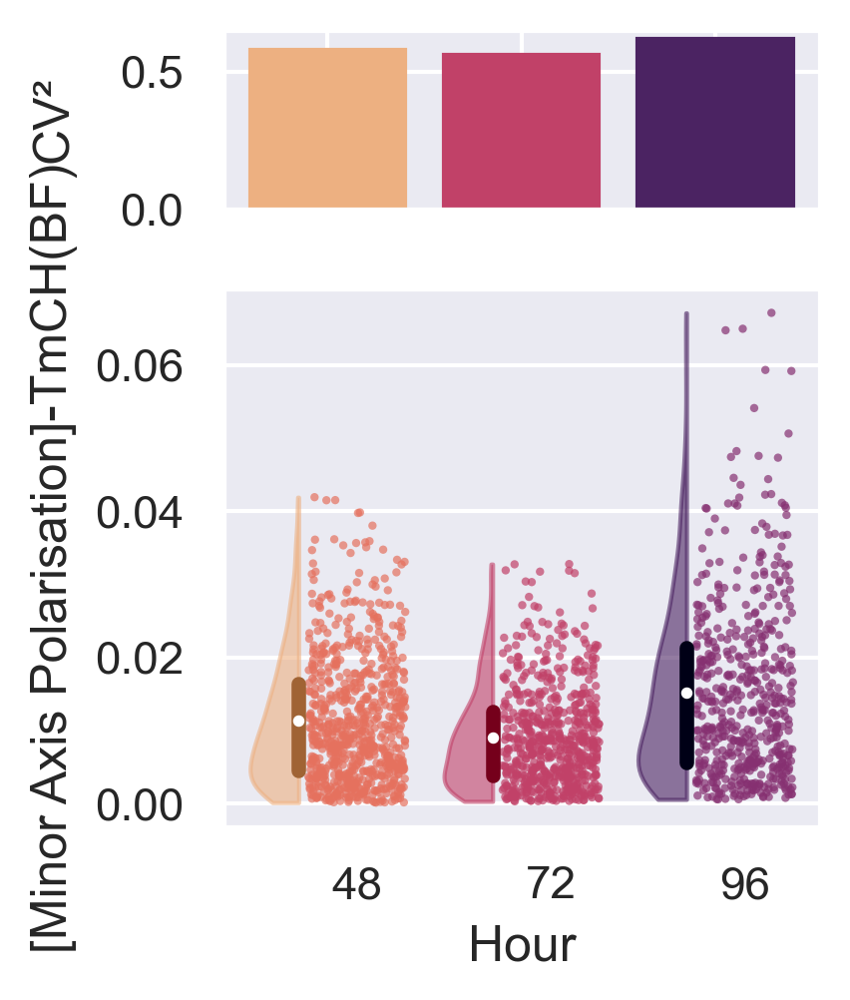

In [65]:
plotting_feats_extra_cv_feats = [
    'str_CH_AreaShape_Bra_MajorAxis_Polarisation',
    'str_CH_AreaShape_Bra_MinorAxis_Polarisation'
]
df = stacked_intensity.rename(columns=intensity_name_mapping)
for feature in plotting_feats_extra_cv_feats:
    feature = intensity_name_mapping[feature]
    df_filtered = pd.concat([
        filter_outliers_quantile(df[df['Hour']==hour],columns =[feature],quantile=0.01) for hour in hours
    ],axis=0)
    
    fig, axs = plt.subplots(2, 1, gridspec_kw={'height_ratios': [1, 3]},figsize = (3,3.5))
    CVs = [(np.std(df_filtered[df_filtered['Hour']==hour][feature])/np.mean(df_filtered[df_filtered['Hour']==hour][feature]))**2 for hour in hours]
    colors = [mpl.colormaps["flare"](float(i)) for i in [0,0.5,1]]
    axs[0].bar([0,1,2],CVs,color=colors,edgecolor=colors)
    axs[0].xaxis.set_tick_params(labelbottom=False)
    axs[0].set_ylabel("CV\u00b2")
    opp.raincloud_plot(df_filtered,"Hour",feature,ax=axs[1] ,jitter = 0.3,palette = 'flare', quantiles = [0.25,0.75], size_cloud = 2, size_quant = 3.5)
    fig.align_labels()
    plt.tight_layout()
    plt.savefig(f"{out_fig_1_supp}/Feature Plots PC_1 {feature}.pdf", format="pdf", bbox_inches="tight")
    plt.show